In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

import torch
import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v7.0-5-gbfa1f23 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 22.6/78.2 GB disk)


In [ ]:
import torch

from IPython.display import Image, clear_output  # to display images
from utils.downloads import attempt_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))


Setup complete. Using torch 1.12.1+cu113 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [ ]:
!pip install -q roboflow

     |████████████████████████████████| 41 kB 297 kB/s 
     |████████████████████████████████| 145 kB 20.8 MB/s 
     |████████████████████████████████| 54 kB 1.5 MB/s 
     |████████████████████████████████| 67 kB 2.6 MB/s 
     |████████████████████████████████| 138 kB 8.3 MB/s 
     |████████████████████████████████| 178 kB 51.0 MB/s 
     |████████████████████████████████| 62 kB 997 kB/s 


In [ ]:
# from roboflow import Roboflow
# rf = Roboflow(api_key="kTldzEleHpjBKQd5BPDZ")
# project = rf.workspace("college-rhnpn").project("fish-species-custom")
# dataset = project.version(3).download("yolov5")

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="kTldzEleHpjBKQd5BPDZ")
project = rf.workspace("college-rhnpn").project("mtp-dataset-w5da1")
dataset = project.version(1).download("yolov5")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to MTP-dataset-1 in yolov5pytorch:: 100%|██████████| 3818/3818 [00:02<00:00, 1775.05it/s]


In [ ]:
%cat {dataset.location}/data.yaml

names:
- Catla
- Common carp
- Mrigal
- Pomfret
- Rohu
- Silver carp
- Tilapia
- Tuna
nc: 8
roboflow:
  license: CC BY 4.0
  project: mtp-dataset-w5da1
  url: https://universe.roboflow.com/project/mtp-dataset-w5da1/dataset/1
  version: 1
  workspace: project
test: ../test/images
train: MTP-dataset-1/train/images
val: MTP-dataset-1/valid/images


In [ ]:
# import yaml
# with open(dataset.location + "/data.yaml", 'r') as stream:
#     num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
!python train.py --img 640 --batch 8 --epochs 70 --data {dataset.location}/data.yaml  --cfg /content/yolov5/models/yolov5s.yaml --weights "" --name main_results  --cache

train: weights=, cfg=/content/yolov5/models/yolov5s.yaml, data=/content/yolov5/MTP-dataset-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=70, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=main_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-5-gbfa1f23 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, ancho

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs





<IPython.core.display.Javascript object>

GROUND TRUTH TRAINING DATA:


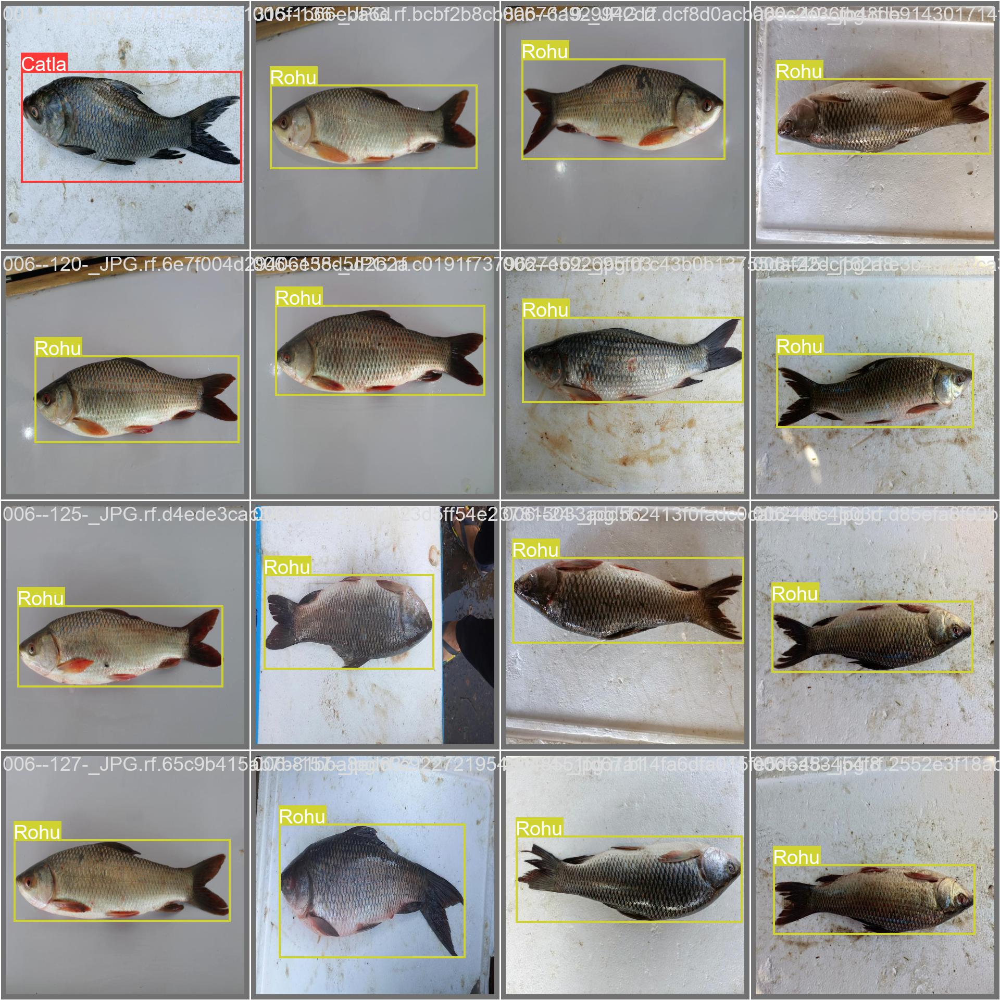

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/main_results/val_batch0_labels.jpg', width=900)

In [ ]:
%ls runs/

train/


In [ ]:
%ls runs/train/main_results/weights

best.pt  last.pt


In [ ]:
!python detect.py --weights runs/train/main_results/weights/best.pt --img 640 --conf 0.4 --source /content/yolov5/MTP-dataset-1/test/images

detect: weights=['runs/train/main_results/weights/best.pt'], source=/content/yolov5/MTP-dataset-1/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-5-gbfa1f23 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7031701 parameters, 0 gradients, 15.8 GFLOPs
image 1/91 /content/yolov5/MTP-dataset-1/test/images/001--107-_JPG.rf.4cfddef3520eab1206949c58ca214f4c.jpg: 640x640 1 Catla, 12.7ms
image 2/91 /content/yolov5/MTP-dataset-1/test/images/001--11-_jpg.rf.24e5e5bd1e7457f1615dc7e7208c9e0e.jpg: 640x640 1 Catla, 12.7ms
image 3/91 /content/yolov5/MTP-dataset-1/test/images/

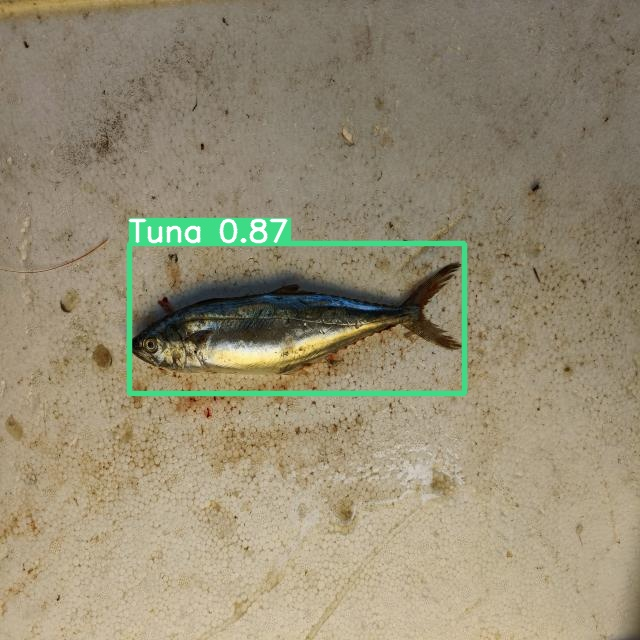

/content/yolov5/runs/detect/exp2/009--73-_jpg.rf.90eaf089424510108f7ebd1a190ef77d.jpg 

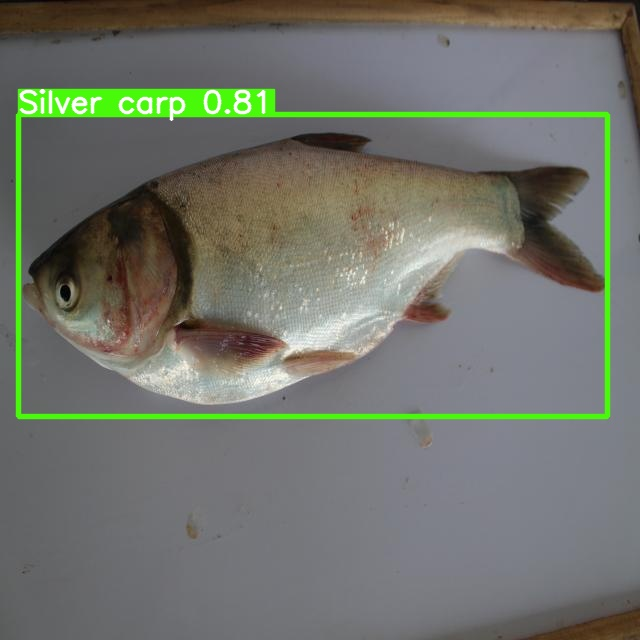

/content/yolov5/runs/detect/exp2/007--28-_JPG.rf.7264fcedecc75a224c10ba70b07e3bc0.jpg 

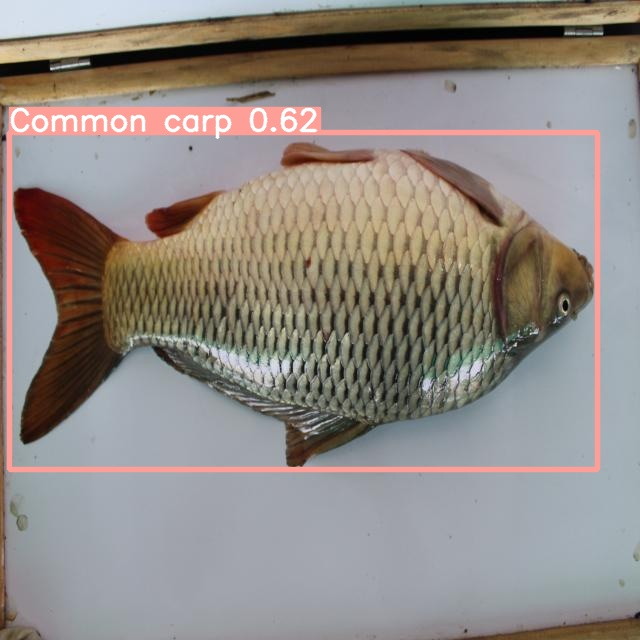

/content/yolov5/runs/detect/exp2/002--4-_JPG.rf.6e5888117c3d65695037b141934ab22d.jpg 

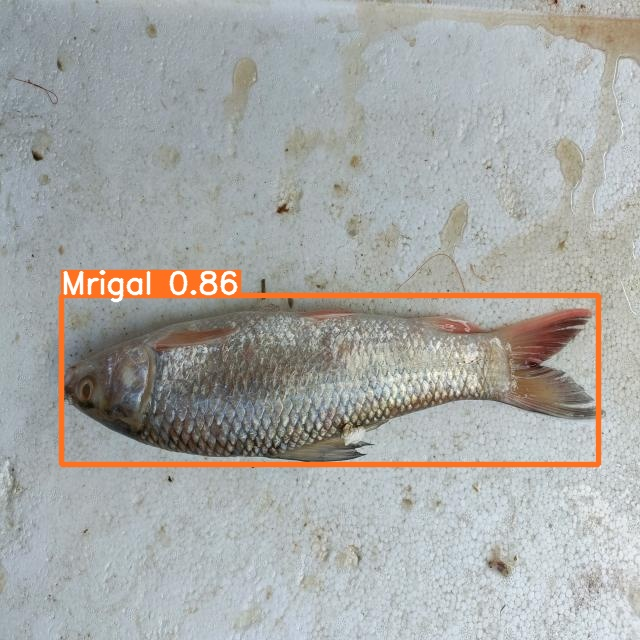

/content/yolov5/runs/detect/exp2/004--30-_jpg.rf.f7597a8972c04b767e78db1a97c84b21.jpg 



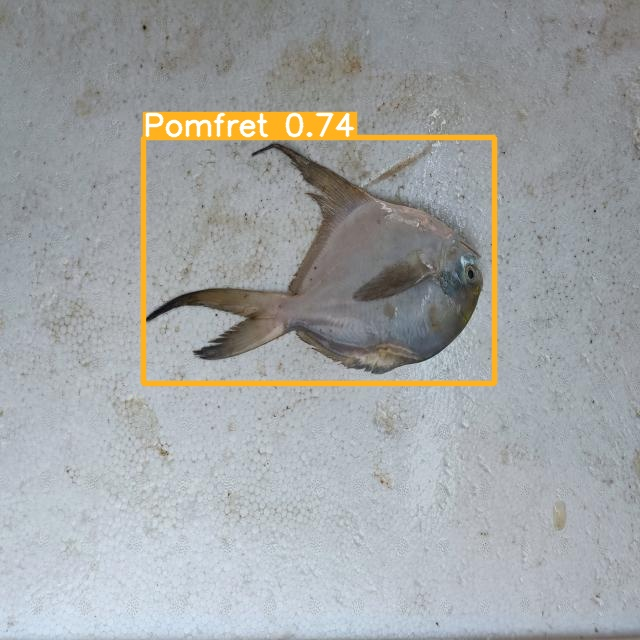

/content/yolov5/runs/detect/exp2/005--20-_jpg.rf.508e2aa1403705b43ba4ec392382f616.jpg 

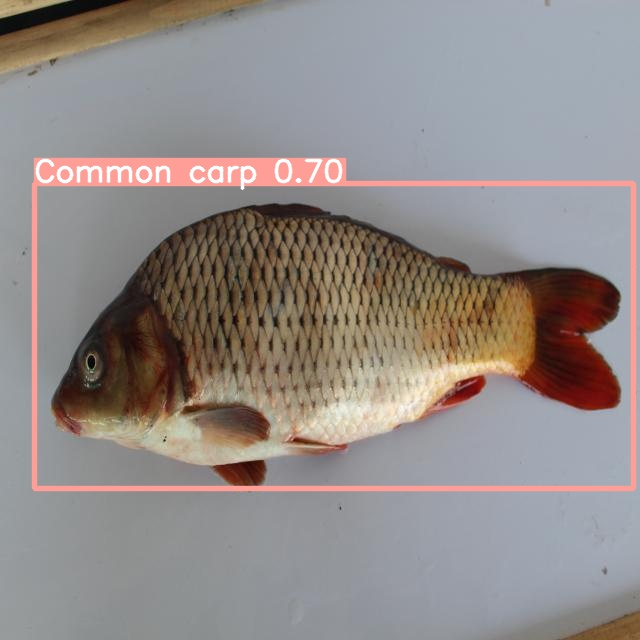

/content/yolov5/runs/detect/exp2/002--46-_JPG.rf.f03cd919977295a660e86bc8ce737b34.jpg 

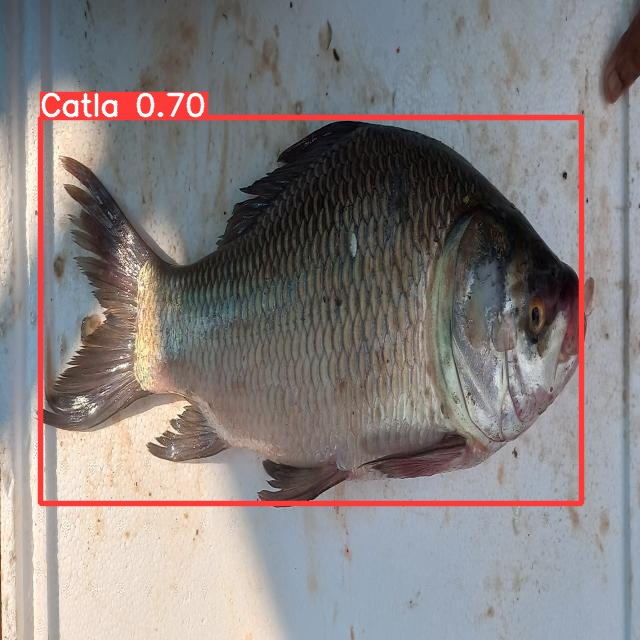

/content/yolov5/runs/detect/exp2/001--68-_jpg.rf.12216784b9dd62cee90e48e60eb68e8c.jpg 

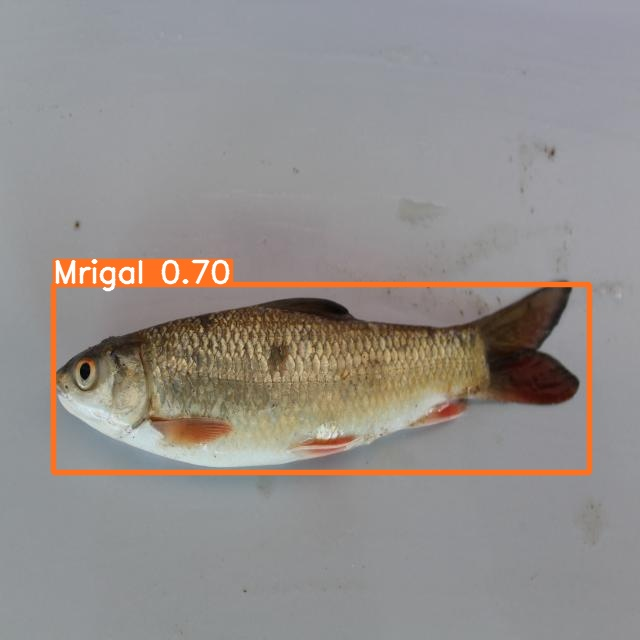

/content/yolov5/runs/detect/exp2/004--77-_JPG.rf.3ad3038f1d288cc804e229d1b3cb74c7.jpg 



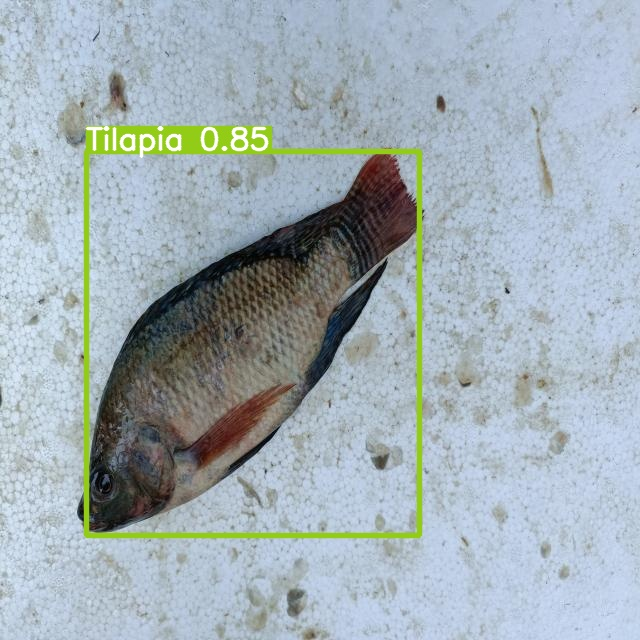

/content/yolov5/runs/detect/exp2/008--34-_jpg.rf.031125e94fc92cb1bcc328654da9b886.jpg 

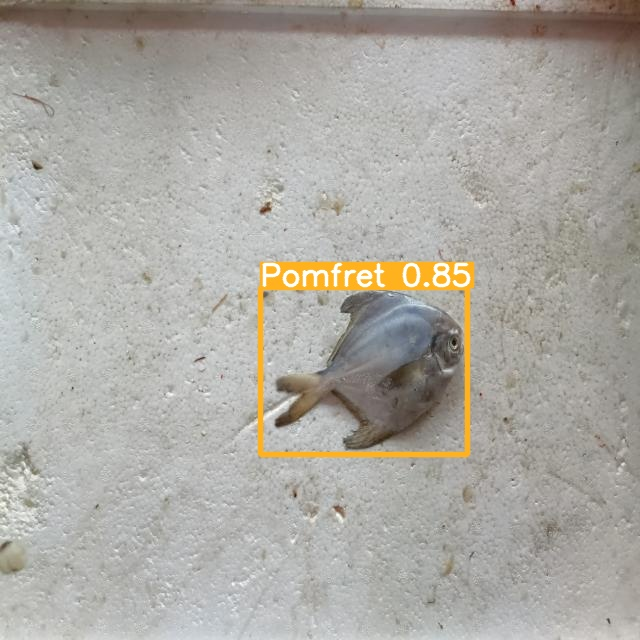

/content/yolov5/runs/detect/exp2/005--144-_jpg.rf.9b52fdf3873849e75f0cbac21c56ef3c.jpg 

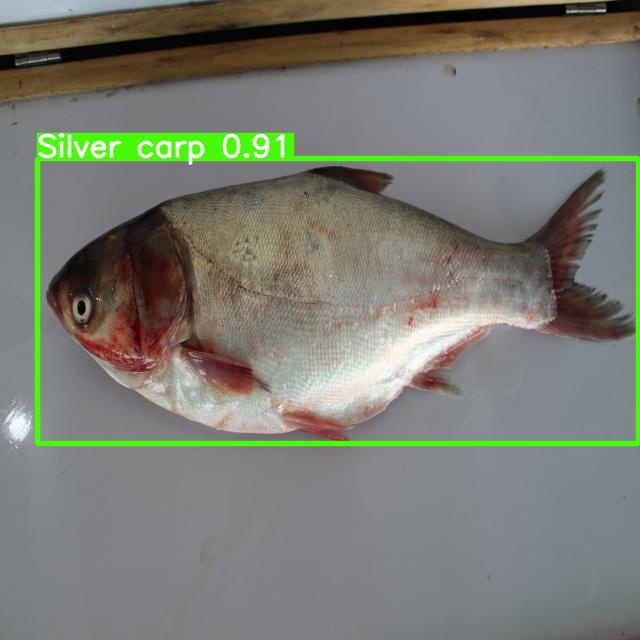

/content/yolov5/runs/detect/exp2/007--22-_JPG.rf.9d4cec54de15eabe73b3aacc8b46c445.jpg 

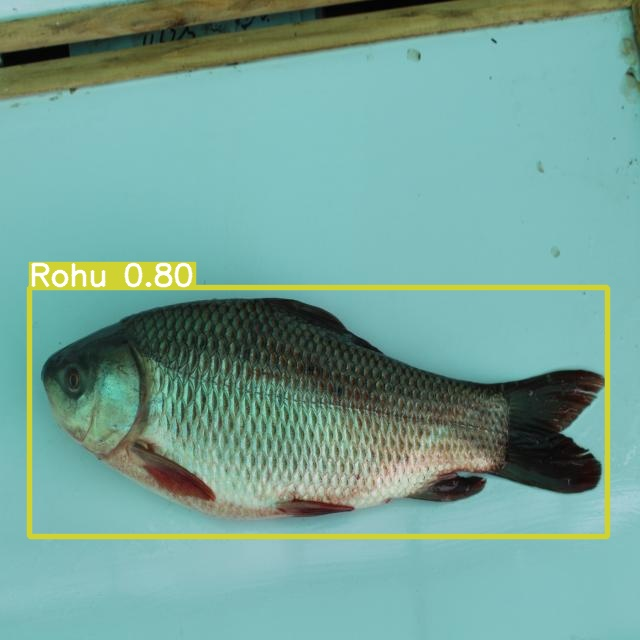

/content/yolov5/runs/detect/exp2/006--140-_JPG.rf.fd49b8a47ddcc651053b8e4427621a06.jpg 



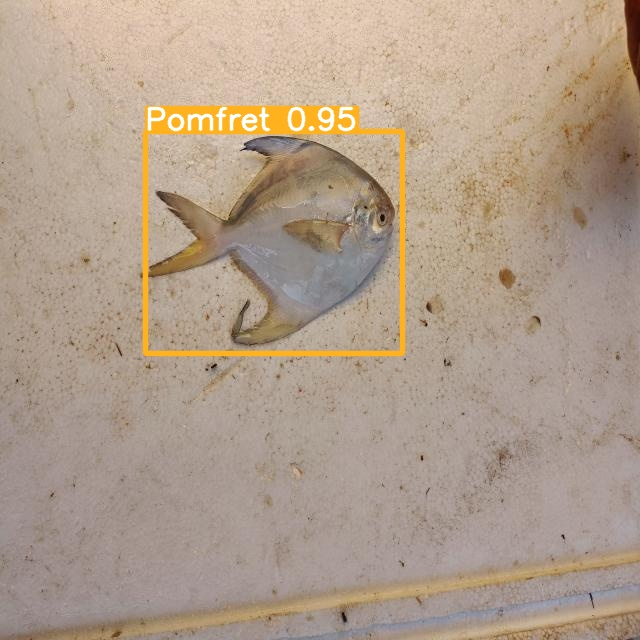

/content/yolov5/runs/detect/exp2/005--64-_jpg.rf.076238d2265459ba0498c6010150919e.jpg 

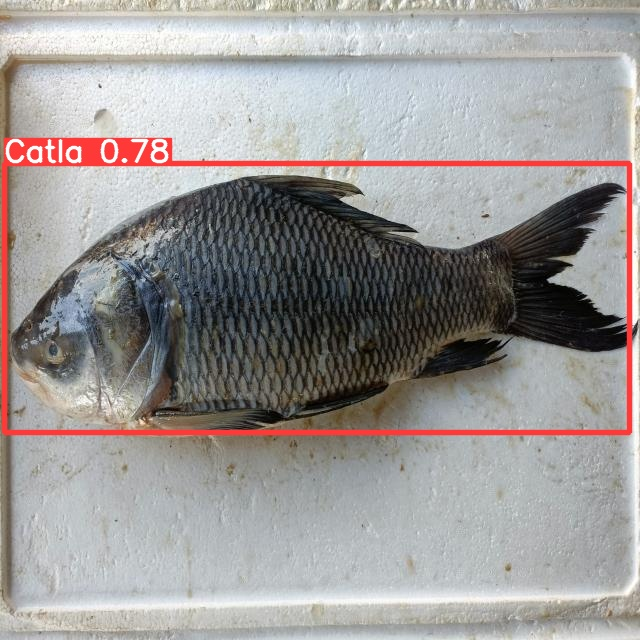

/content/yolov5/runs/detect/exp2/001--167-_jpg.rf.12f49404da2d01b8834afa6016ed82c2.jpg 

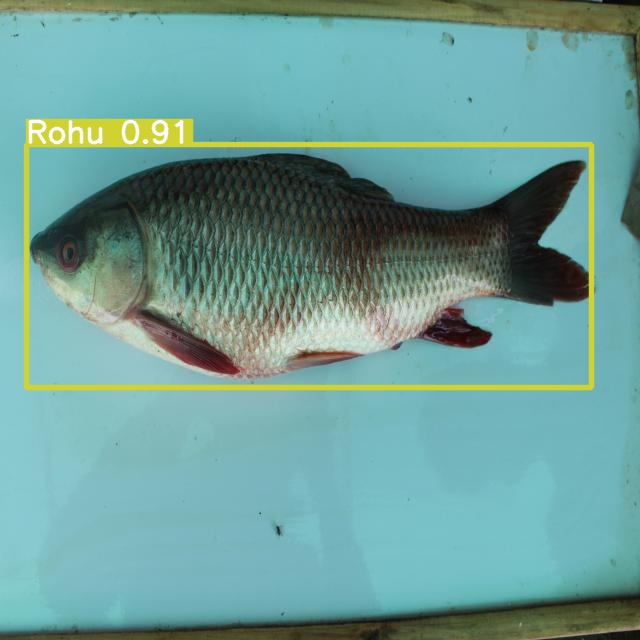

/content/yolov5/runs/detect/exp2/006--146-_JPG.rf.91d29e6ed3bd66f5e55eeb2f64294e2c.jpg 

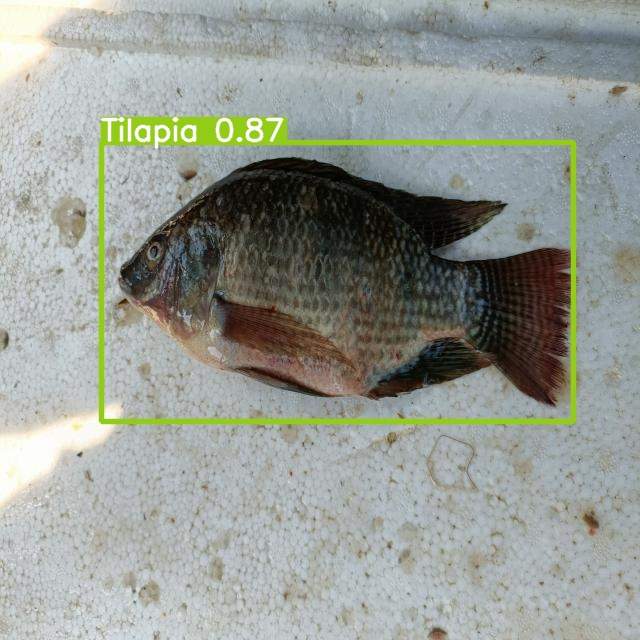

/content/yolov5/runs/detect/exp2/008--128-_jpg.rf.e4869e68dd0fb6be1f53017f4c489f50.jpg 



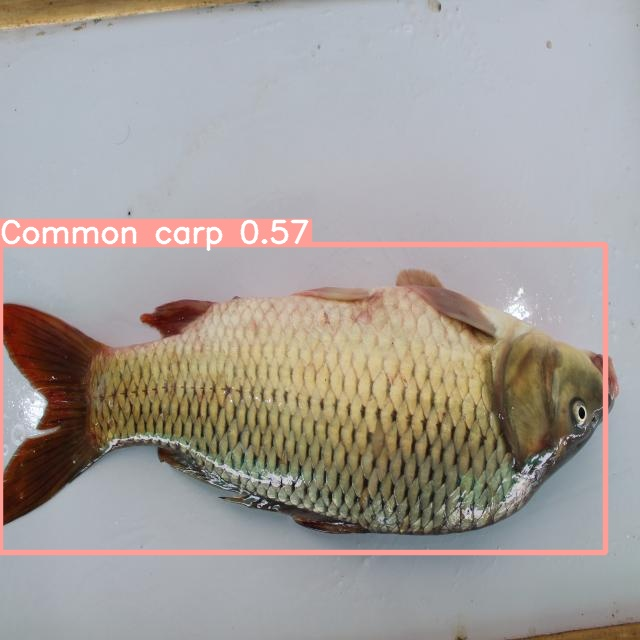

/content/yolov5/runs/detect/exp2/002--9-_JPG.rf.75e94b5785f4c5361afc2da431b7c349.jpg 

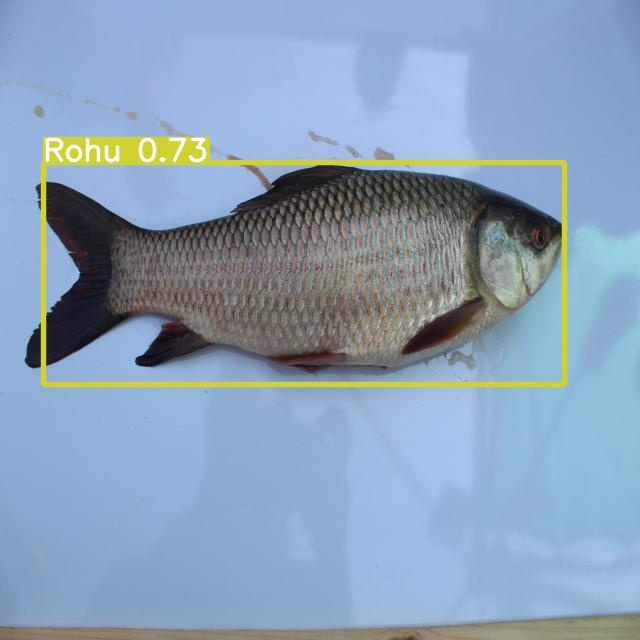

/content/yolov5/runs/detect/exp2/006--81-_JPG.rf.64d497db538984bce05012dea8a5855a.jpg 

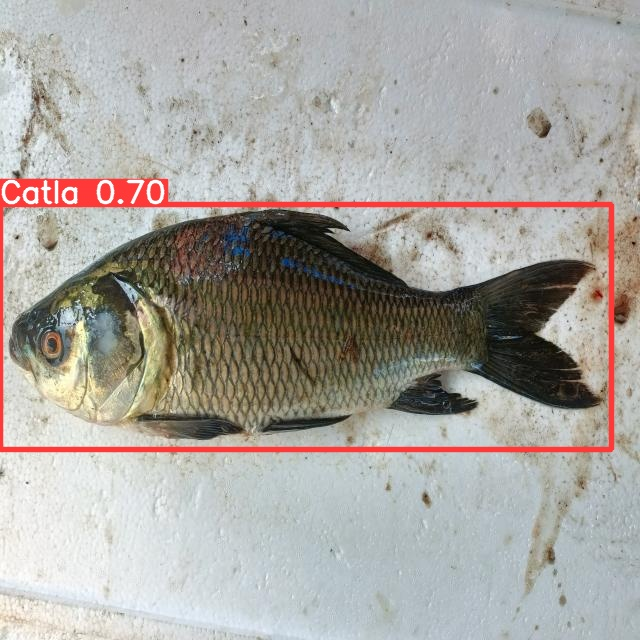

/content/yolov5/runs/detect/exp2/001--174-_jpg.rf.5ab2894fe95de0470bea86dbb682071a.jpg 

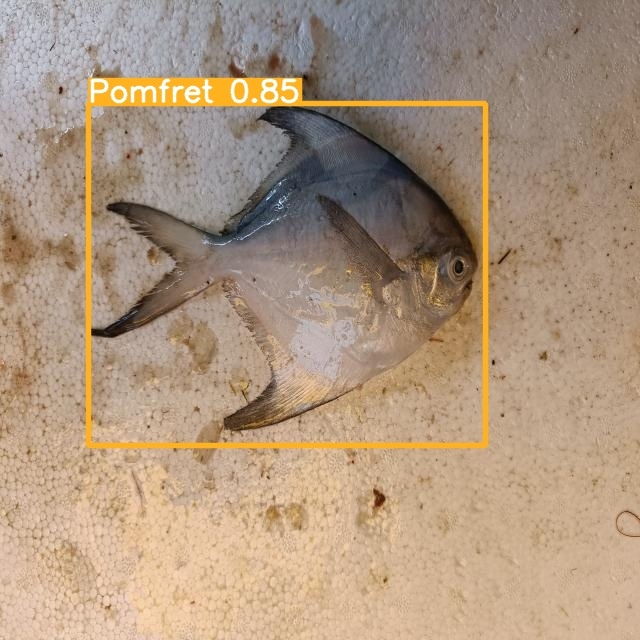

/content/yolov5/runs/detect/exp2/005--109-_jpg.rf.96432053fe79b9c2cbbc490d3d2f1bb1.jpg 



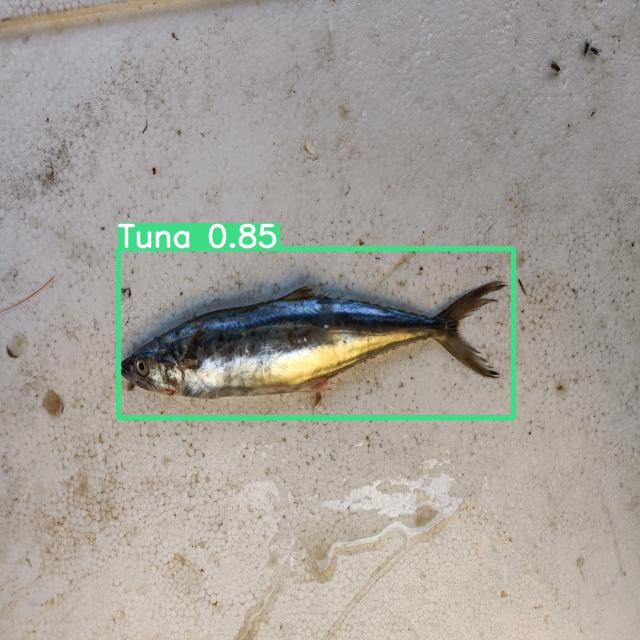

/content/yolov5/runs/detect/exp2/009--56-_jpg.rf.1b92ea96239bf8d2e85571fef235e46d.jpg 

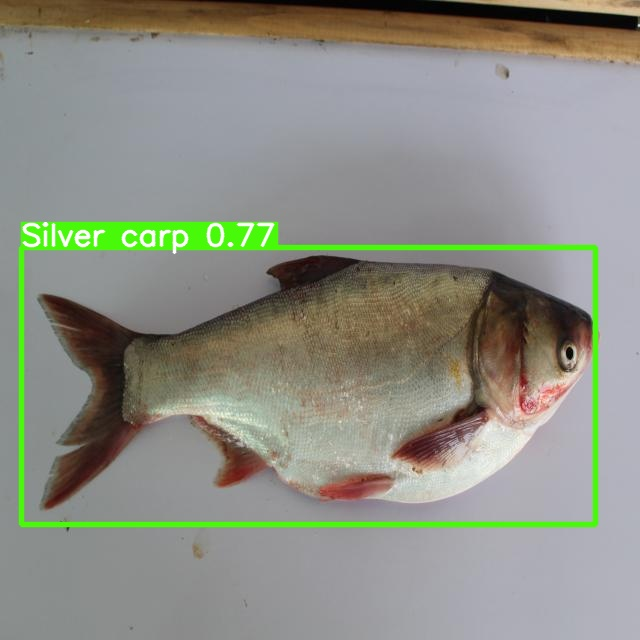

/content/yolov5/runs/detect/exp2/007--46-_JPG.rf.71dcd7c20691e474ec064429db83f298.jpg 

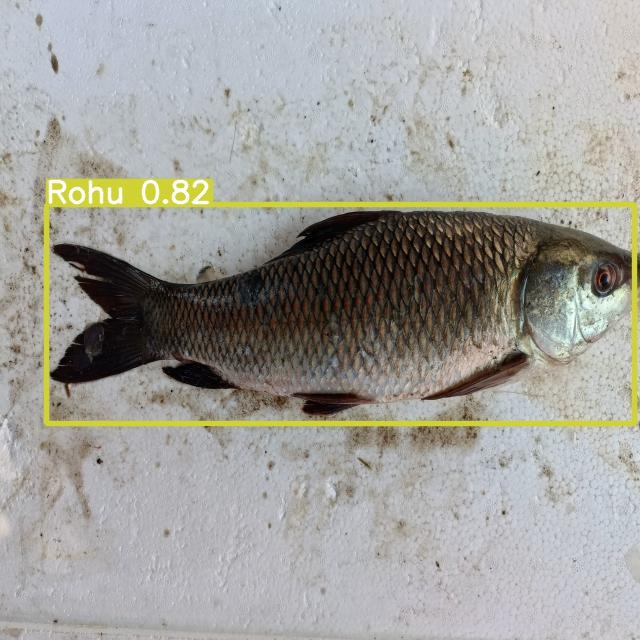

/content/yolov5/runs/detect/exp2/006--76-_jpg.rf.9b3e495c342d6a7ea7a8c8358b71b593.jpg 

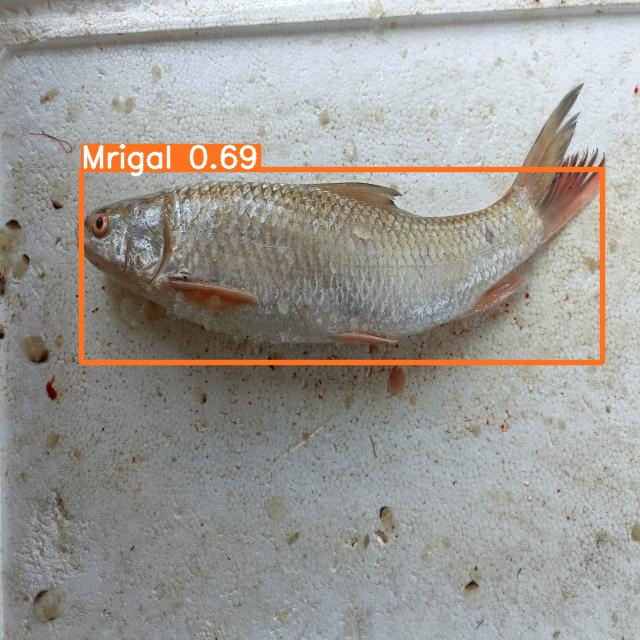

/content/yolov5/runs/detect/exp2/004--61-_jpg.rf.41ee52d16ec2ceca518bac39ad706da4.jpg 



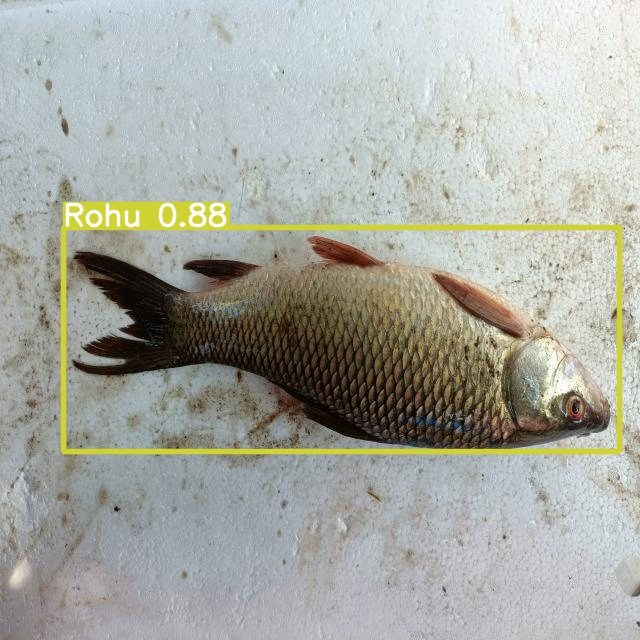

/content/yolov5/runs/detect/exp2/006--73-_jpg.rf.442b1c9301c029525f148c28ef8290fa.jpg 

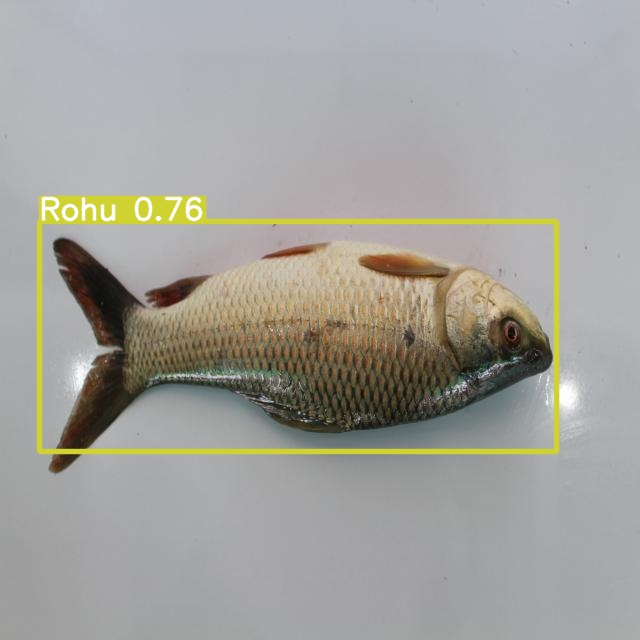

/content/yolov5/runs/detect/exp2/006--110-_JPG.rf.1aa99d2d32ff4954bfc21ed605ea5058.jpg 

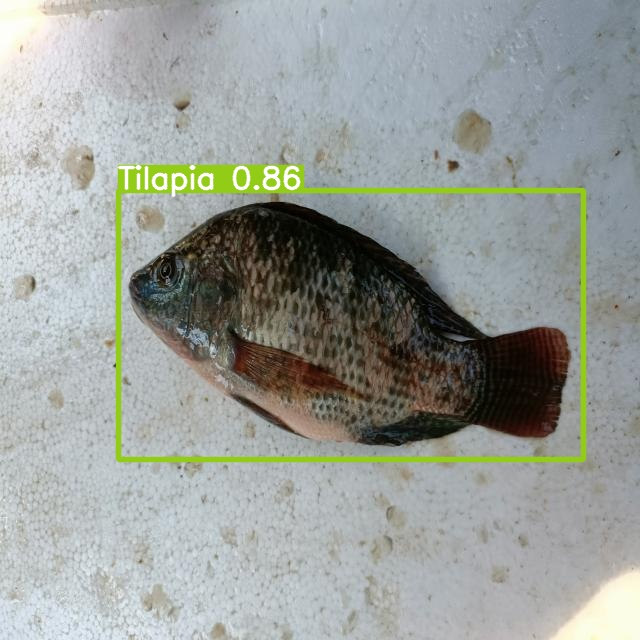

/content/yolov5/runs/detect/exp2/008--100-_jpg.rf.d37ecc84a90c9b7b0e2afada6ea555a7.jpg 

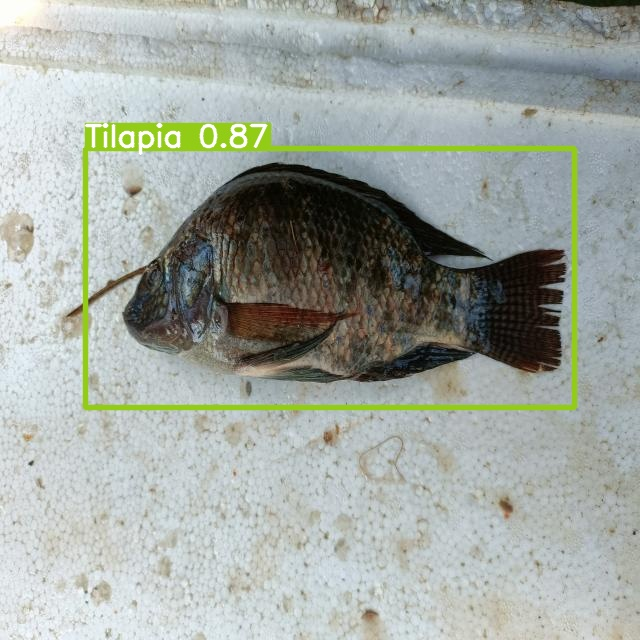

/content/yolov5/runs/detect/exp2/008--124-_jpg.rf.2e10deba4ac47c599ef62a423967a0b4.jpg 



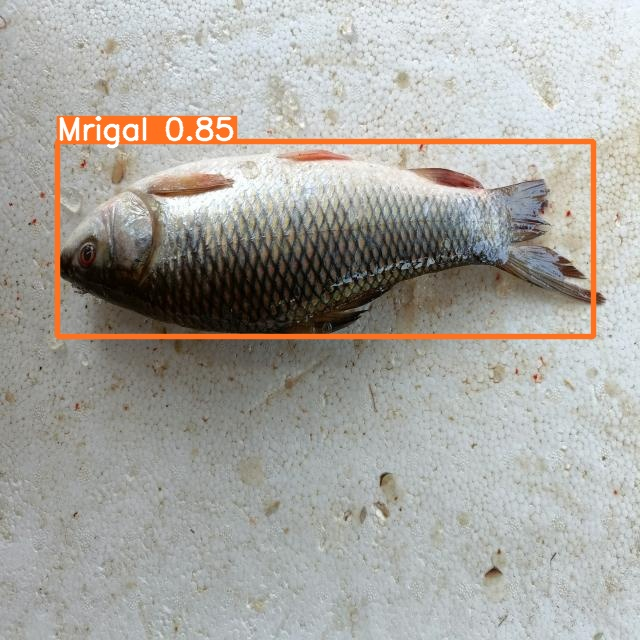

/content/yolov5/runs/detect/exp2/004--66-_jpg.rf.3dedba76e9302fa24ea06c1af94424af.jpg 

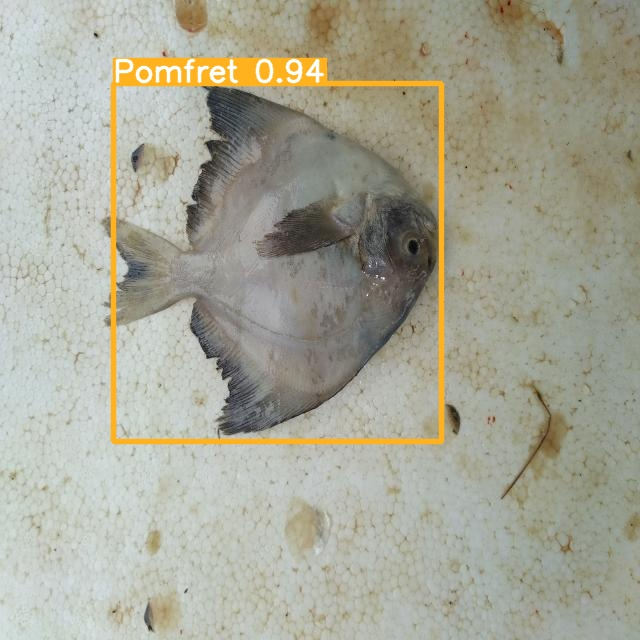

/content/yolov5/runs/detect/exp2/IMG_20220909_102033_jpg.rf.e9f1ef47429199ecd839eb3803df1bf5.jpg 

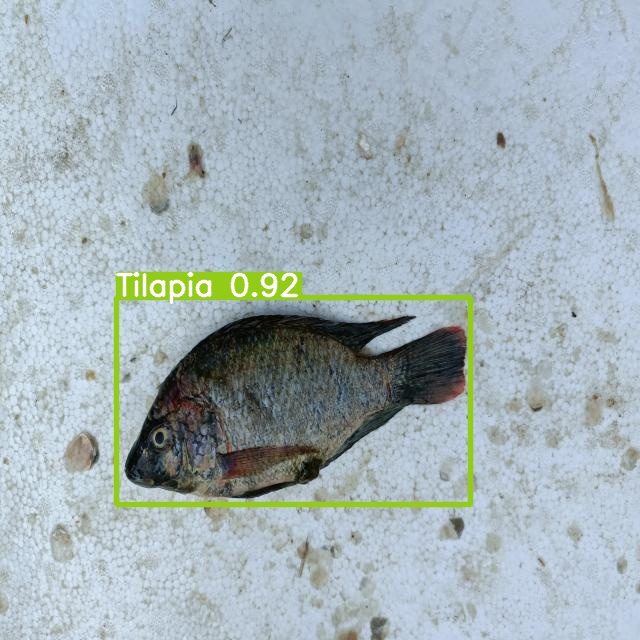

/content/yolov5/runs/detect/exp2/008--20-_jpg.rf.a0048d94ef4d4bd2aae54521b192e2b5.jpg 

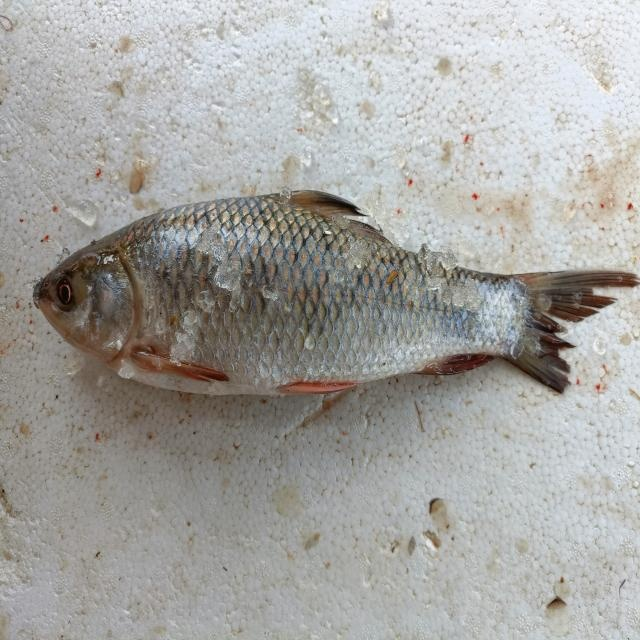

/content/yolov5/runs/detect/exp2/004--65-_jpg.rf.0e5b930642eaf5901bfa1950569891c1.jpg 



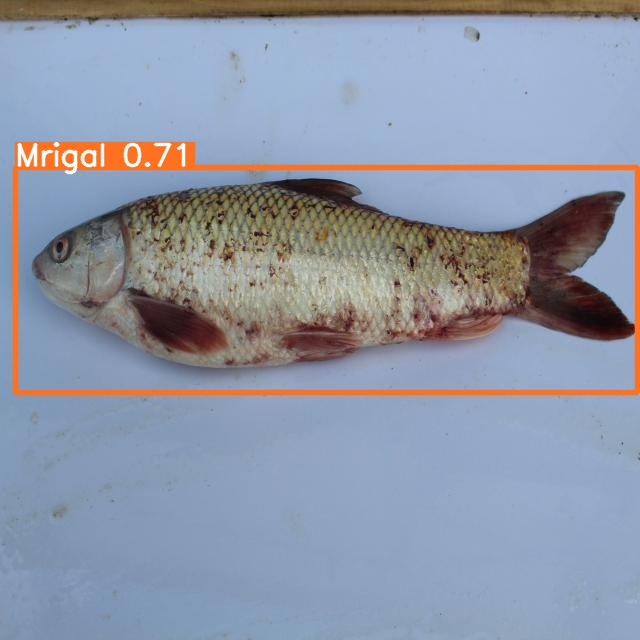

/content/yolov5/runs/detect/exp2/004--9-_JPG.rf.62aa7d0027fe688f0e8d908e01e369e9.jpg 

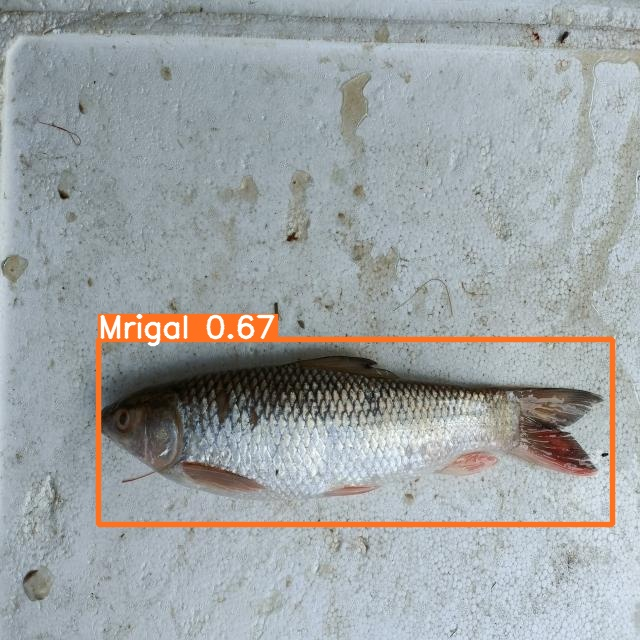

/content/yolov5/runs/detect/exp2/004--25-_jpg.rf.1267942010da7747bc351a3c35f275b0.jpg 

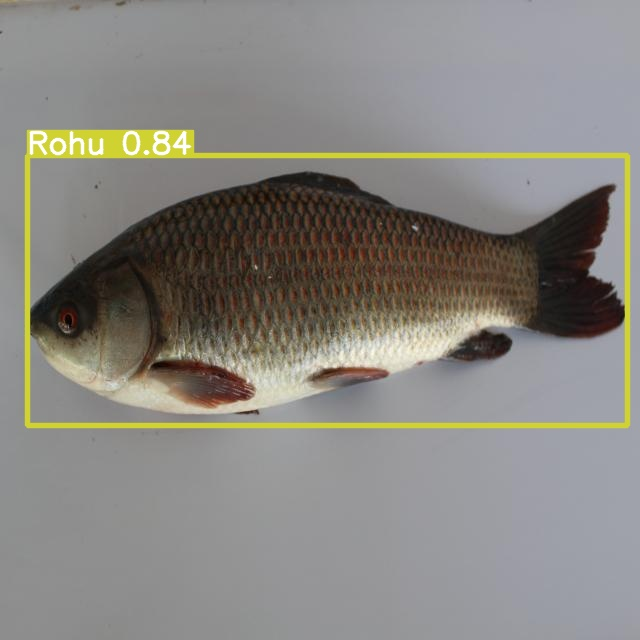

/content/yolov5/runs/detect/exp2/006--104-_JPG.rf.4033fb3608e085ae0de3bc05772850ae.jpg 

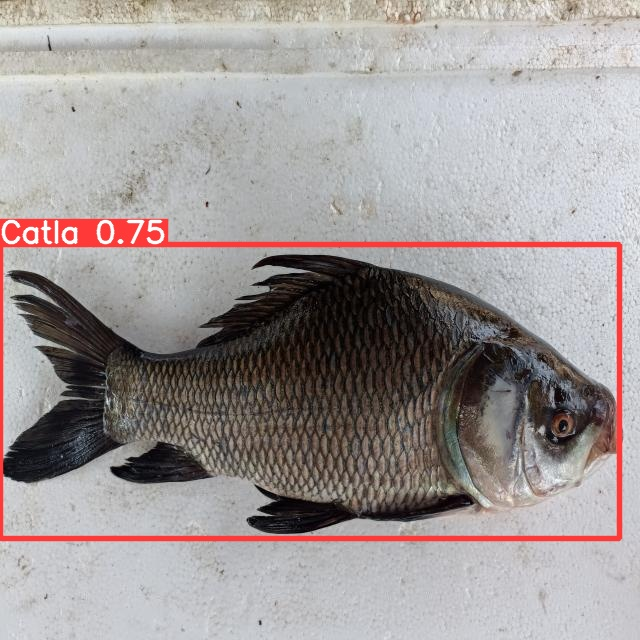

/content/yolov5/runs/detect/exp2/001--184-_jpg.rf.0fc630eee4774b808f97b3a3d8e351ba.jpg 



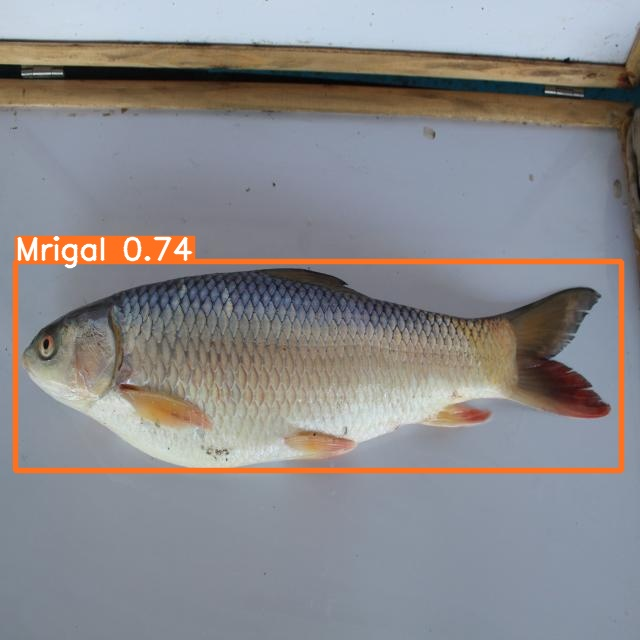

/content/yolov5/runs/detect/exp2/004--87-_JPG.rf.ca1b291cfcb78c9d9dbb790c2eeccdfd.jpg 

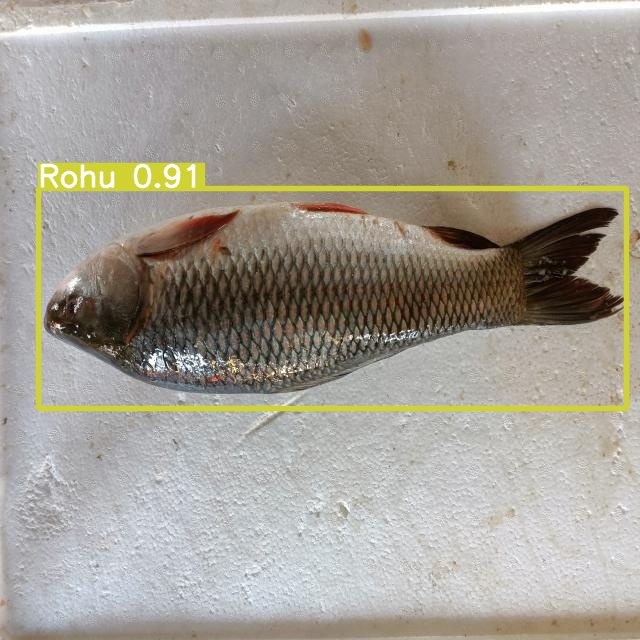

/content/yolov5/runs/detect/exp2/006--18-_jpg.rf.a8194e460611825eb99ac77adc331535.jpg 

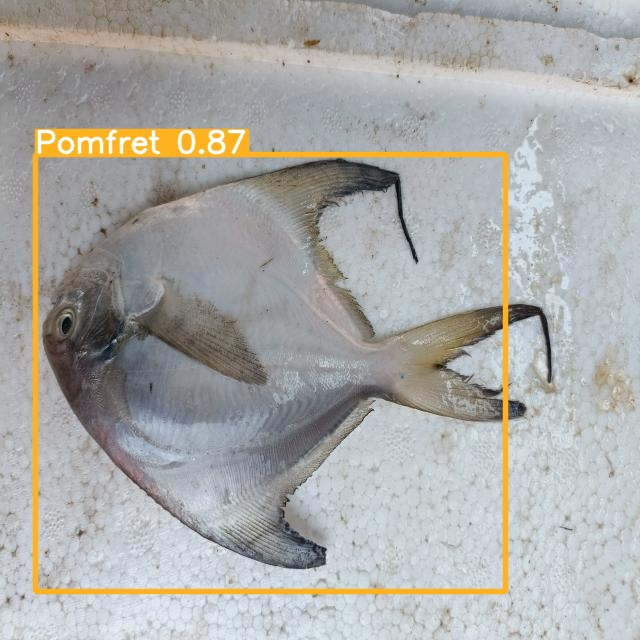

/content/yolov5/runs/detect/exp2/005--49-_jpg.rf.47ce64835daba70c5dc21309e7ab54f1.jpg 

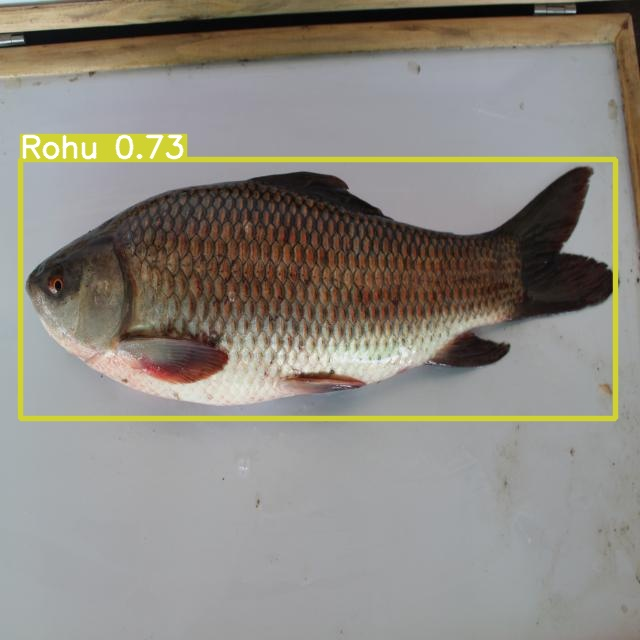

/content/yolov5/runs/detect/exp2/006--95-_JPG.rf.f02ac8ce69fdd42a0a74fa2c457f5a94.jpg 



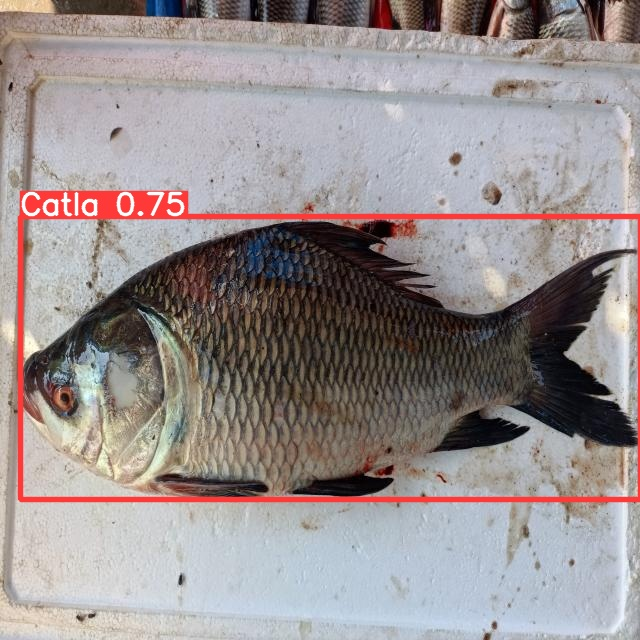

/content/yolov5/runs/detect/exp2/001--182-_jpg.rf.8084361c01facbd9320160ecf7d63279.jpg 

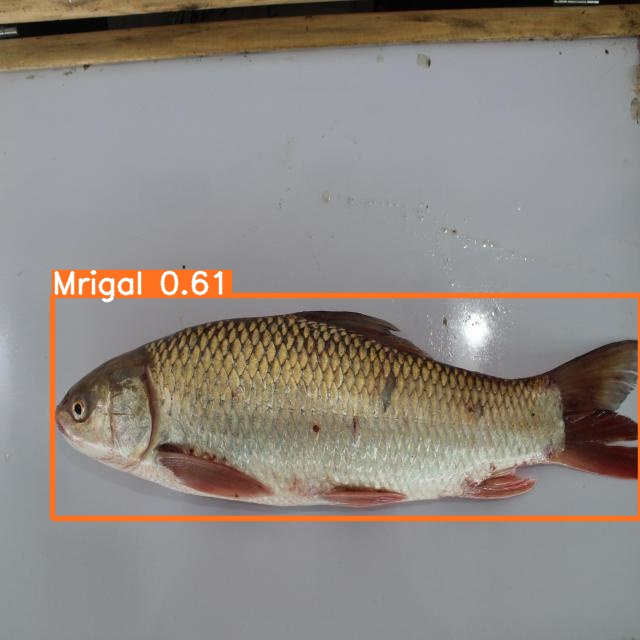

/content/yolov5/runs/detect/exp2/004--130-_JPG.rf.e720454b14c8e389435f63720d6908b8.jpg 

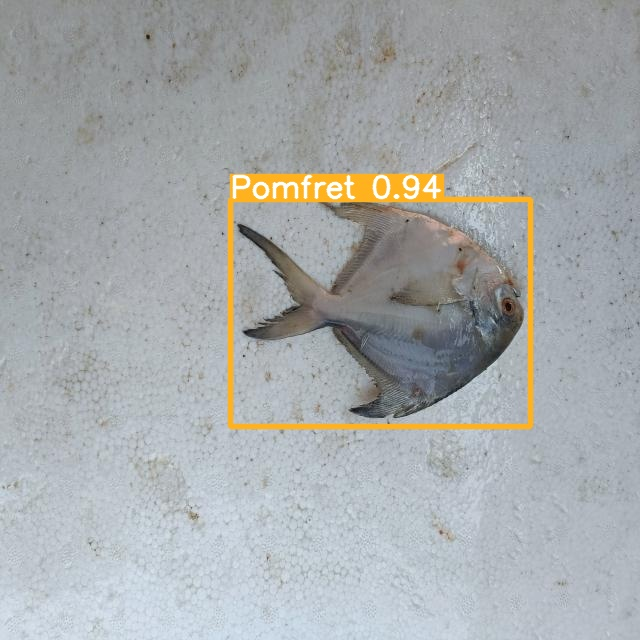

/content/yolov5/runs/detect/exp2/005--13-_jpg.rf.86326dd388b5bec241c01f8f5a62273d.jpg 

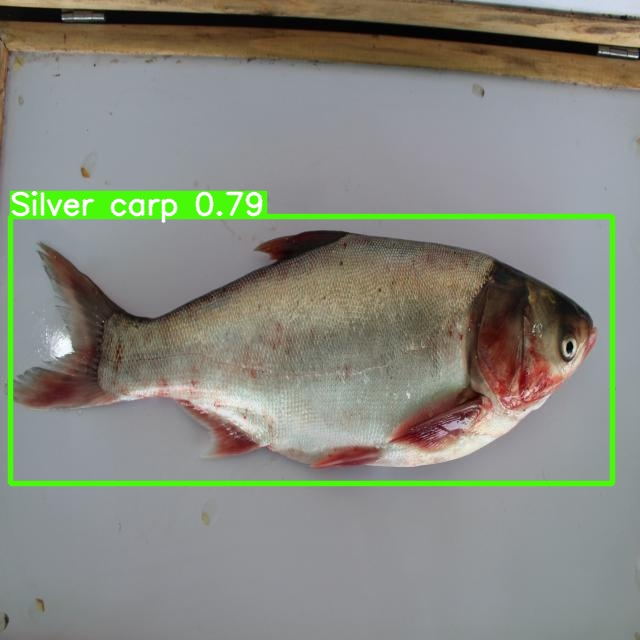

/content/yolov5/runs/detect/exp2/007--14-_JPG.rf.e44c7ca96b09156bfbd2ee6d1756aea2.jpg 



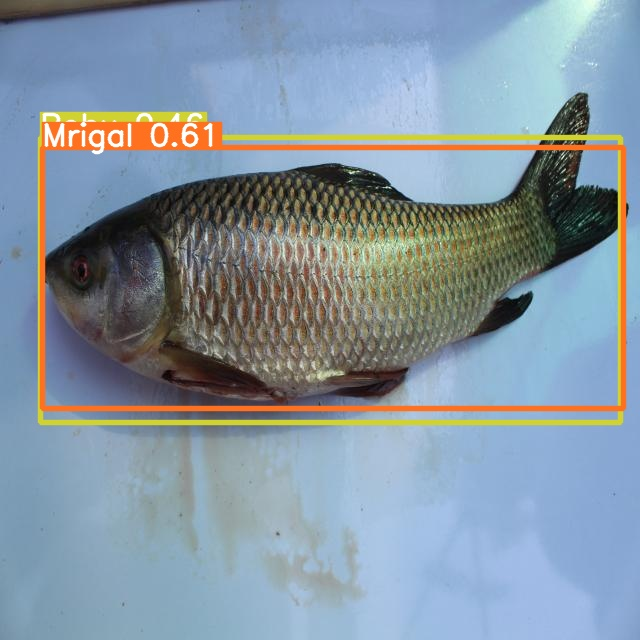

/content/yolov5/runs/detect/exp2/006--82-_JPG.rf.2cef30f3424a195ac3dbc7cf63eb8372.jpg 

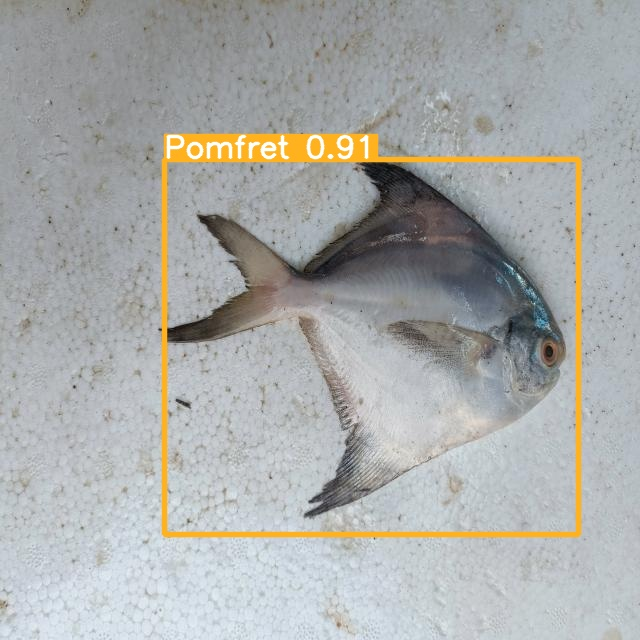

/content/yolov5/runs/detect/exp2/005--35-_jpg.rf.465bd21262062c959fb6ba7434ec56fc.jpg 

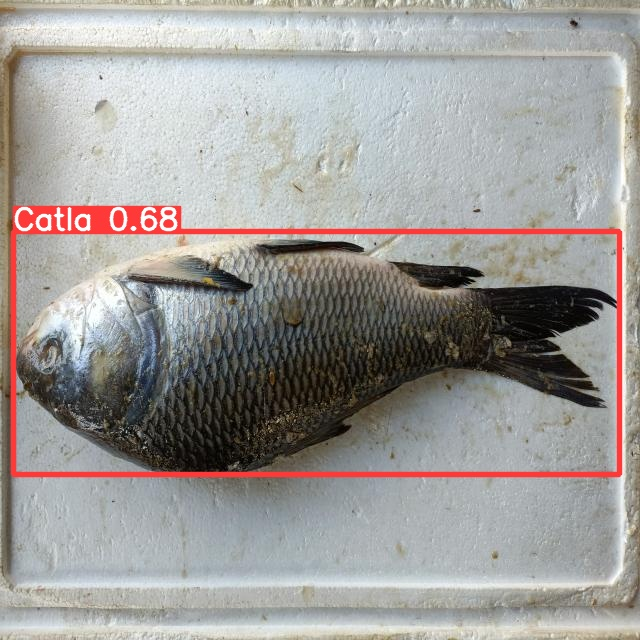

/content/yolov5/runs/detect/exp2/001--168-_jpg.rf.d46bfbe52558357bf7a2fb6a6278102b.jpg 

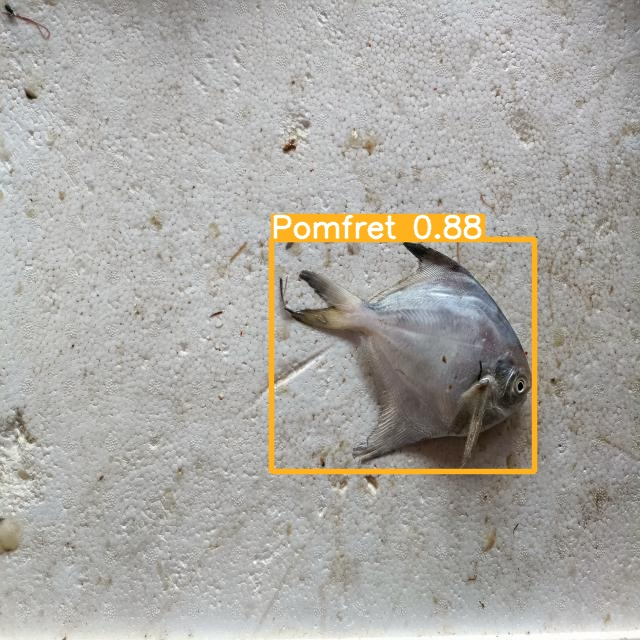

/content/yolov5/runs/detect/exp2/005--139-_jpg.rf.1a4a2e7688de4b478b0d613a242c8ce7.jpg 



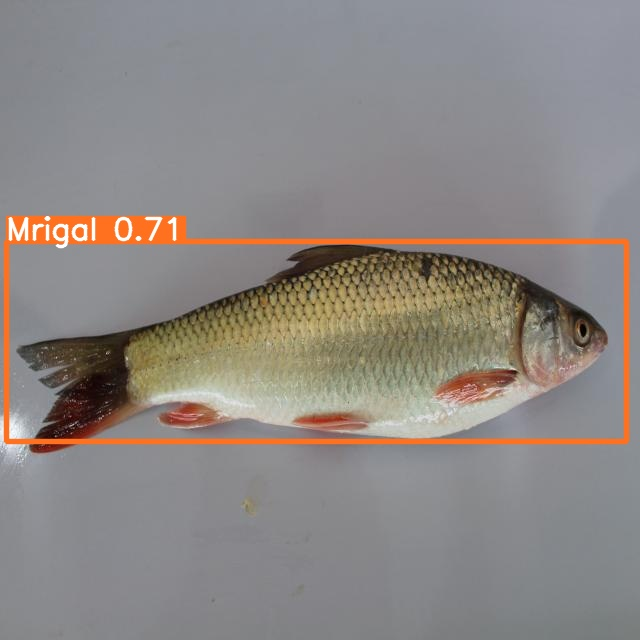

/content/yolov5/runs/detect/exp2/004--105-_JPG.rf.c6ef05e6daa58ccaa2a8d4e7d47fc659.jpg 

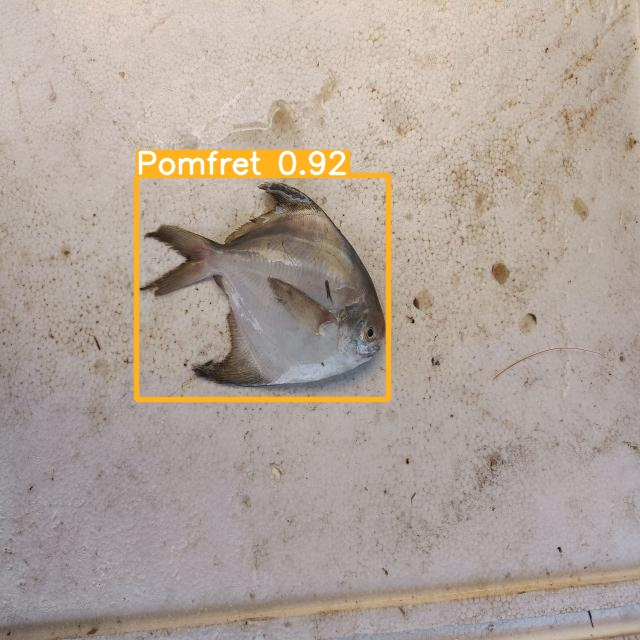

/content/yolov5/runs/detect/exp2/005--71-_jpg.rf.e2f6362b97515219c6db6b5617a84428.jpg 

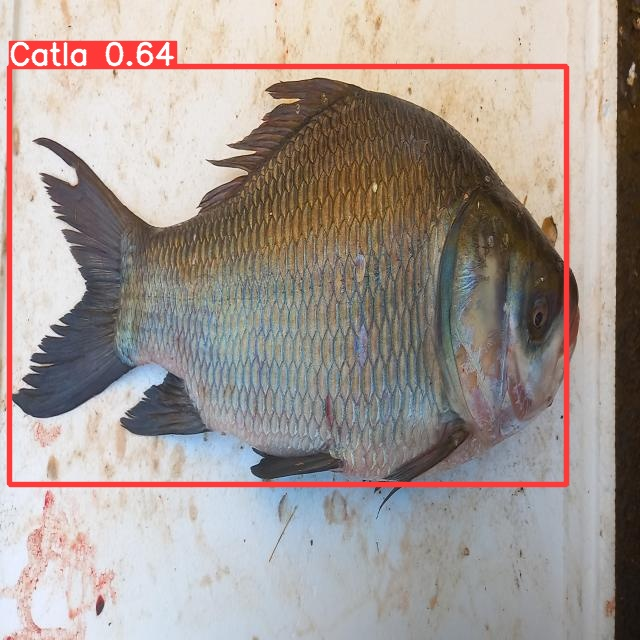

/content/yolov5/runs/detect/exp2/001--85-_jpg.rf.9c306265862628354fe79e7b8b06db2e.jpg 

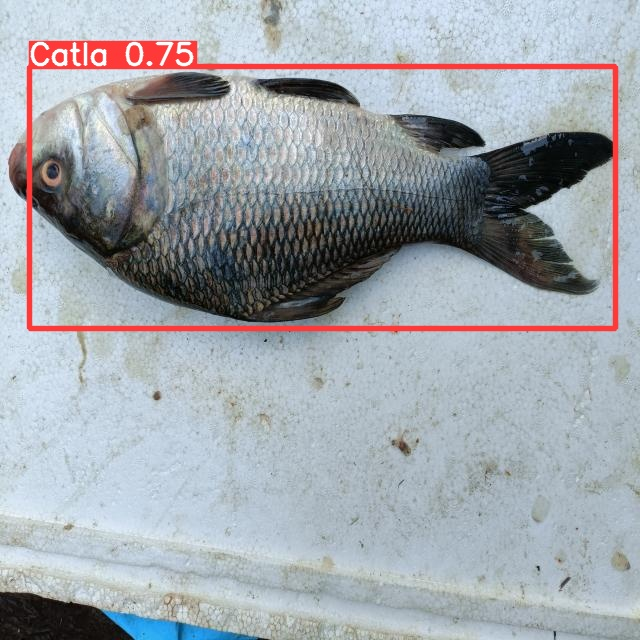

/content/yolov5/runs/detect/exp2/001--13-_jpg.rf.5c73ec96cecb084a921ffa300c330cc7.jpg 



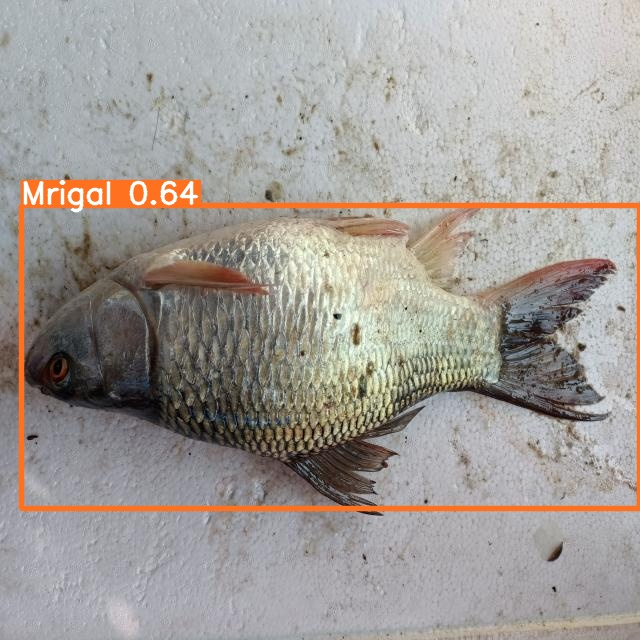

/content/yolov5/runs/detect/exp2/001--170-_jpg.rf.1a9e487741cf926b0bffb099993e28f9.jpg 

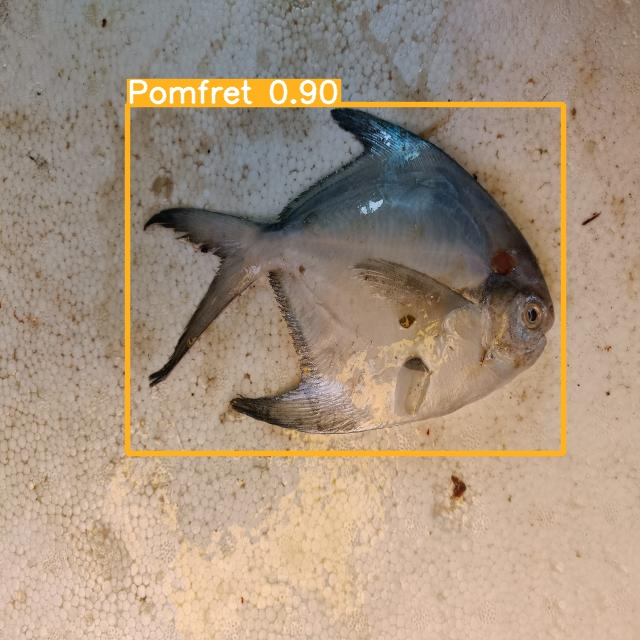

/content/yolov5/runs/detect/exp2/005--89-_jpg.rf.b80bfb99d0770a0819531da23842d5ec.jpg 

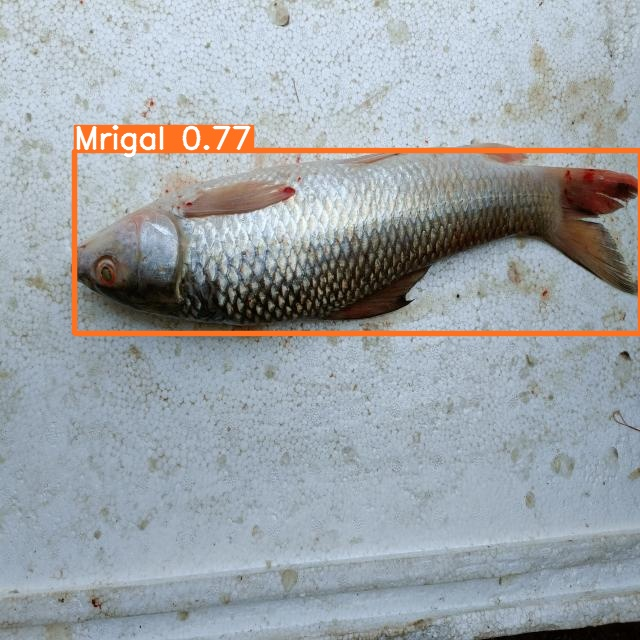

/content/yolov5/runs/detect/exp2/004--51-_jpg.rf.b9e1e681c9a1f340a1bc96fa99797a90.jpg 

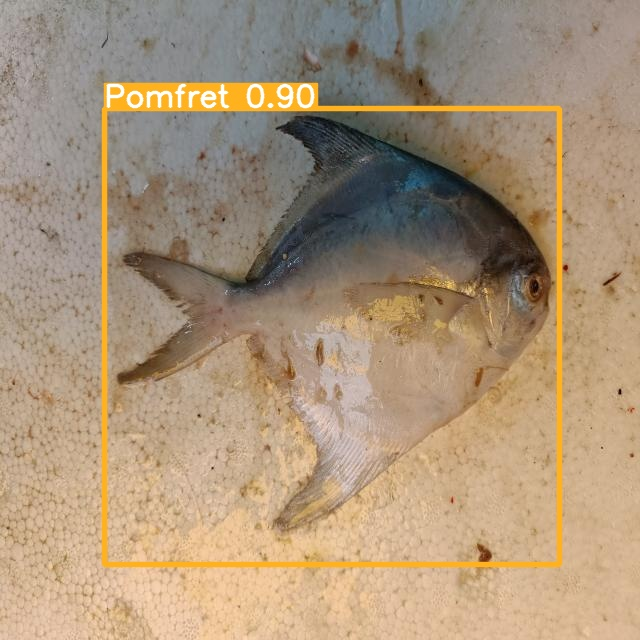

/content/yolov5/runs/detect/exp2/005--93-_jpg.rf.b8a2f98680100ce8183033d867f01409.jpg 



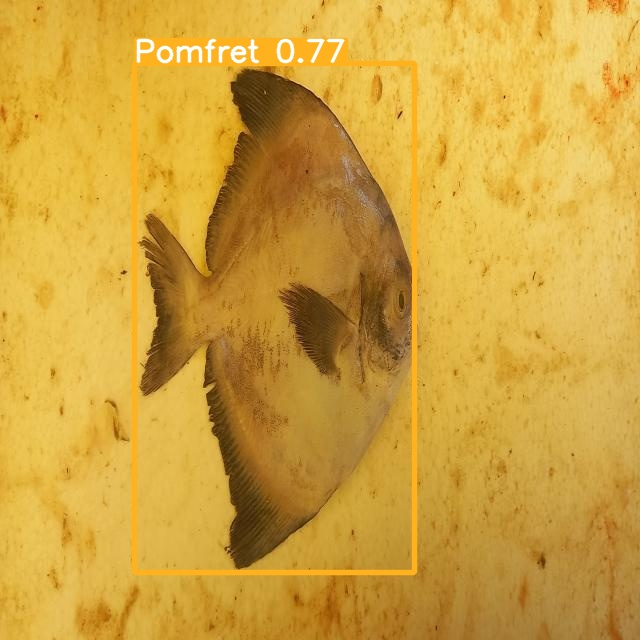

/content/yolov5/runs/detect/exp2/005--188-_jpg.rf.11cc33e0f354bec8c891480cfca9a7dc.jpg 

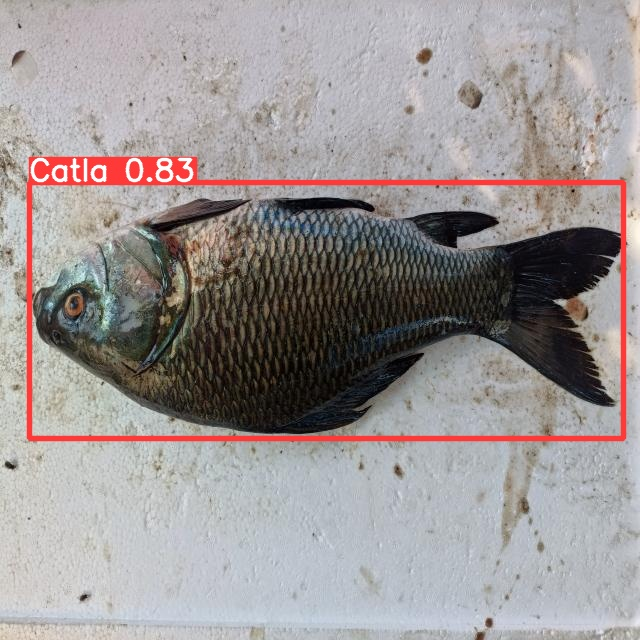

/content/yolov5/runs/detect/exp2/001--176-_jpg.rf.e61d5f9e99f70f6c0933b47c733f525b.jpg 

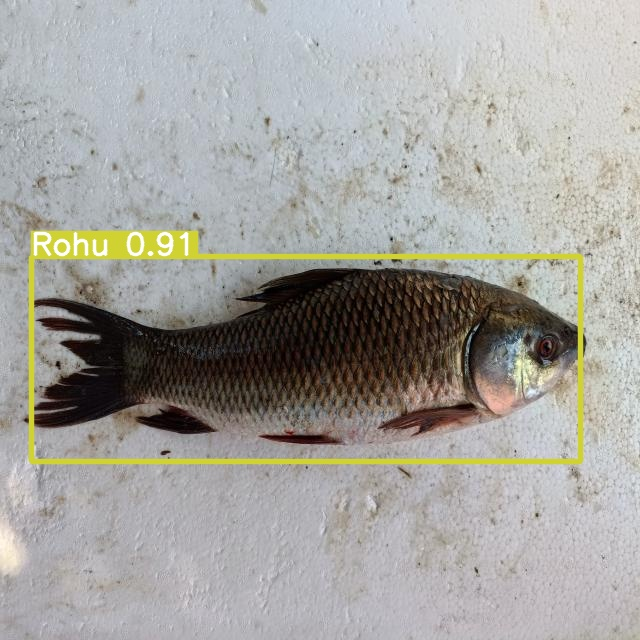

/content/yolov5/runs/detect/exp2/006--49-_jpg.rf.63d9dceb887d33c7867e0061c4bae647.jpg 

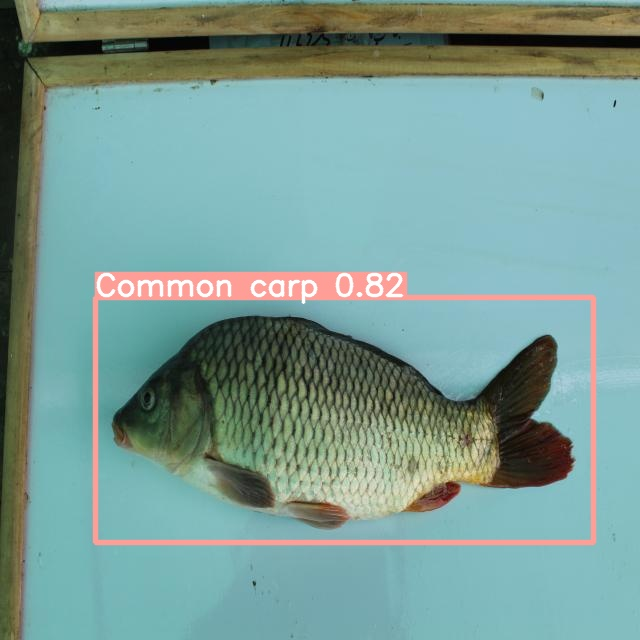

/content/yolov5/runs/detect/exp2/002--28-_JPG.rf.813b5e9db3cc79dbdfe48d6b96ca4069.jpg 



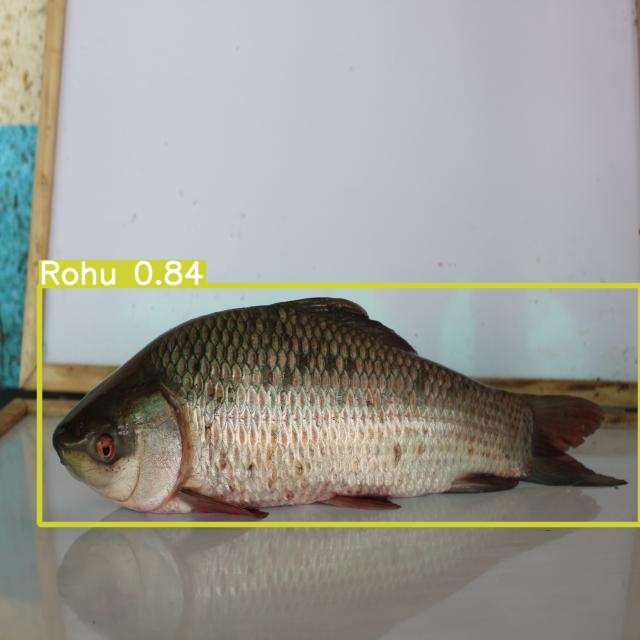

/content/yolov5/runs/detect/exp2/006--98-_JPG.rf.48b28bed0ae6429dbe0ff3b62ff24807.jpg 

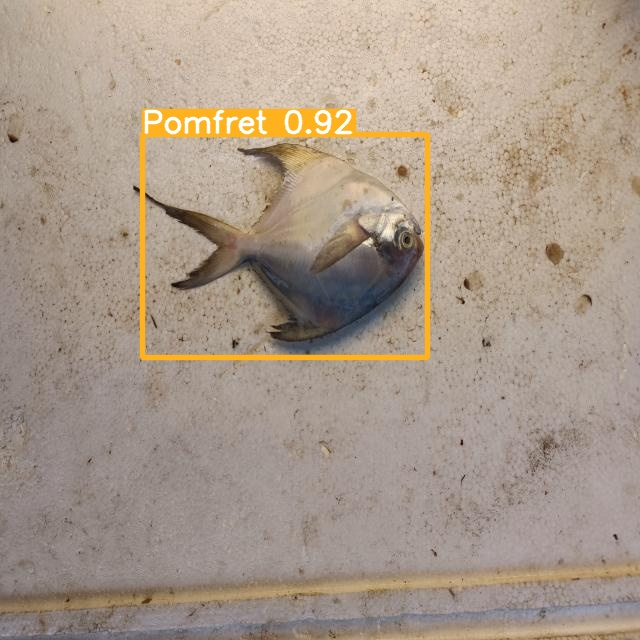

/content/yolov5/runs/detect/exp2/005--60-_jpg.rf.284ce0a77c0314ef27e42f7fee572204.jpg 

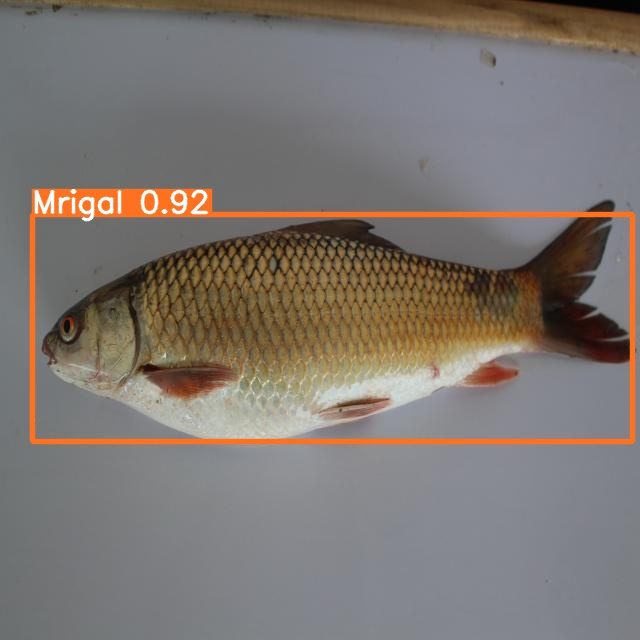

/content/yolov5/runs/detect/exp2/004--112-_JPG.rf.951759b192e4e9a8000b822df27e5e73.jpg 

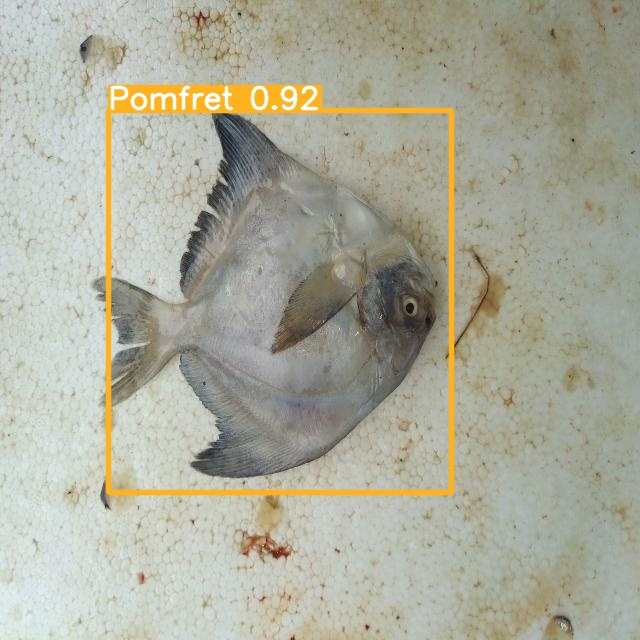

/content/yolov5/runs/detect/exp2/IMG_20220909_102011_jpg.rf.ca68e66f293a695da57887f545786def.jpg 



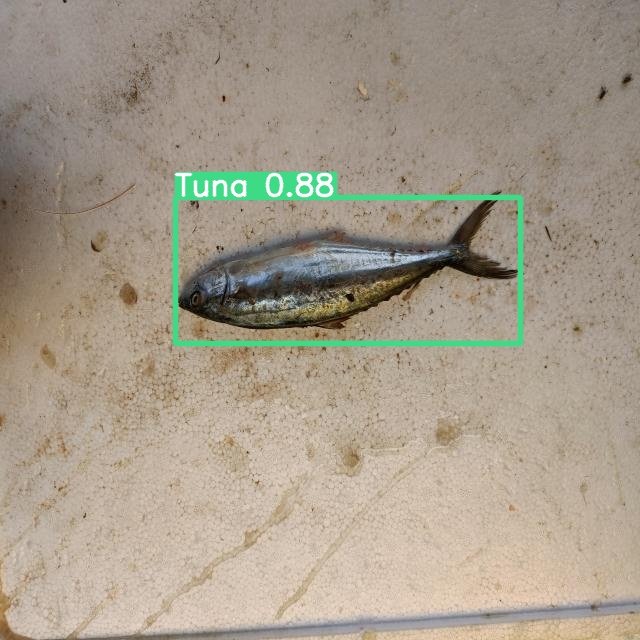

/content/yolov5/runs/detect/exp2/009--62-_jpg.rf.88f87293a7a974758e63ff4035df6886.jpg 

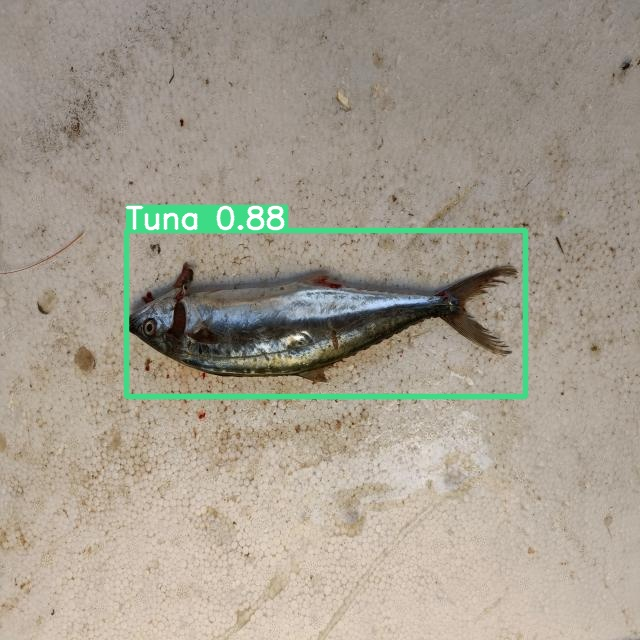

/content/yolov5/runs/detect/exp2/009--71-_jpg.rf.42108a98651fecd9c91850300692303e.jpg 

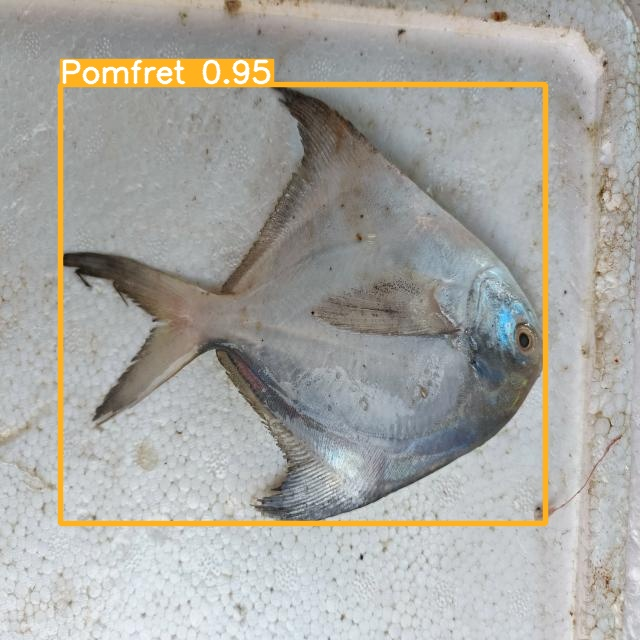

/content/yolov5/runs/detect/exp2/005--39-_jpg.rf.d1ebe5a23f5b98e5dada59f4fcd1d1d7.jpg 

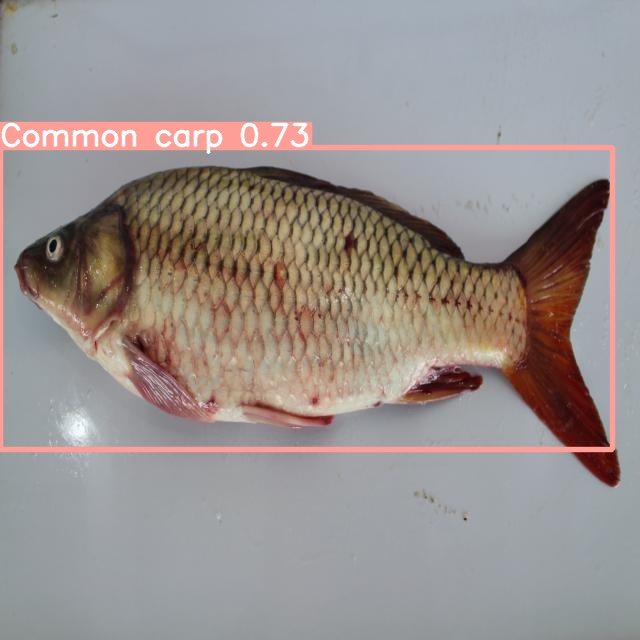

/content/yolov5/runs/detect/exp2/002--10-_JPG.rf.bce67d2ec5f7e6fc7b9196c67041127f.jpg 



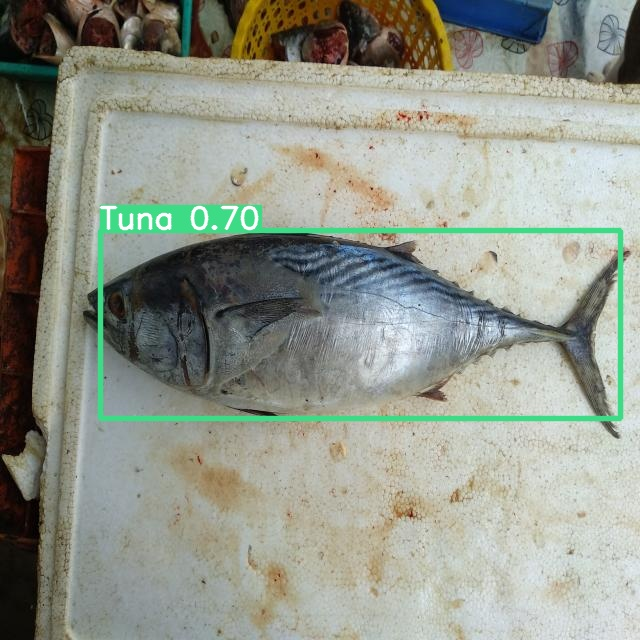

/content/yolov5/runs/detect/exp2/009--16-_jpg.rf.bc7963947a3b1c5bc0a66df05e5d5171.jpg 

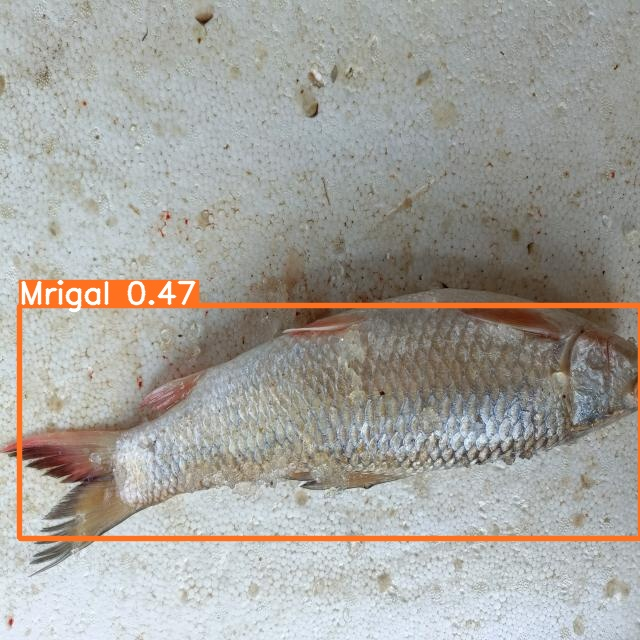

/content/yolov5/runs/detect/exp2/004--67-_jpg.rf.7240f485591603b4c194237992ca8e3f.jpg 

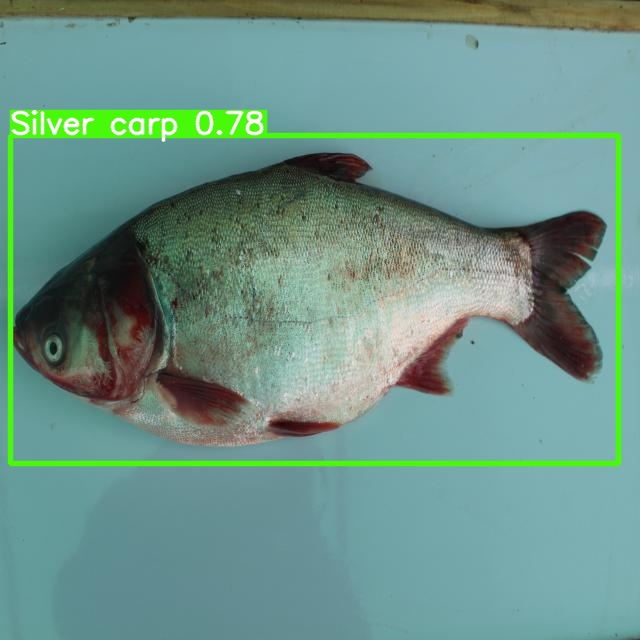

/content/yolov5/runs/detect/exp2/007--74-_JPG.rf.39719db5f23322508af860d10de2fd1d.jpg 

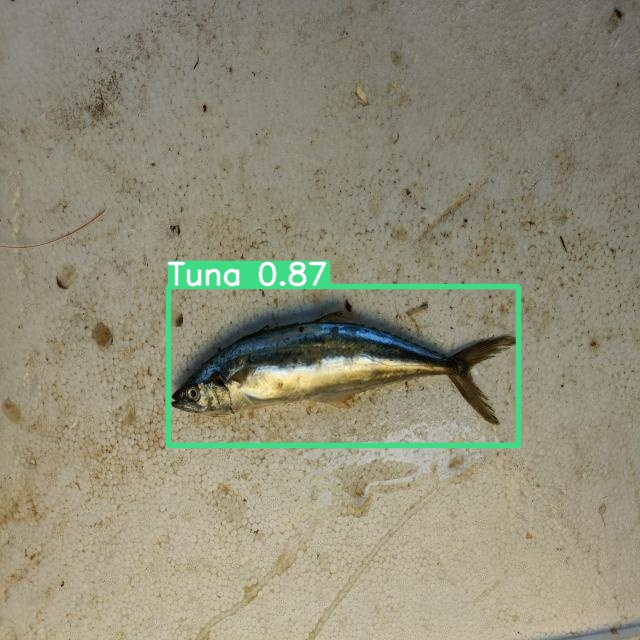

/content/yolov5/runs/detect/exp2/009--66-_jpg.rf.a654f817d084fad26fd4e294f9857fa7.jpg 



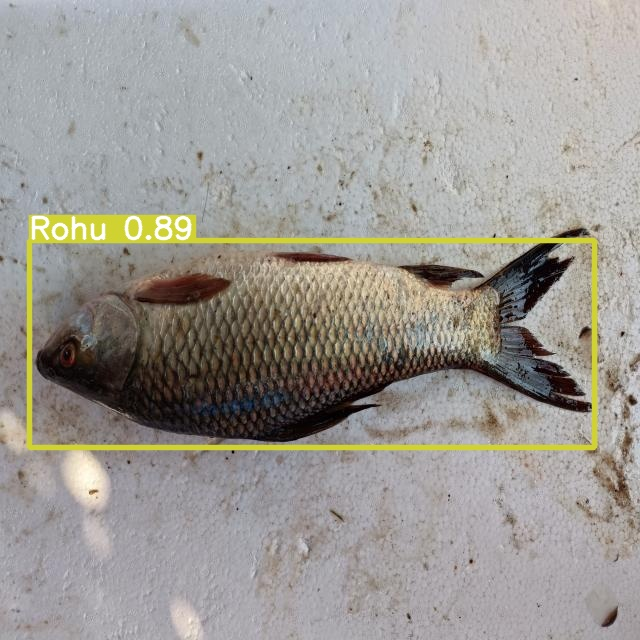

/content/yolov5/runs/detect/exp2/006--42-_jpg.rf.83f21367607949b548c417ee60d1ee21.jpg 

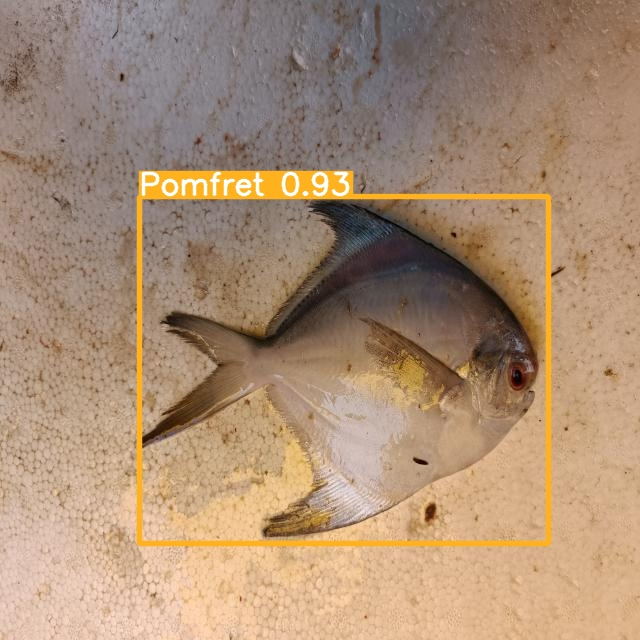

/content/yolov5/runs/detect/exp2/005--82-_jpg.rf.37156c35802d943cebdd3722d78854e0.jpg 

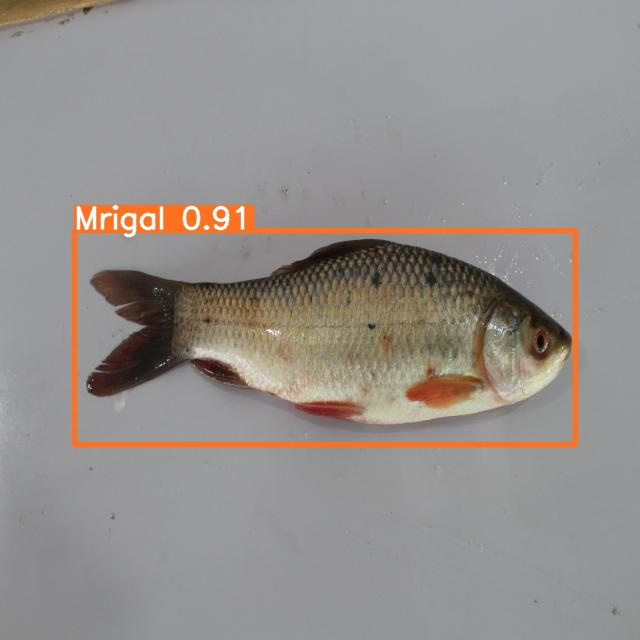

/content/yolov5/runs/detect/exp2/006--135-_JPG.rf.b1743ebb84930a9a4bb2201df35541c3.jpg 

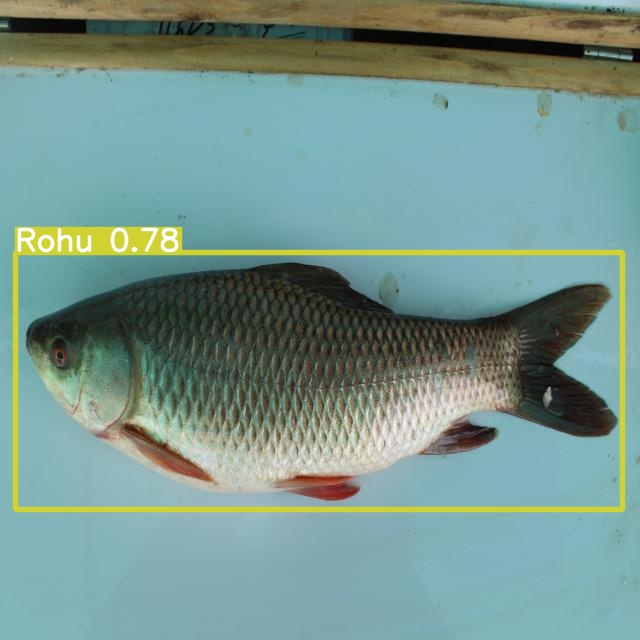

/content/yolov5/runs/detect/exp2/006--147-_JPG.rf.df9c88da48f0770acfebfe1e57d28224.jpg 



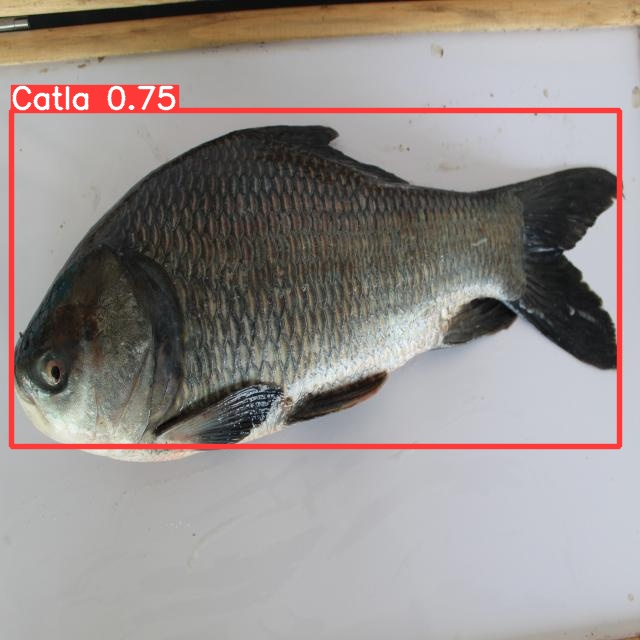

/content/yolov5/runs/detect/exp2/001--111-_JPG.rf.493bbe408e85146ff4ed078f2c4321b8.jpg 

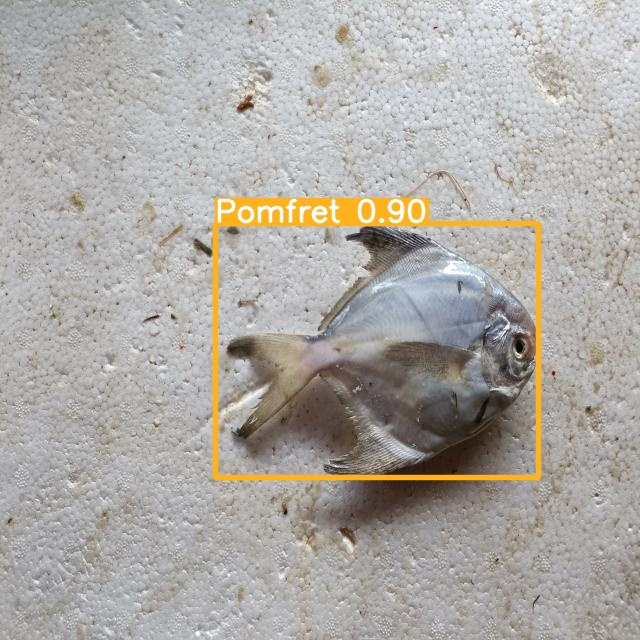

/content/yolov5/runs/detect/exp2/005--164-_jpg.rf.7e42b9eb0acdb1521105941720cda7e8.jpg 

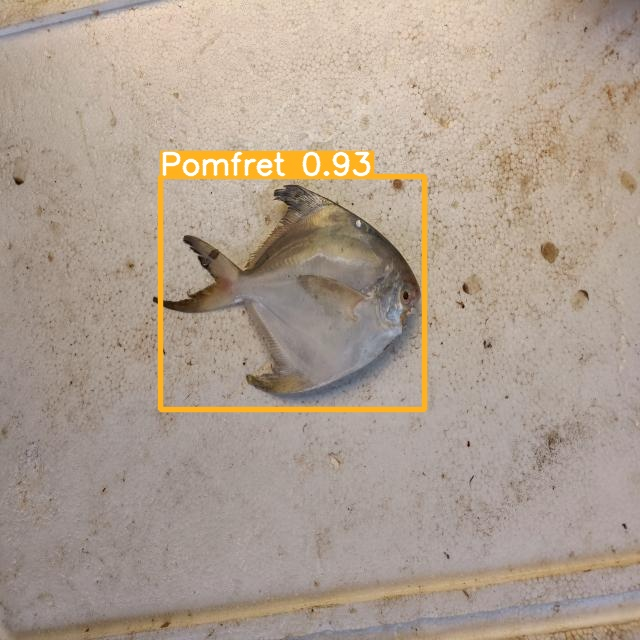

/content/yolov5/runs/detect/exp2/005--58-_jpg.rf.4fbea8625870de0ac4ba34e0ffe57b44.jpg 

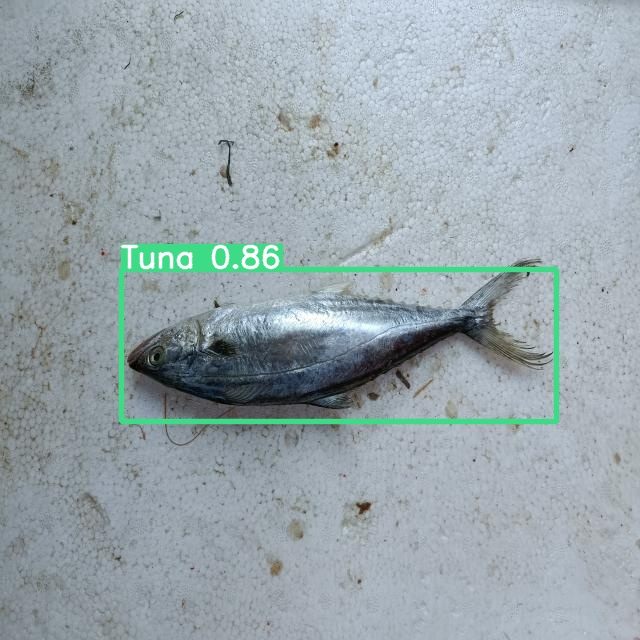

/content/yolov5/runs/detect/exp2/009--6-_jpg.rf.7f91e6057b3e92f771e2fb803d7c0f8b.jpg 



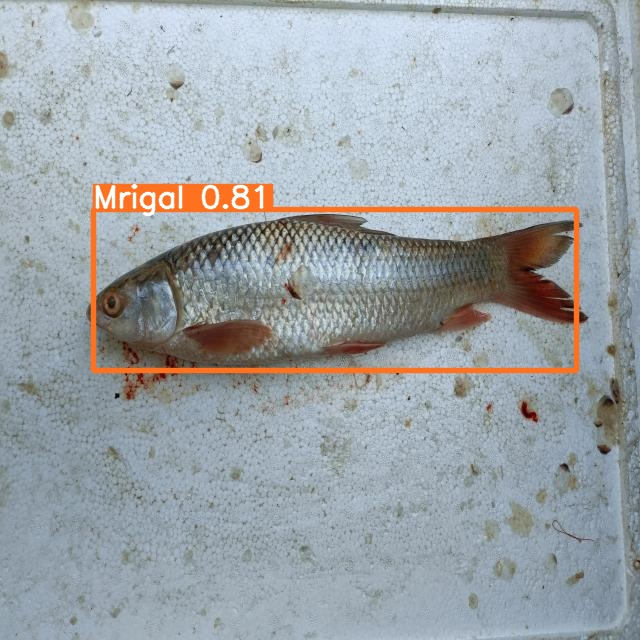

/content/yolov5/runs/detect/exp2/004--48-_jpg.rf.23477b2d57b85b0d9c5fd73b7b4e6e26.jpg 

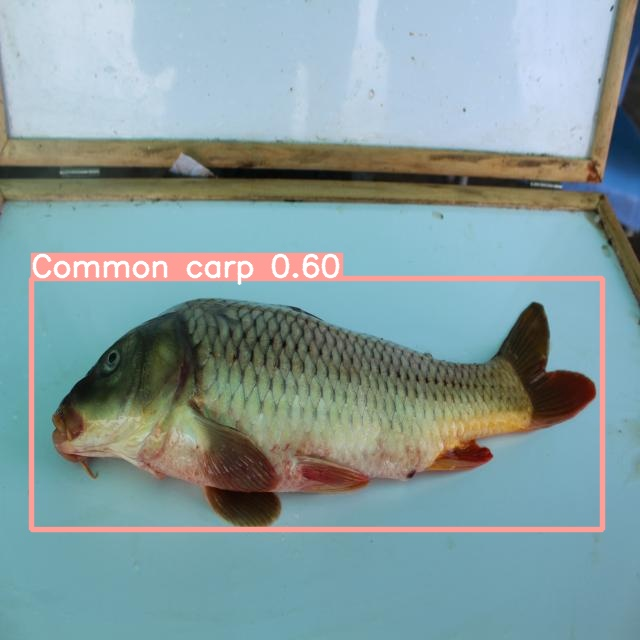

/content/yolov5/runs/detect/exp2/002--30-_JPG.rf.f4c227b725d440183876eb16742ab209.jpg 

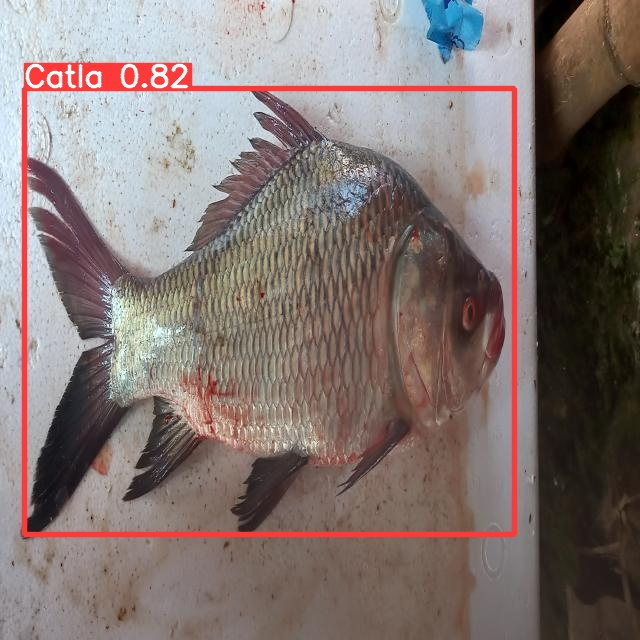

/content/yolov5/runs/detect/exp2/001--44-_jpg.rf.66f2cf4a5a3621c3704aca4dd1e0698e.jpg 

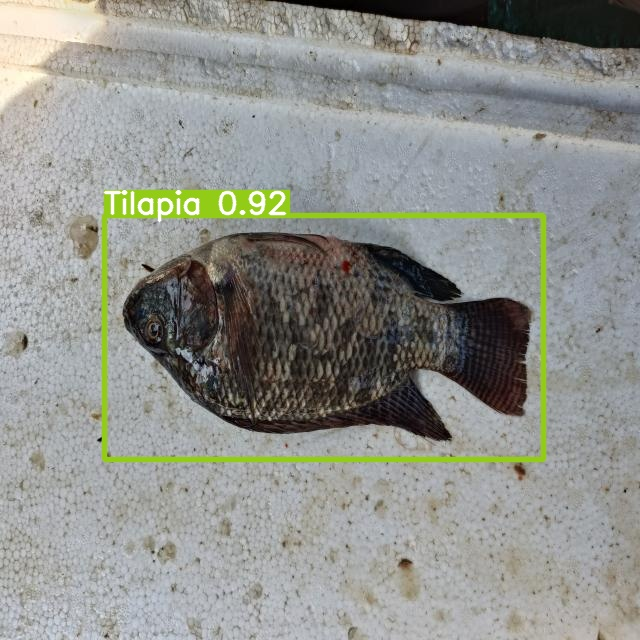

/content/yolov5/runs/detect/exp2/008--118-_jpg.rf.81328b5e74e5f791c7a0b5e99d4648d8.jpg 



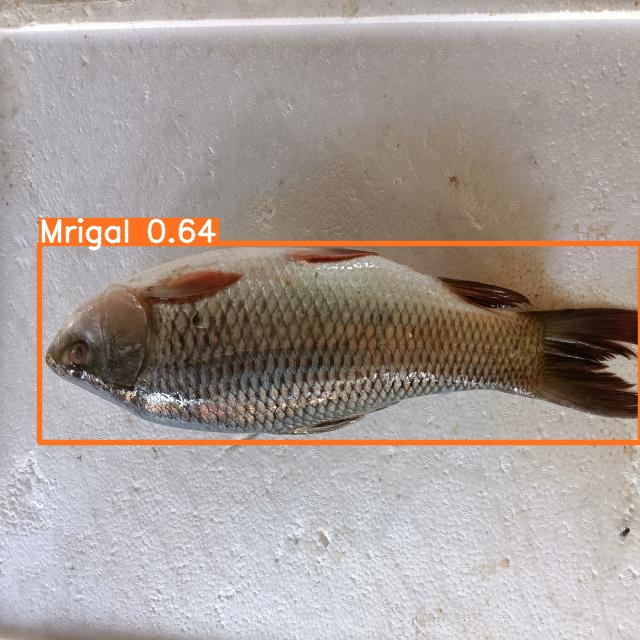

/content/yolov5/runs/detect/exp2/006--13-_jpg.rf.b38e111d1e11c50f7bc3ef26ce425e6b.jpg 

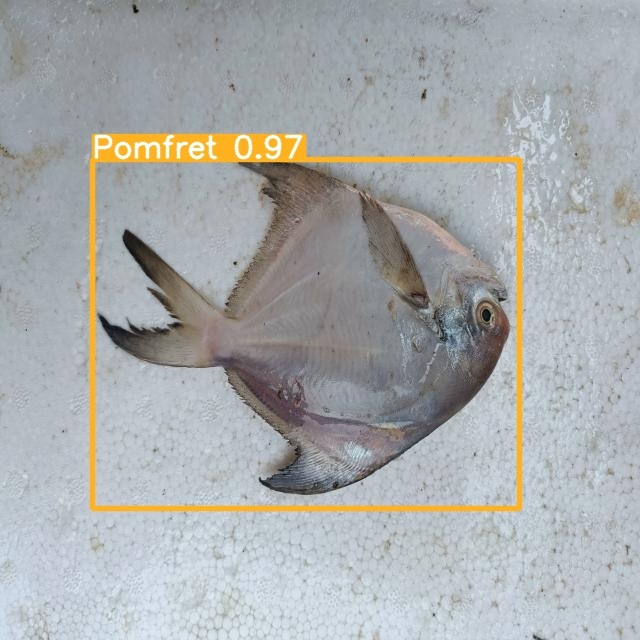

/content/yolov5/runs/detect/exp2/005--34-_jpg.rf.6941ec2dadc9a3e6dbb8844ec34b1b8d.jpg 

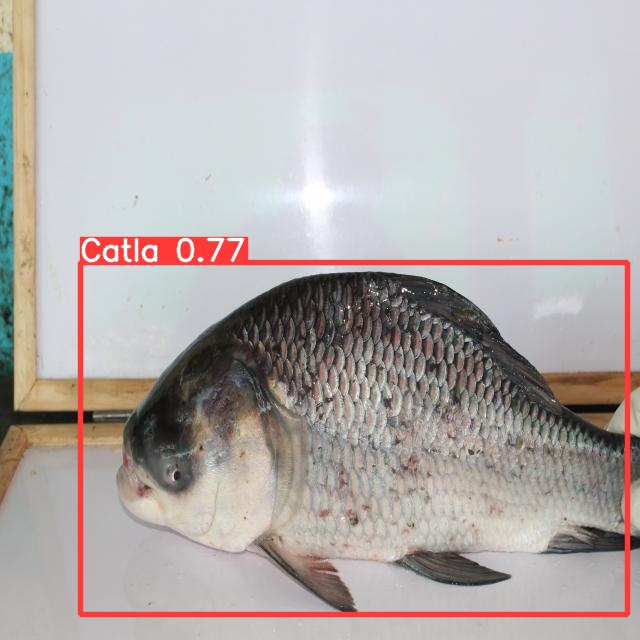

/content/yolov5/runs/detect/exp2/001--107-_JPG.rf.4cfddef3520eab1206949c58ca214f4c.jpg 

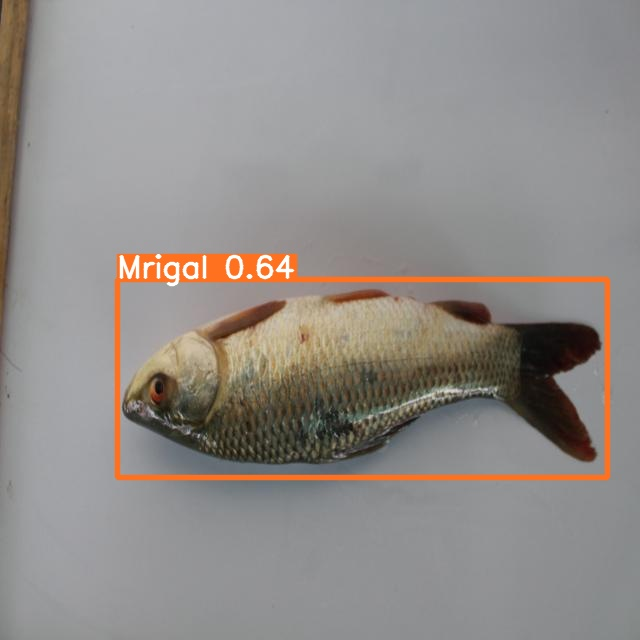

/content/yolov5/runs/detect/exp2/006--124-_JPG.rf.724ad0b5909ce1e3dfbc44f00518b6ba.jpg 



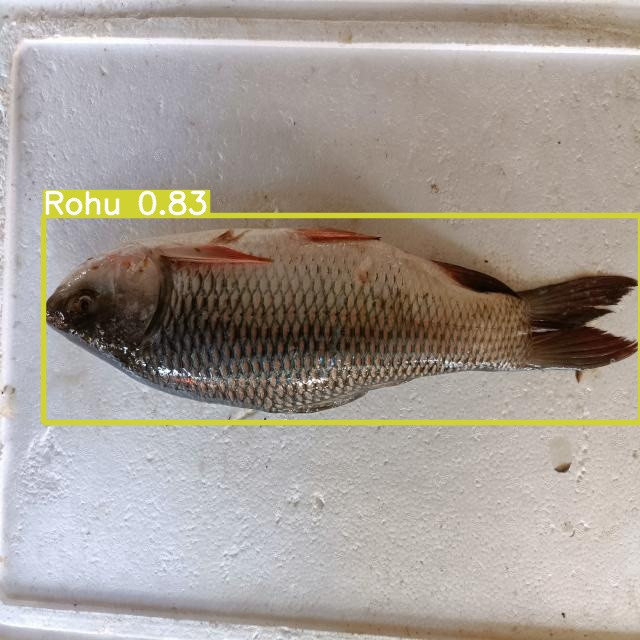

/content/yolov5/runs/detect/exp2/006--34-_jpg.rf.c654f61f9b517082b7e27d2c0c75e6d2.jpg 

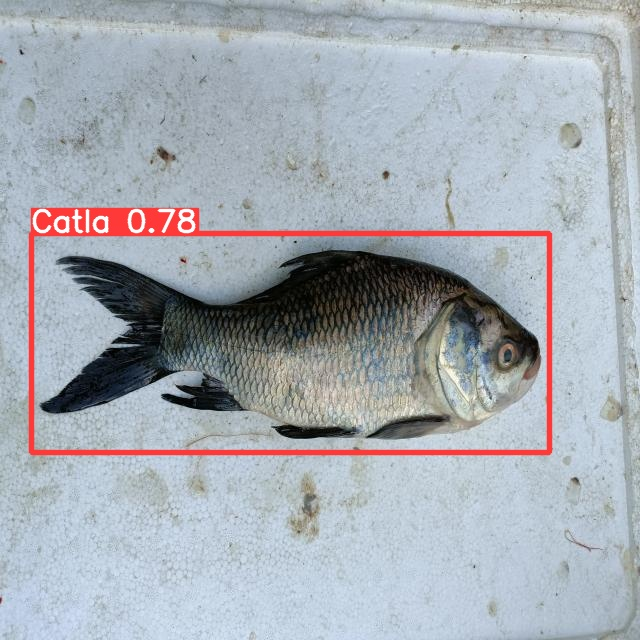

/content/yolov5/runs/detect/exp2/001--11-_jpg.rf.24e5e5bd1e7457f1615dc7e7208c9e0e.jpg 

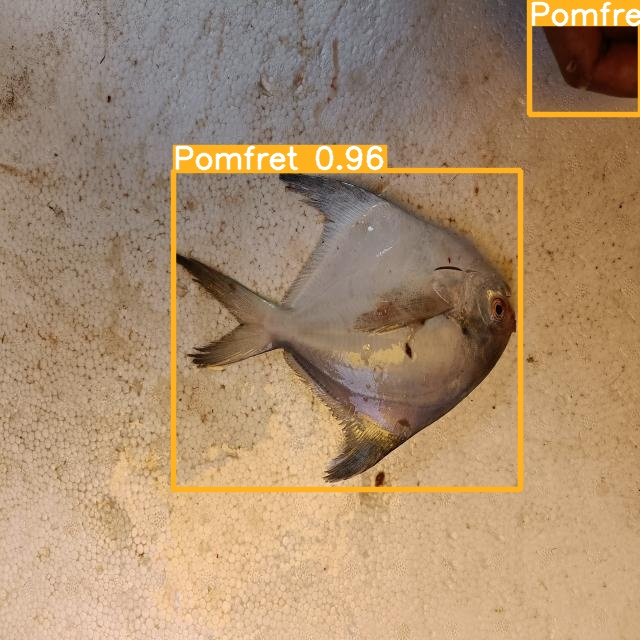

/content/yolov5/runs/detect/exp2/005--79-_jpg.rf.9ff3a14026d4ce96c7a36b29524818af.jpg 

In [ ]:
import glob
from IPython.display import Image, display
i = 0
for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    i += 1
    display(Image(filename=imageName, width = 300))
    print(imageName, end = " ")
    if i%4 == 0:
      print("\n")

In [ ]:
Image(filename='/content/yolov5/runs/detect/exp', width=900)

## Yolov5 with coco weights

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

import torch
import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v7.0-5-gbfa1f23 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 22.6/78.2 GB disk)


In [ ]:
import torch

from IPython.display import Image, clear_output  # to display images
from utils.downloads import attempt_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.12.1+cu113 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


### Installing roboflow


In [ ]:
!pip install -q roboflow

     |████████████████████████████████| 41 kB 113 kB/s 
     |████████████████████████████████| 178 kB 63.8 MB/s 
     |████████████████████████████████| 54 kB 3.3 MB/s 
     |████████████████████████████████| 145 kB 68.8 MB/s 
     |████████████████████████████████| 138 kB 69.8 MB/s 
     |████████████████████████████████| 67 kB 6.7 MB/s 
     |████████████████████████████████| 62 kB 1.5 MB/s 


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="kTldzEleHpjBKQd5BPDZ")
project = rf.workspace("college-rhnpn").project("mtp-dataset-w5da1")
dataset = project.version(1).download("yolov5")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to MTP-dataset-1 in yolov5pytorch:: 100%|██████████| 3818/3818 [00:01<00:00, 2086.26it/s]


In [ ]:
%cat {dataset.location}/data.yaml

names:
- Catla
- Common carp
- Mrigal
- Pomfret
- Rohu
- Silver carp
- Tilapia
- Tuna
nc: 8
roboflow:
  license: CC BY 4.0
  project: mtp-dataset-w5da1
  url: https://universe.roboflow.com/project/mtp-dataset-w5da1/dataset/1
  version: 1
  workspace: project
test: ../test/images
train: MTP-dataset-1/train/images
val: MTP-dataset-1/valid/images


### Training

In [ ]:
!python train.py --img 640 --batch 8 --epochs 70 --data {dataset.location}/data.yaml  --cfg /content/yolov5/models/yolov5s.yaml --weights yolov5s.pt --name Yolov5C_results  --cache

train: weights=yolov5s.pt, cfg=/content/yolov5/models/yolov5s.yaml, data=/content/yolov5/MTP-dataset-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=70, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=Yolov5C_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-5-gbfa1f23 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou

### Graphs


In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

### Detection

GROUND TRUTH TRAINING DATA:


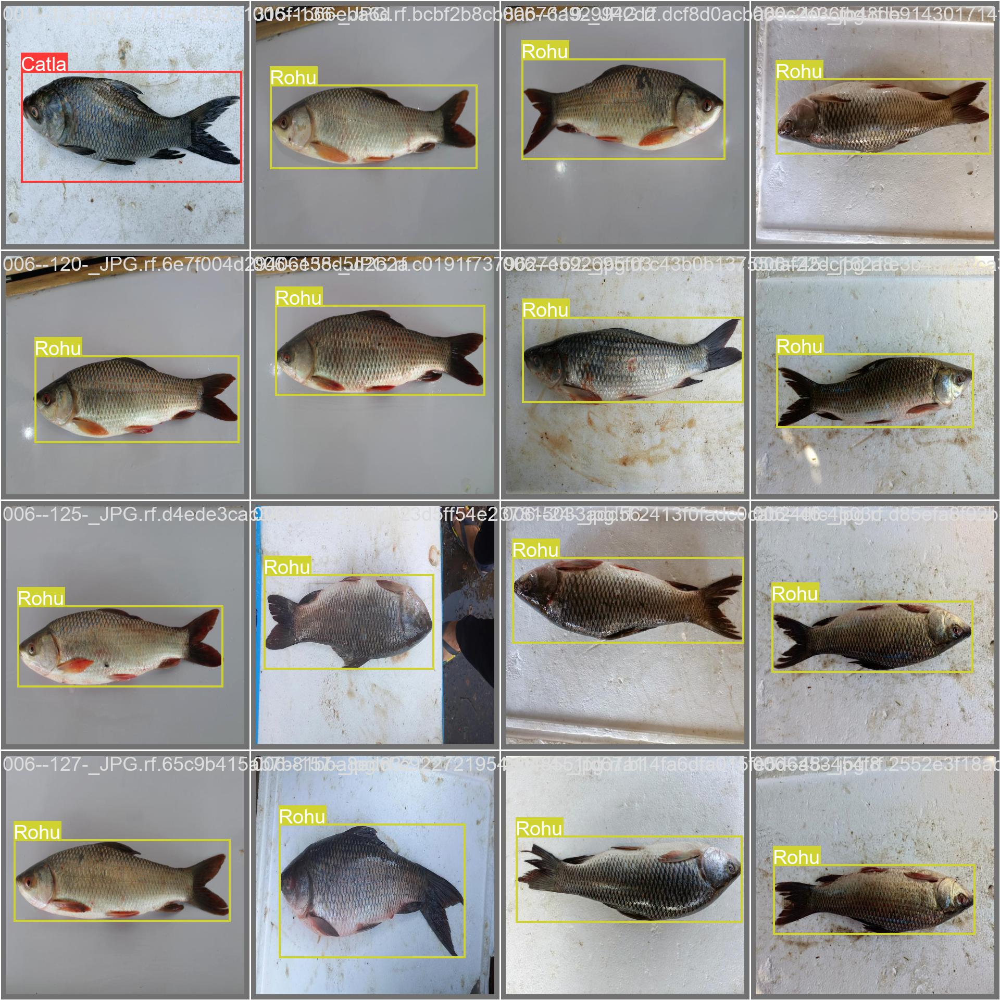

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/Yolov5C_results2/val_batch0_labels.jpg', width=900)

In [ ]:
!python detect.py --weights runs/train/Yolov5C_results2/weights/best.pt --img 640 --conf 0.4 --source /content/yolov5/MTP-dataset-1/test/images

detect: weights=['runs/train/Yolov5C_results2/weights/best.pt'], source=/content/yolov5/MTP-dataset-1/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-5-gbfa1f23 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7031701 parameters, 0 gradients, 15.8 GFLOPs
image 1/91 /content/yolov5/MTP-dataset-1/test/images/001--107-_JPG.rf.4cfddef3520eab1206949c58ca214f4c.jpg: 640x640 1 Catla, 12.7ms
image 2/91 /content/yolov5/MTP-dataset-1/test/images/001--11-_jpg.rf.24e5e5bd1e7457f1615dc7e7208c9e0e.jpg: 640x640 1 Catla, 12.8ms
image 3/91 /content/yolov5/MTP-dataset-1/test/ima

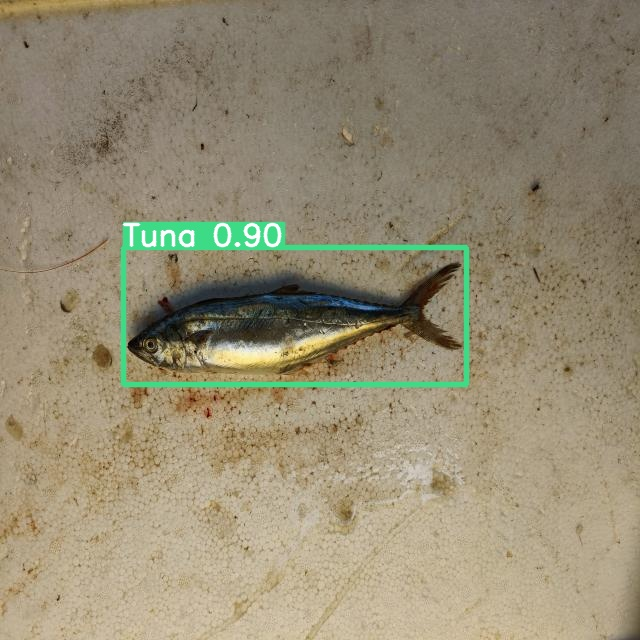

/content/yolov5/runs/detect/exp/009--73-_jpg.rf.90eaf089424510108f7ebd1a190ef77d.jpg 

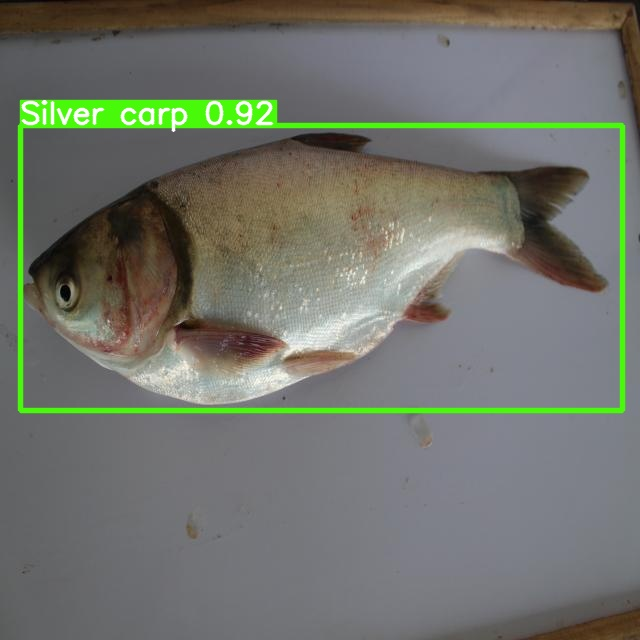

/content/yolov5/runs/detect/exp/007--28-_JPG.rf.7264fcedecc75a224c10ba70b07e3bc0.jpg 

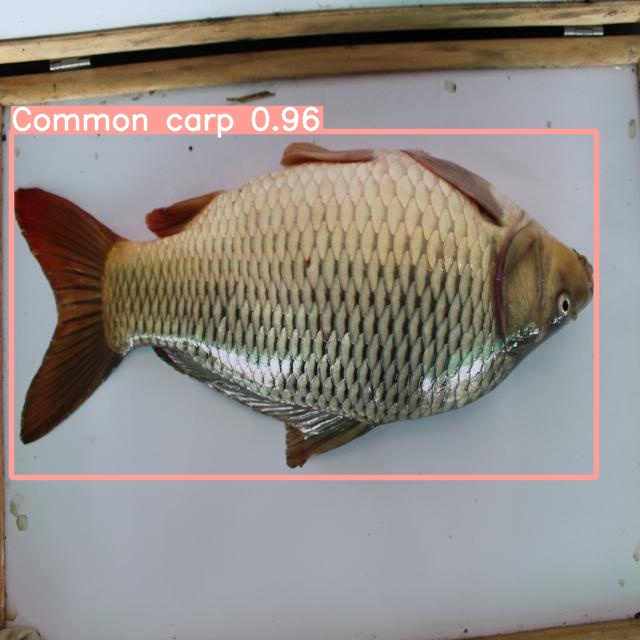

/content/yolov5/runs/detect/exp/002--4-_JPG.rf.6e5888117c3d65695037b141934ab22d.jpg 

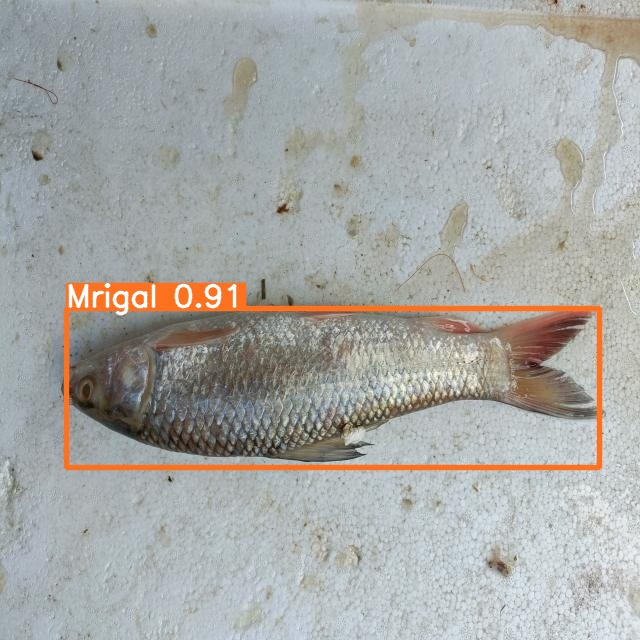

/content/yolov5/runs/detect/exp/004--30-_jpg.rf.f7597a8972c04b767e78db1a97c84b21.jpg 



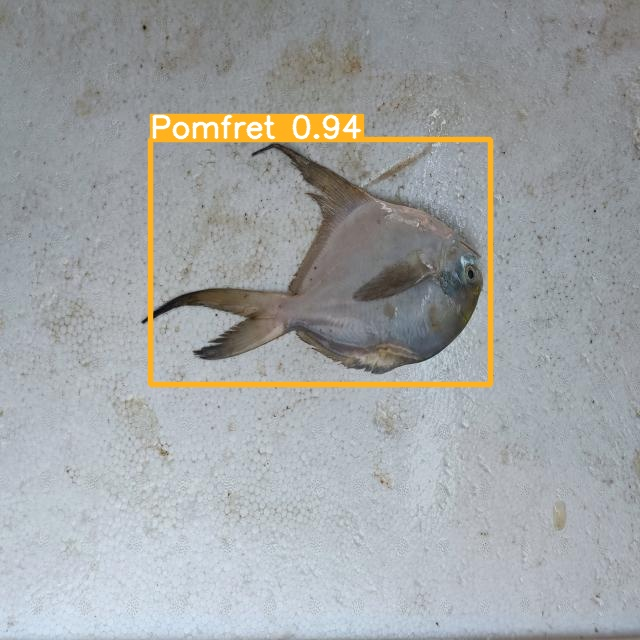

/content/yolov5/runs/detect/exp/005--20-_jpg.rf.508e2aa1403705b43ba4ec392382f616.jpg 

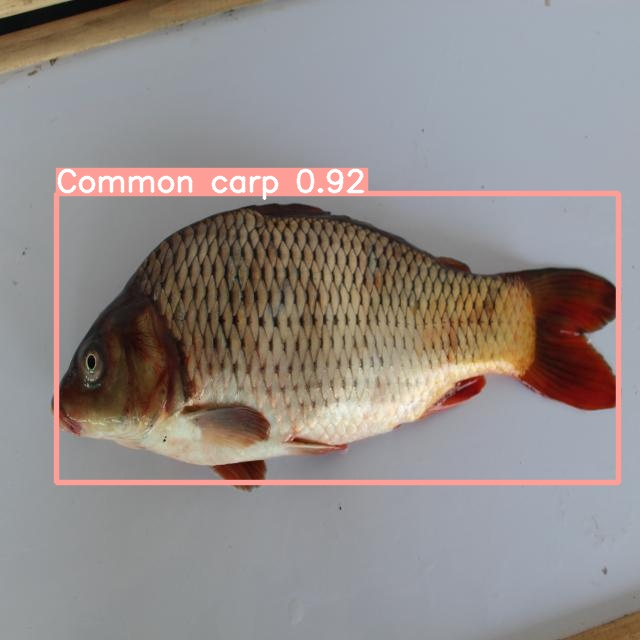

/content/yolov5/runs/detect/exp/002--46-_JPG.rf.f03cd919977295a660e86bc8ce737b34.jpg 

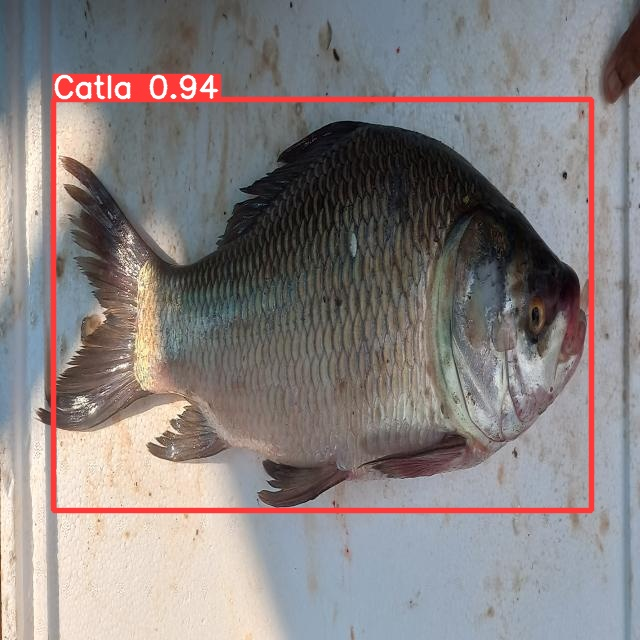

/content/yolov5/runs/detect/exp/001--68-_jpg.rf.12216784b9dd62cee90e48e60eb68e8c.jpg 

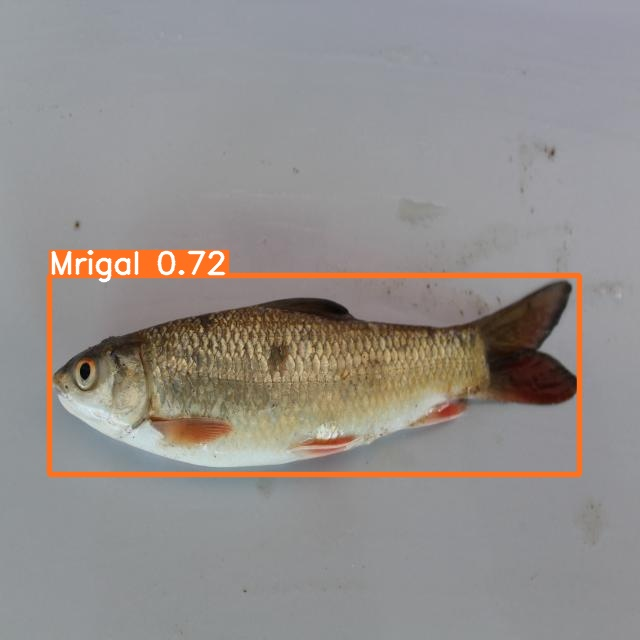

/content/yolov5/runs/detect/exp/004--77-_JPG.rf.3ad3038f1d288cc804e229d1b3cb74c7.jpg 



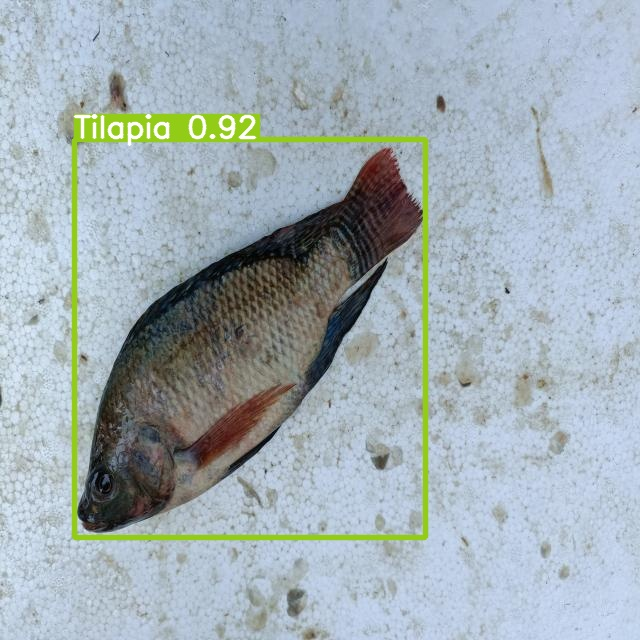

/content/yolov5/runs/detect/exp/008--34-_jpg.rf.031125e94fc92cb1bcc328654da9b886.jpg 

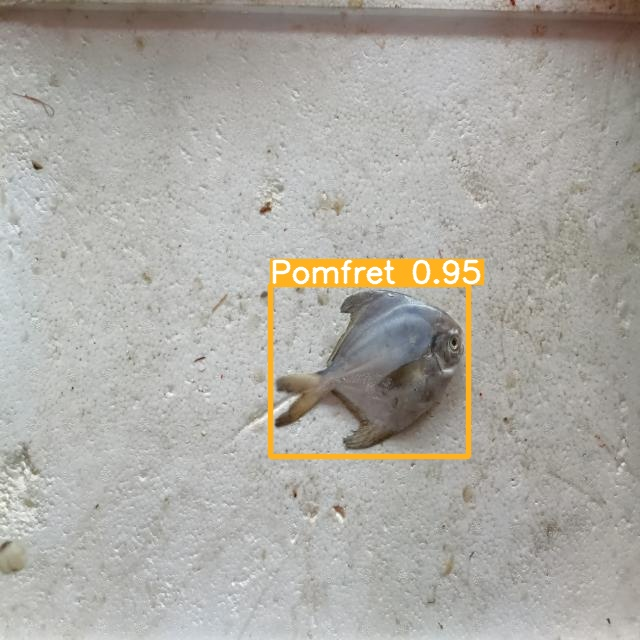

/content/yolov5/runs/detect/exp/005--144-_jpg.rf.9b52fdf3873849e75f0cbac21c56ef3c.jpg 

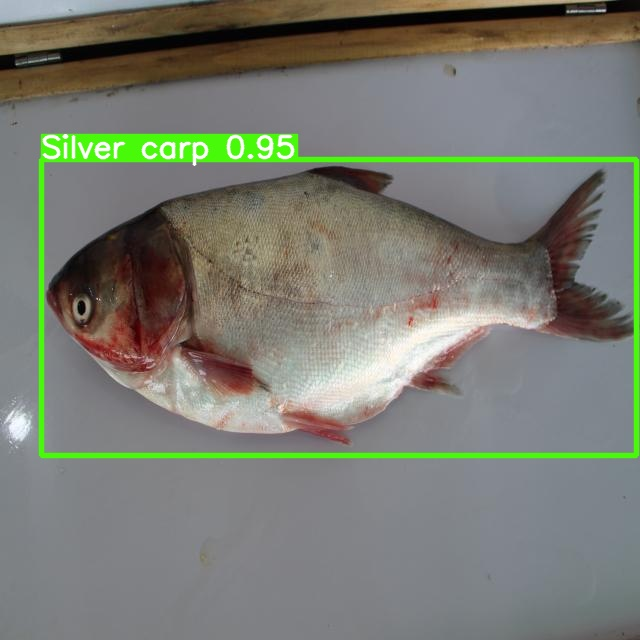

/content/yolov5/runs/detect/exp/007--22-_JPG.rf.9d4cec54de15eabe73b3aacc8b46c445.jpg 

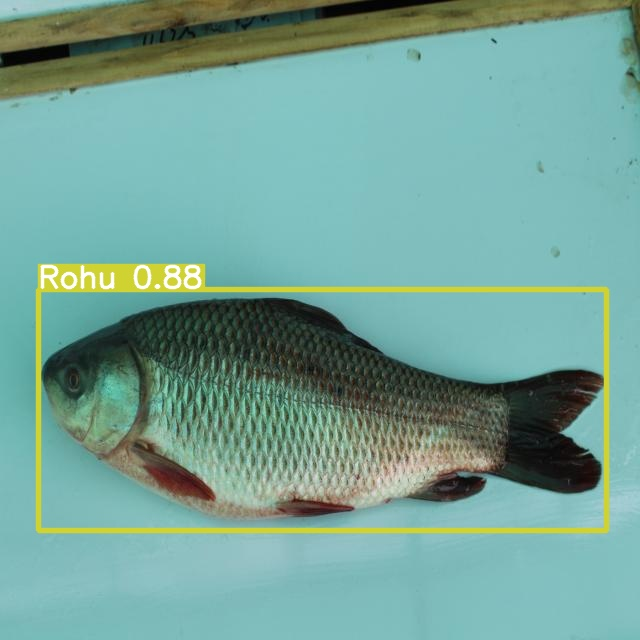

/content/yolov5/runs/detect/exp/006--140-_JPG.rf.fd49b8a47ddcc651053b8e4427621a06.jpg 



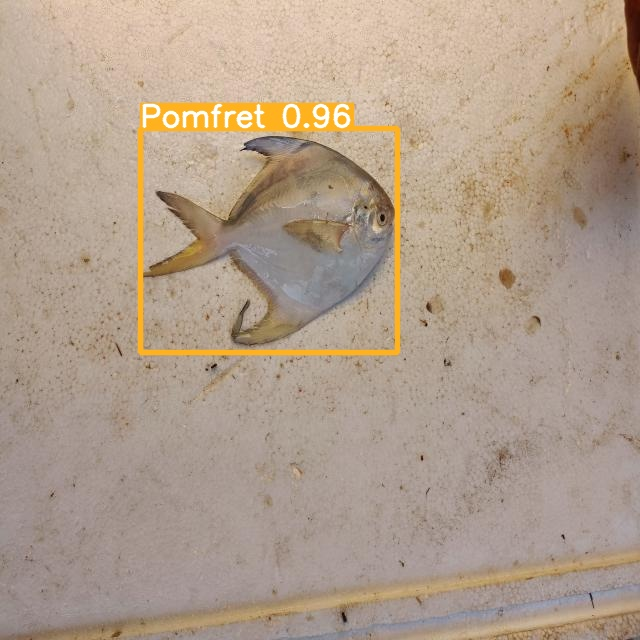

/content/yolov5/runs/detect/exp/005--64-_jpg.rf.076238d2265459ba0498c6010150919e.jpg 

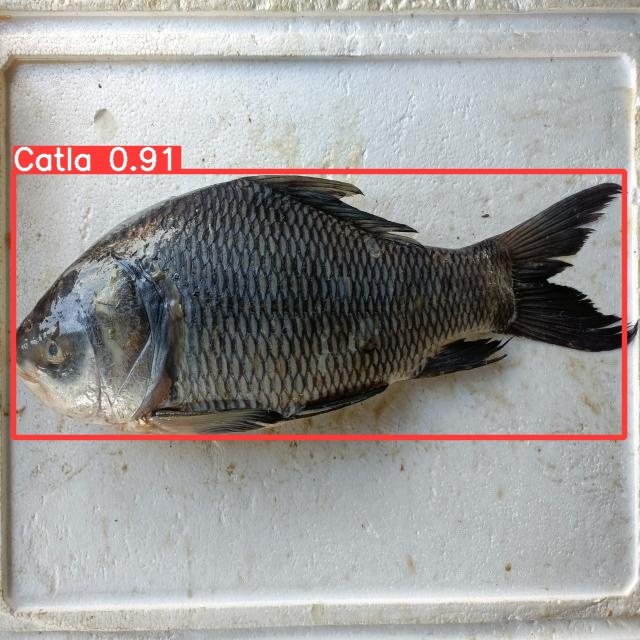

/content/yolov5/runs/detect/exp/001--167-_jpg.rf.12f49404da2d01b8834afa6016ed82c2.jpg 

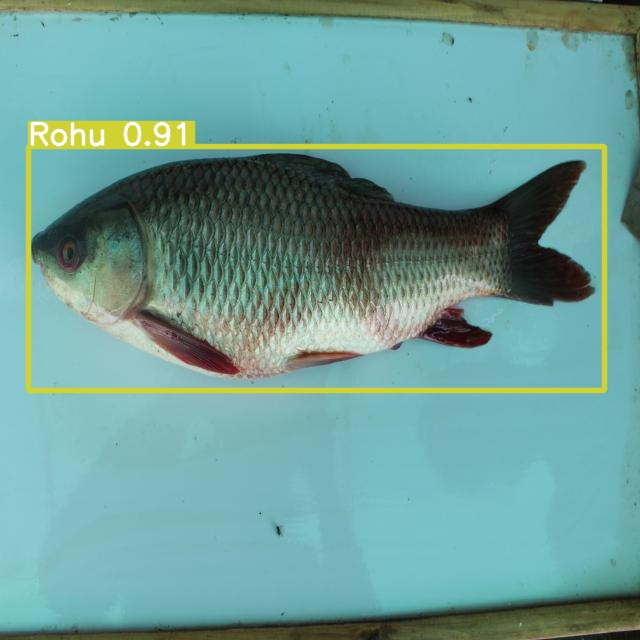

/content/yolov5/runs/detect/exp/006--146-_JPG.rf.91d29e6ed3bd66f5e55eeb2f64294e2c.jpg 

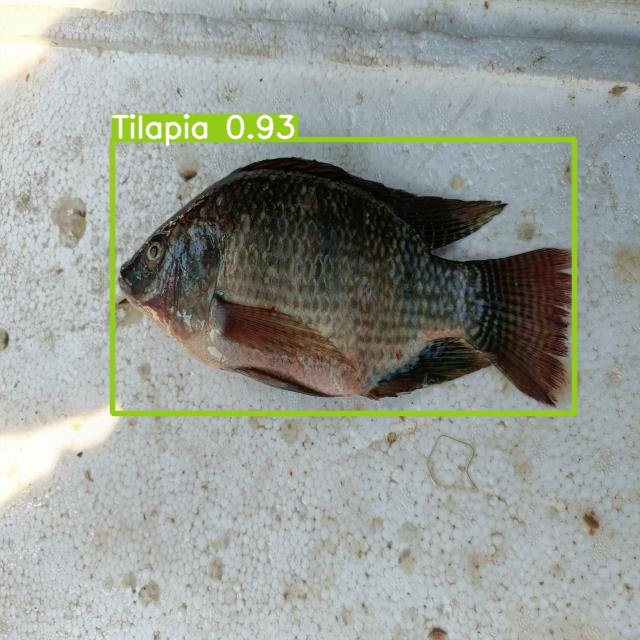

/content/yolov5/runs/detect/exp/008--128-_jpg.rf.e4869e68dd0fb6be1f53017f4c489f50.jpg 



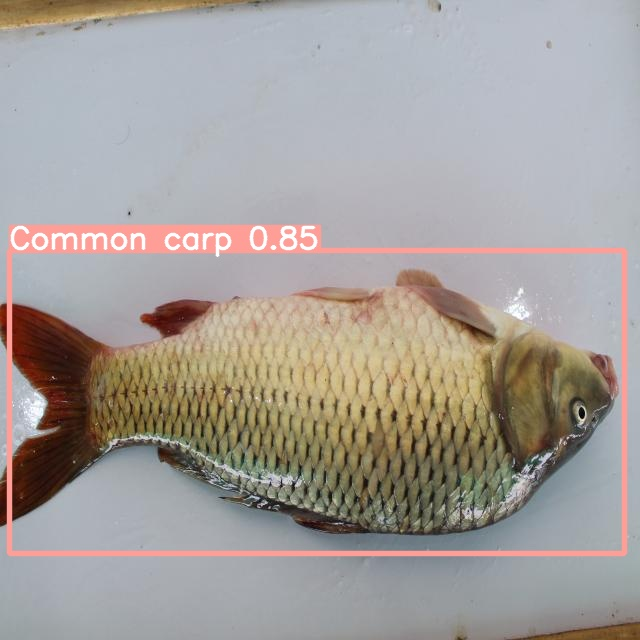

/content/yolov5/runs/detect/exp/002--9-_JPG.rf.75e94b5785f4c5361afc2da431b7c349.jpg 

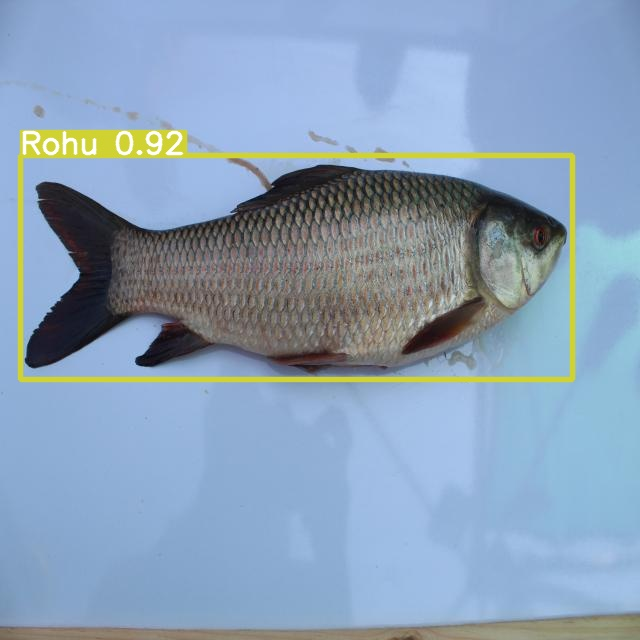

/content/yolov5/runs/detect/exp/006--81-_JPG.rf.64d497db538984bce05012dea8a5855a.jpg 

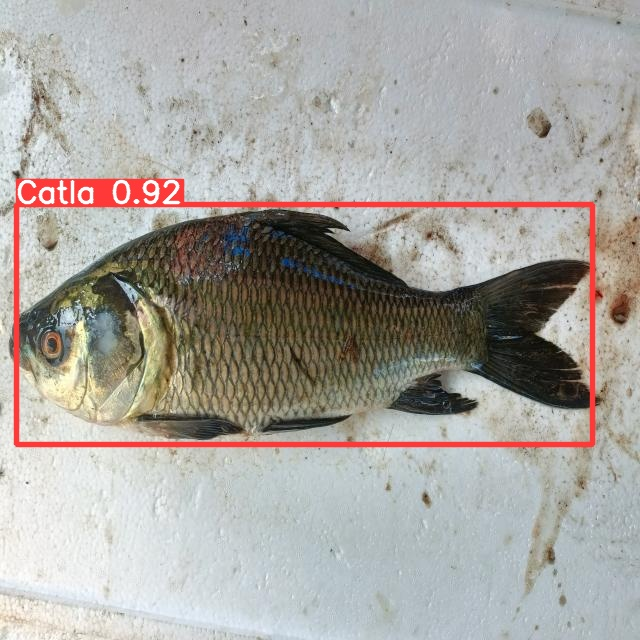

/content/yolov5/runs/detect/exp/001--174-_jpg.rf.5ab2894fe95de0470bea86dbb682071a.jpg 

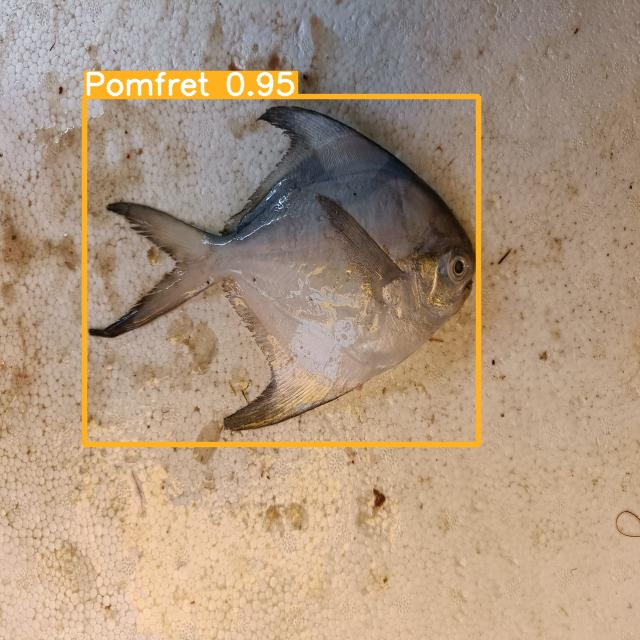

/content/yolov5/runs/detect/exp/005--109-_jpg.rf.96432053fe79b9c2cbbc490d3d2f1bb1.jpg 



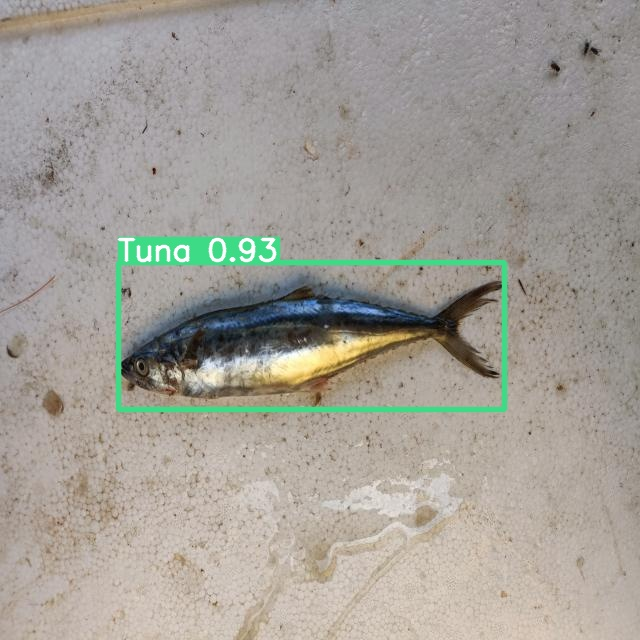

/content/yolov5/runs/detect/exp/009--56-_jpg.rf.1b92ea96239bf8d2e85571fef235e46d.jpg 

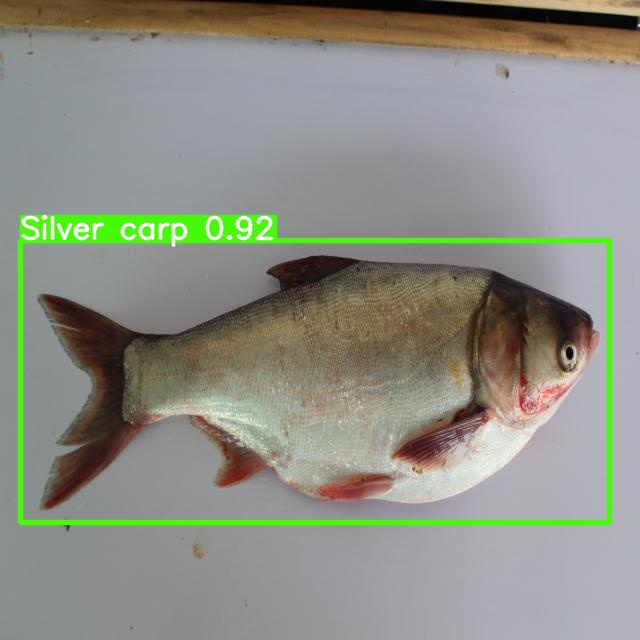

/content/yolov5/runs/detect/exp/007--46-_JPG.rf.71dcd7c20691e474ec064429db83f298.jpg 

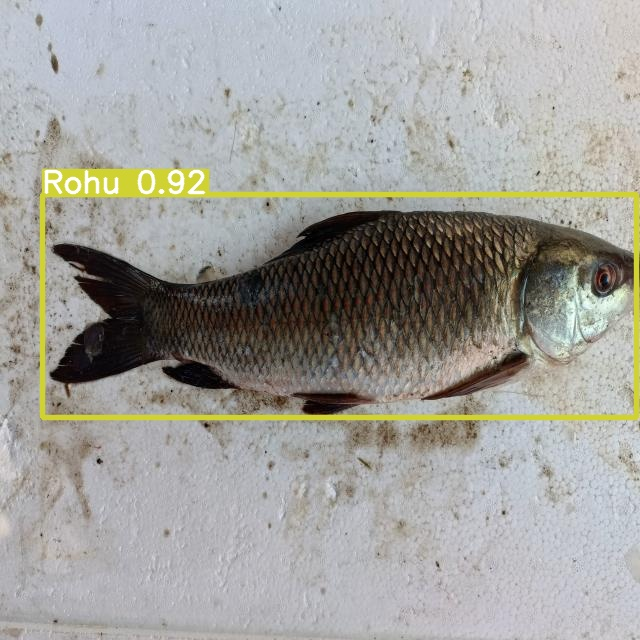

/content/yolov5/runs/detect/exp/006--76-_jpg.rf.9b3e495c342d6a7ea7a8c8358b71b593.jpg 

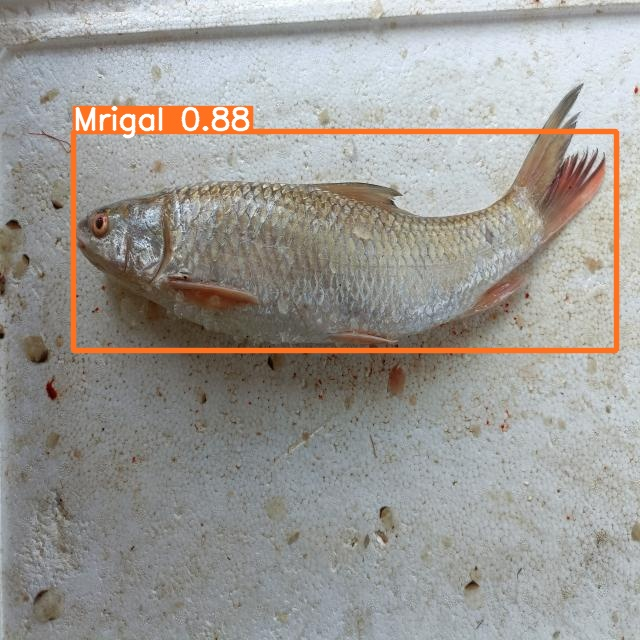

/content/yolov5/runs/detect/exp/004--61-_jpg.rf.41ee52d16ec2ceca518bac39ad706da4.jpg 



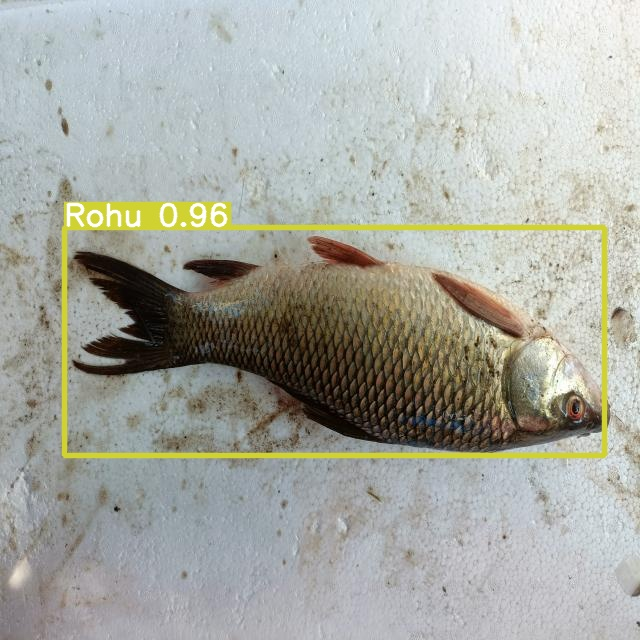

/content/yolov5/runs/detect/exp/006--73-_jpg.rf.442b1c9301c029525f148c28ef8290fa.jpg 

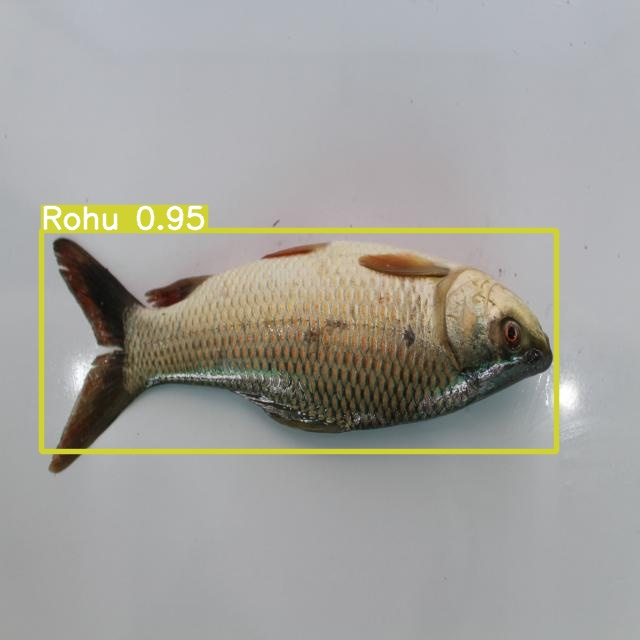

/content/yolov5/runs/detect/exp/006--110-_JPG.rf.1aa99d2d32ff4954bfc21ed605ea5058.jpg 

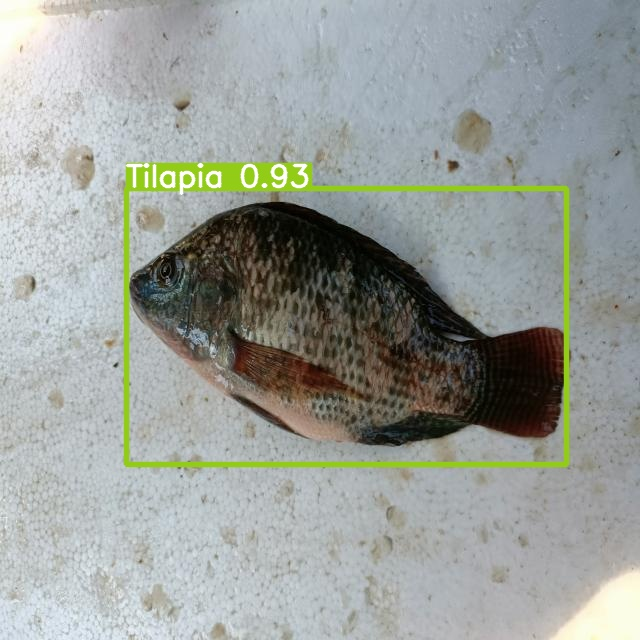

/content/yolov5/runs/detect/exp/008--100-_jpg.rf.d37ecc84a90c9b7b0e2afada6ea555a7.jpg 

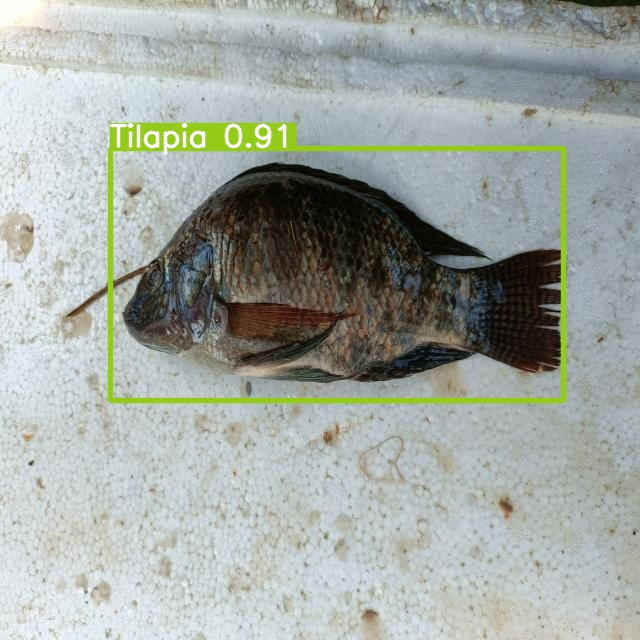

/content/yolov5/runs/detect/exp/008--124-_jpg.rf.2e10deba4ac47c599ef62a423967a0b4.jpg 



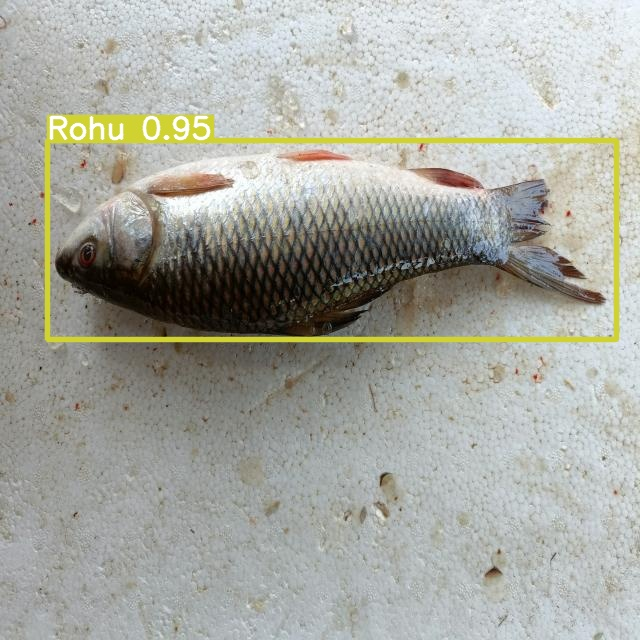

/content/yolov5/runs/detect/exp/004--66-_jpg.rf.3dedba76e9302fa24ea06c1af94424af.jpg 

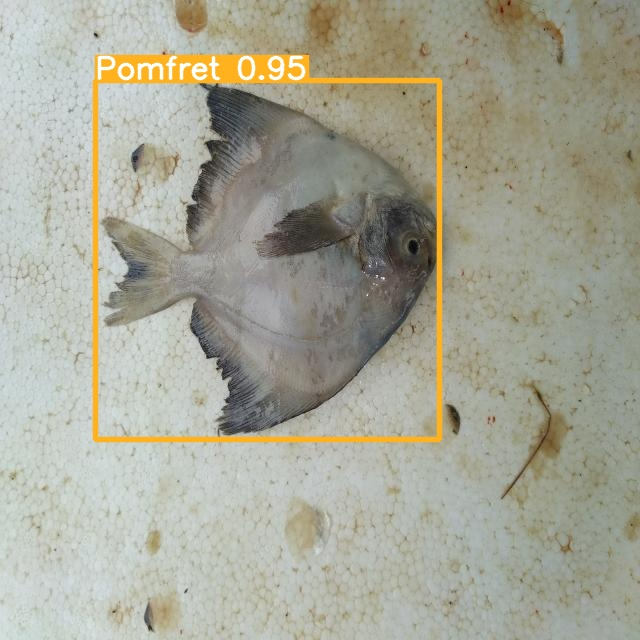

/content/yolov5/runs/detect/exp/IMG_20220909_102033_jpg.rf.e9f1ef47429199ecd839eb3803df1bf5.jpg 

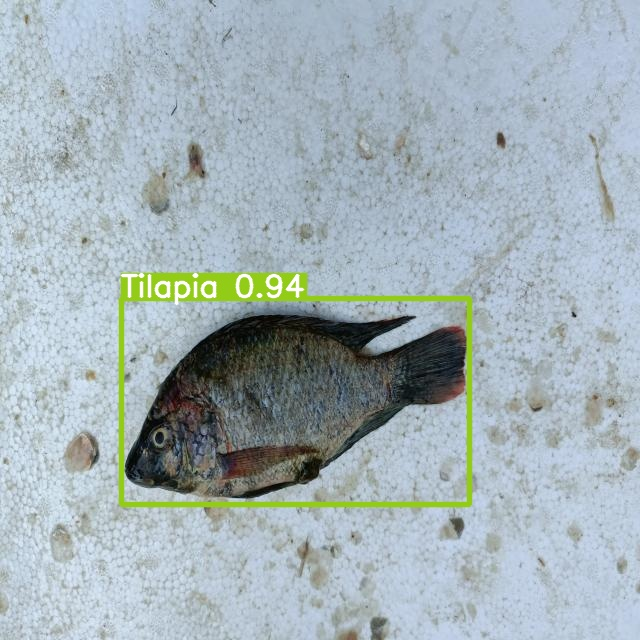

/content/yolov5/runs/detect/exp/008--20-_jpg.rf.a0048d94ef4d4bd2aae54521b192e2b5.jpg 

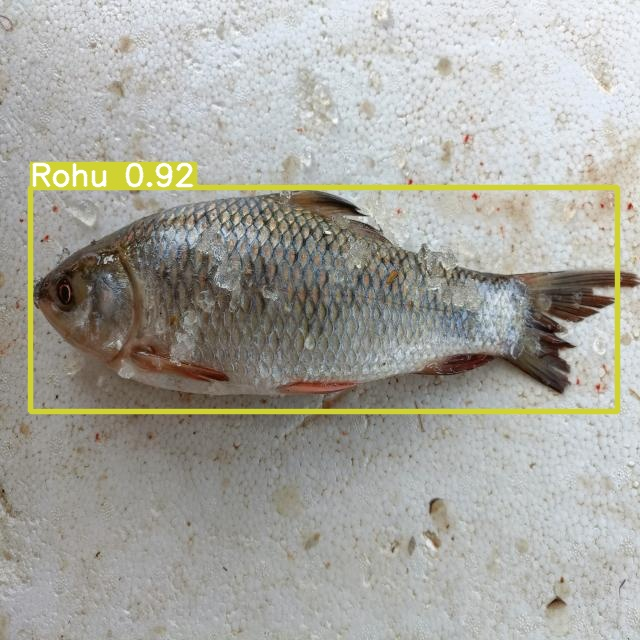

/content/yolov5/runs/detect/exp/004--65-_jpg.rf.0e5b930642eaf5901bfa1950569891c1.jpg 



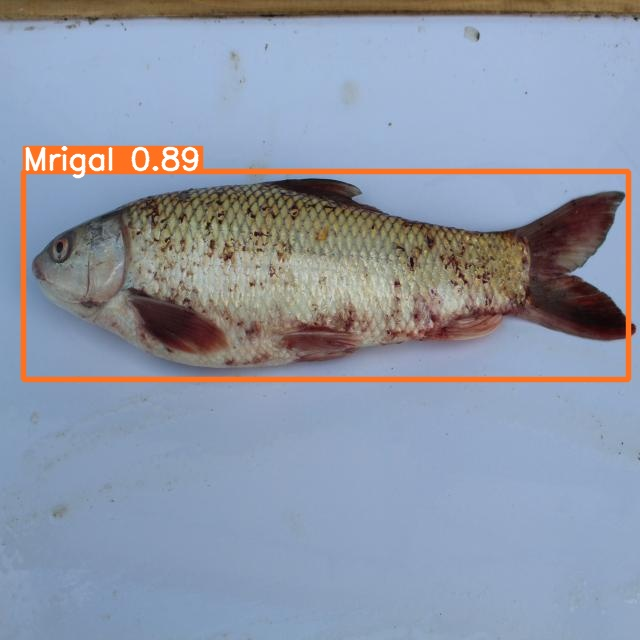

/content/yolov5/runs/detect/exp/004--9-_JPG.rf.62aa7d0027fe688f0e8d908e01e369e9.jpg 

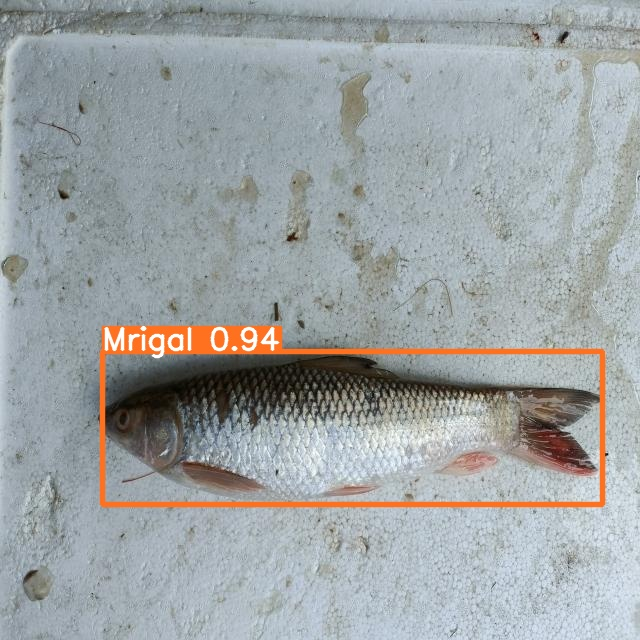

/content/yolov5/runs/detect/exp/004--25-_jpg.rf.1267942010da7747bc351a3c35f275b0.jpg 

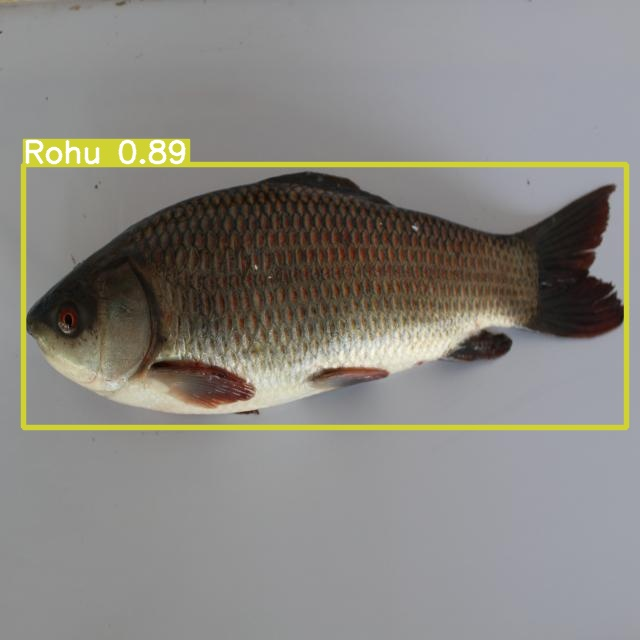

/content/yolov5/runs/detect/exp/006--104-_JPG.rf.4033fb3608e085ae0de3bc05772850ae.jpg 

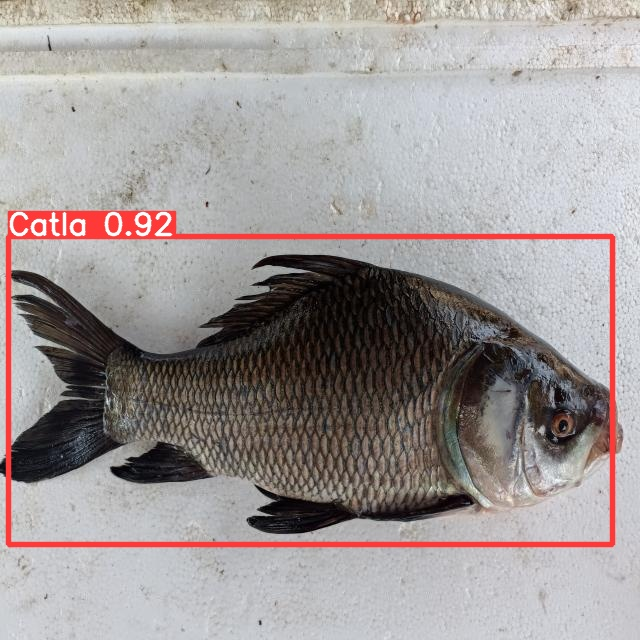

/content/yolov5/runs/detect/exp/001--184-_jpg.rf.0fc630eee4774b808f97b3a3d8e351ba.jpg 



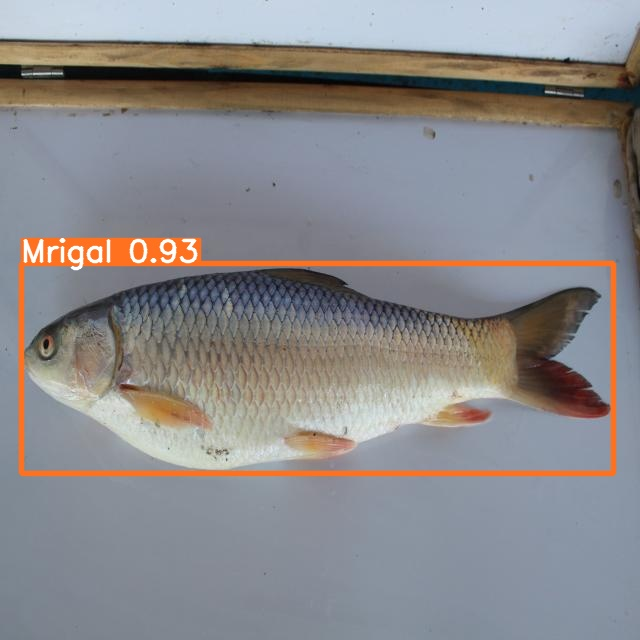

/content/yolov5/runs/detect/exp/004--87-_JPG.rf.ca1b291cfcb78c9d9dbb790c2eeccdfd.jpg 

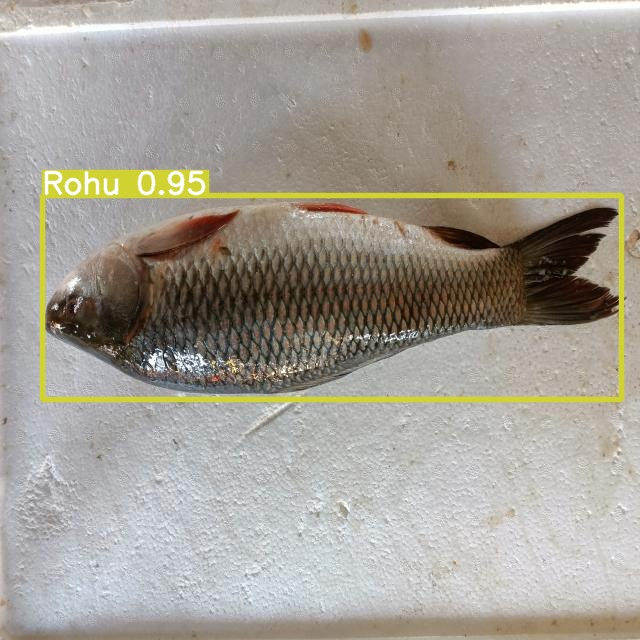

/content/yolov5/runs/detect/exp/006--18-_jpg.rf.a8194e460611825eb99ac77adc331535.jpg 

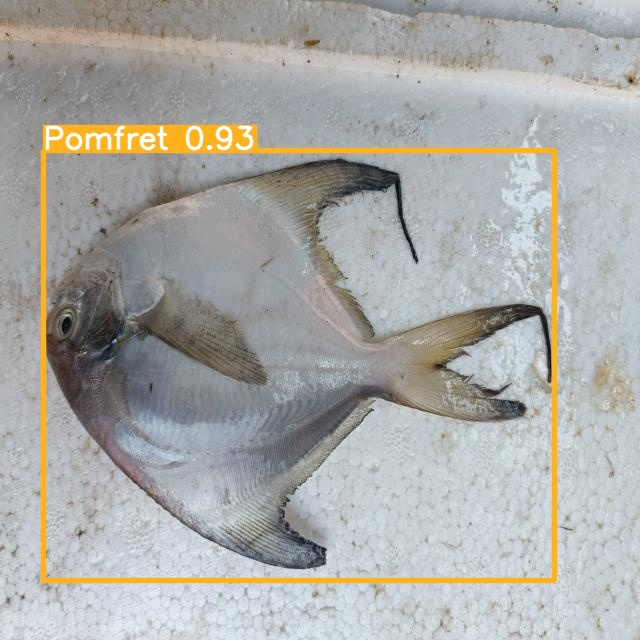

/content/yolov5/runs/detect/exp/005--49-_jpg.rf.47ce64835daba70c5dc21309e7ab54f1.jpg 

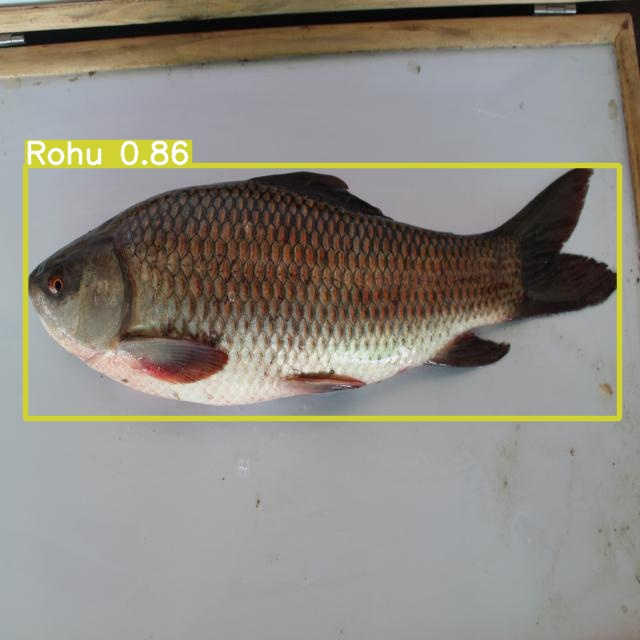

/content/yolov5/runs/detect/exp/006--95-_JPG.rf.f02ac8ce69fdd42a0a74fa2c457f5a94.jpg 



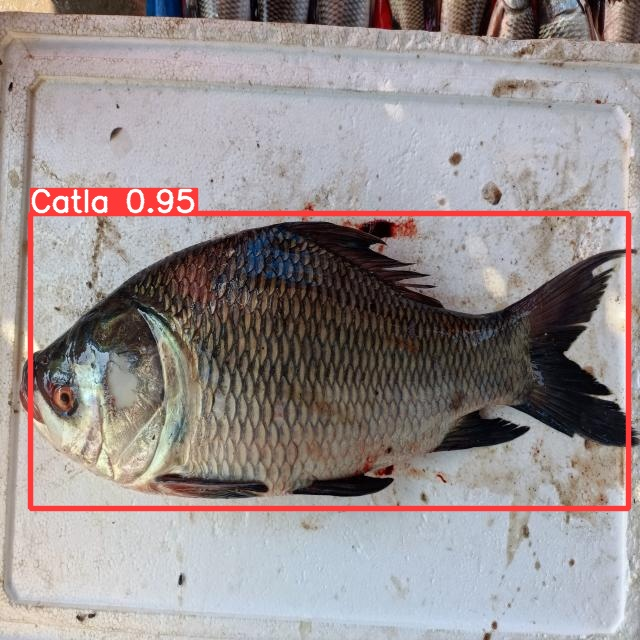

/content/yolov5/runs/detect/exp/001--182-_jpg.rf.8084361c01facbd9320160ecf7d63279.jpg 

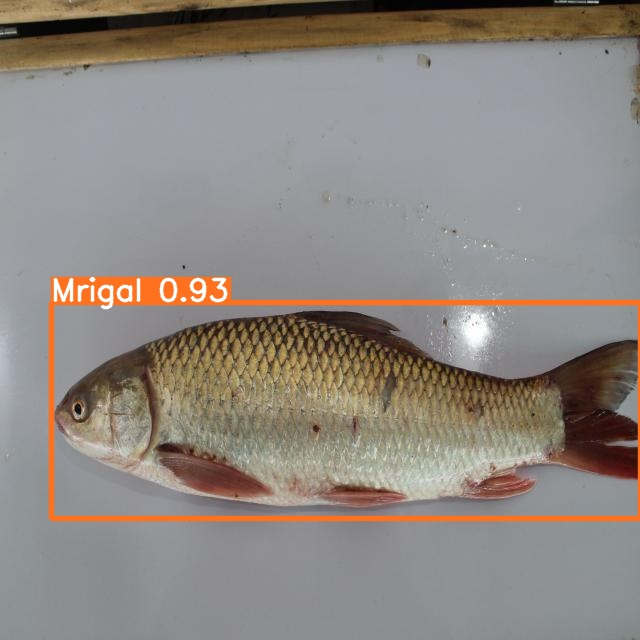

/content/yolov5/runs/detect/exp/004--130-_JPG.rf.e720454b14c8e389435f63720d6908b8.jpg 

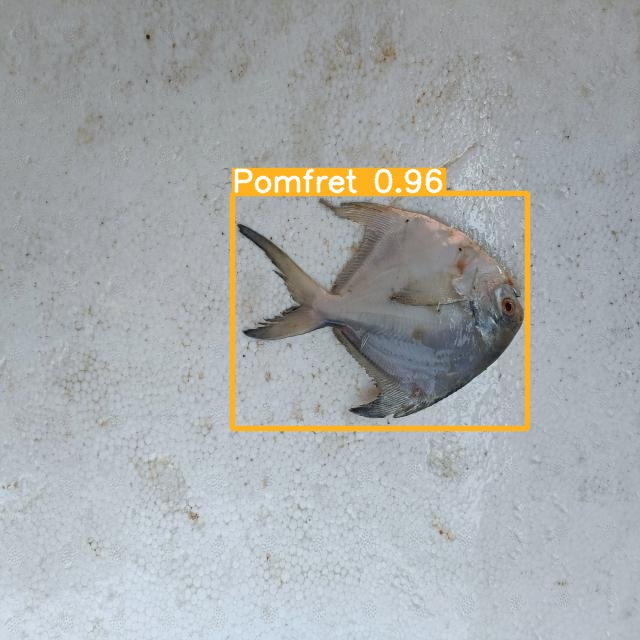

/content/yolov5/runs/detect/exp/005--13-_jpg.rf.86326dd388b5bec241c01f8f5a62273d.jpg 

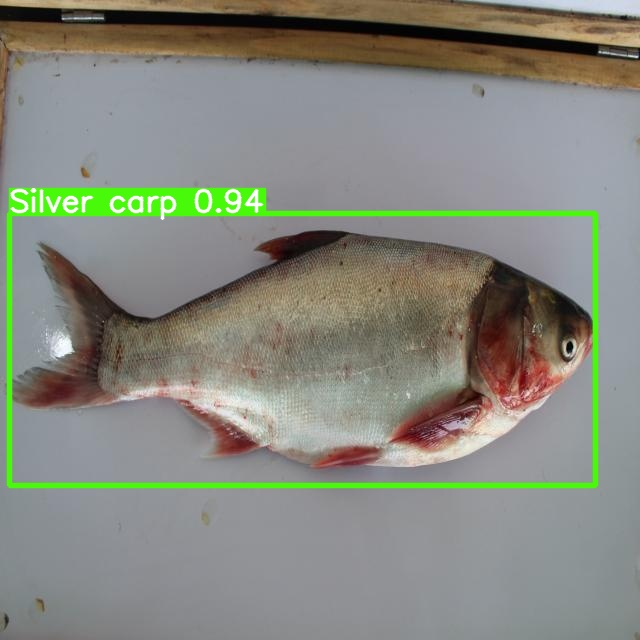

/content/yolov5/runs/detect/exp/007--14-_JPG.rf.e44c7ca96b09156bfbd2ee6d1756aea2.jpg 



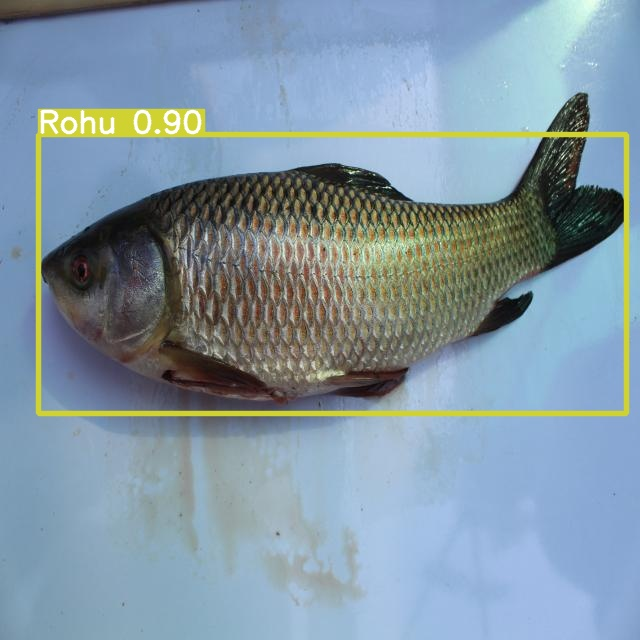

/content/yolov5/runs/detect/exp/006--82-_JPG.rf.2cef30f3424a195ac3dbc7cf63eb8372.jpg 

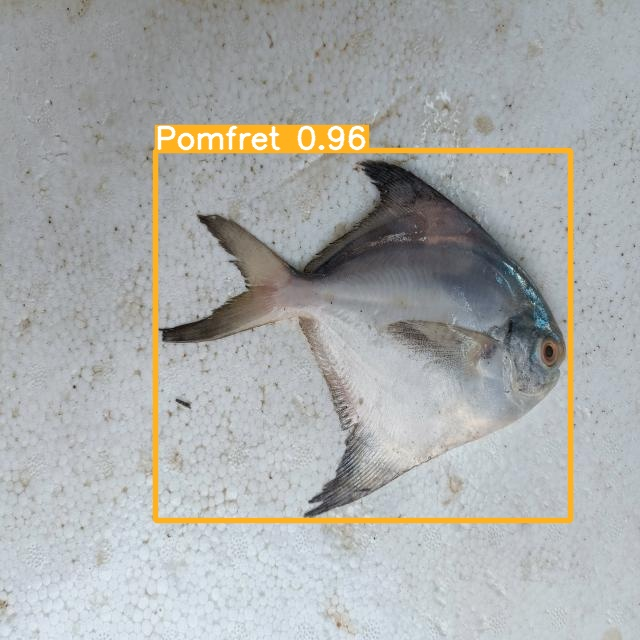

/content/yolov5/runs/detect/exp/005--35-_jpg.rf.465bd21262062c959fb6ba7434ec56fc.jpg 

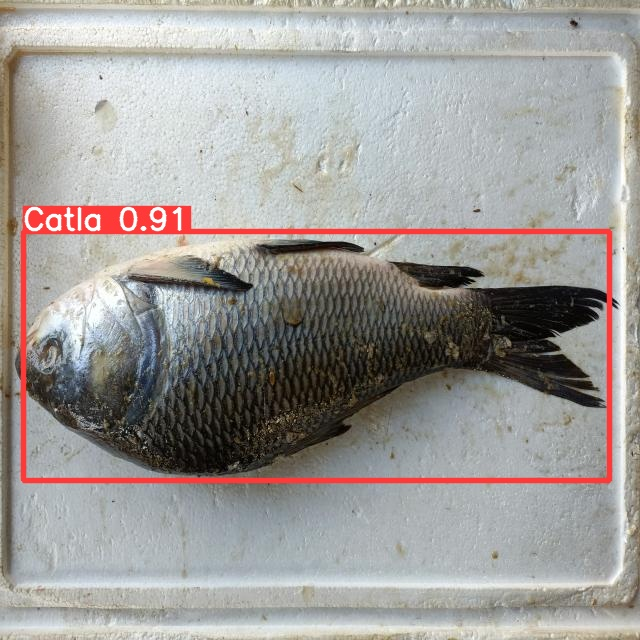

/content/yolov5/runs/detect/exp/001--168-_jpg.rf.d46bfbe52558357bf7a2fb6a6278102b.jpg 

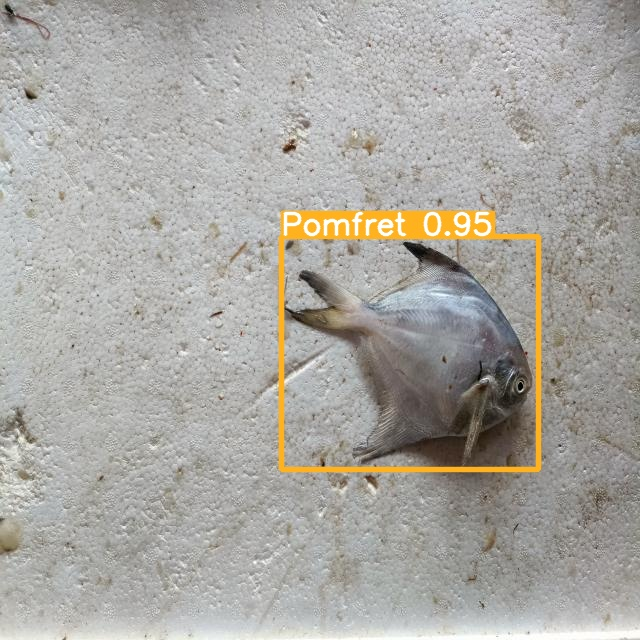

/content/yolov5/runs/detect/exp/005--139-_jpg.rf.1a4a2e7688de4b478b0d613a242c8ce7.jpg 



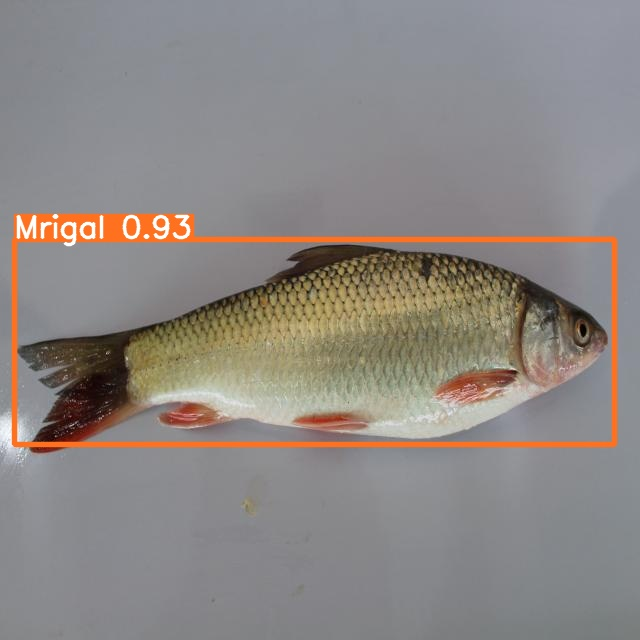

/content/yolov5/runs/detect/exp/004--105-_JPG.rf.c6ef05e6daa58ccaa2a8d4e7d47fc659.jpg 

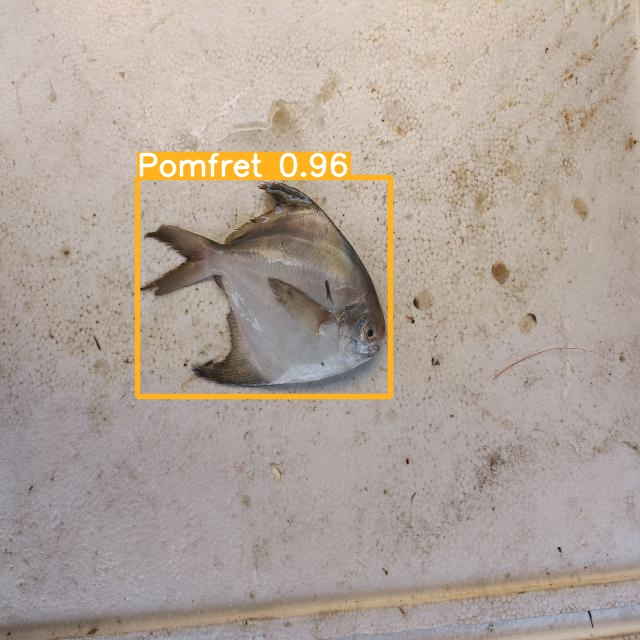

/content/yolov5/runs/detect/exp/005--71-_jpg.rf.e2f6362b97515219c6db6b5617a84428.jpg 

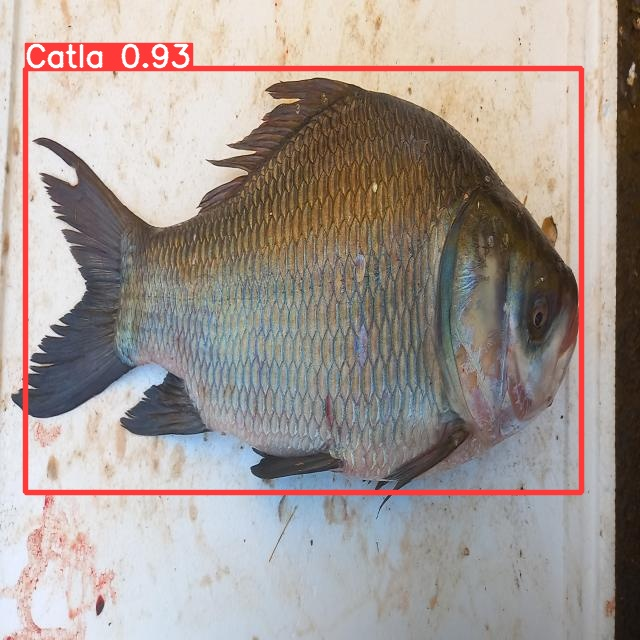

/content/yolov5/runs/detect/exp/001--85-_jpg.rf.9c306265862628354fe79e7b8b06db2e.jpg 

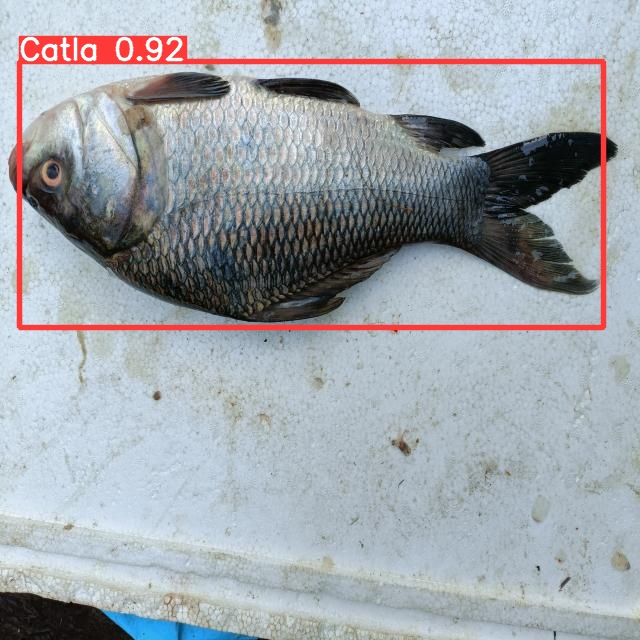

/content/yolov5/runs/detect/exp/001--13-_jpg.rf.5c73ec96cecb084a921ffa300c330cc7.jpg 



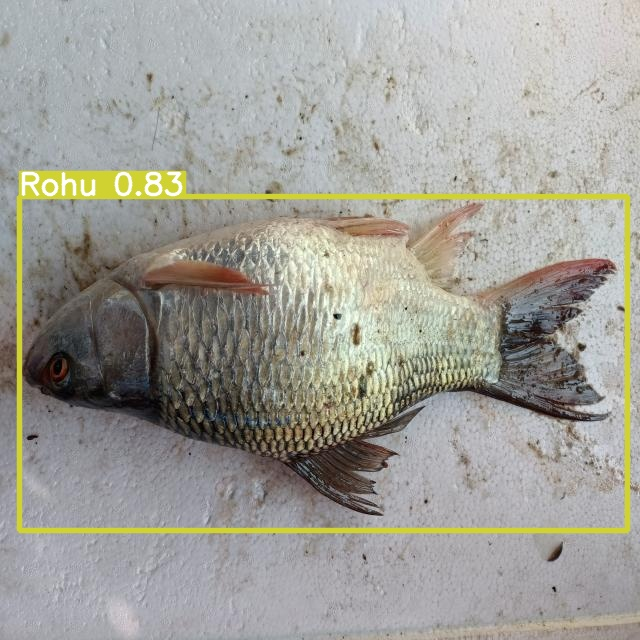

/content/yolov5/runs/detect/exp/001--170-_jpg.rf.1a9e487741cf926b0bffb099993e28f9.jpg 

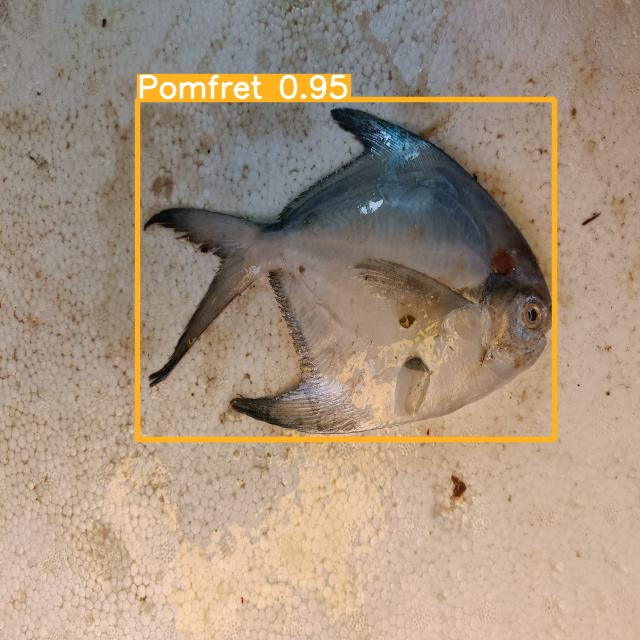

/content/yolov5/runs/detect/exp/005--89-_jpg.rf.b80bfb99d0770a0819531da23842d5ec.jpg 

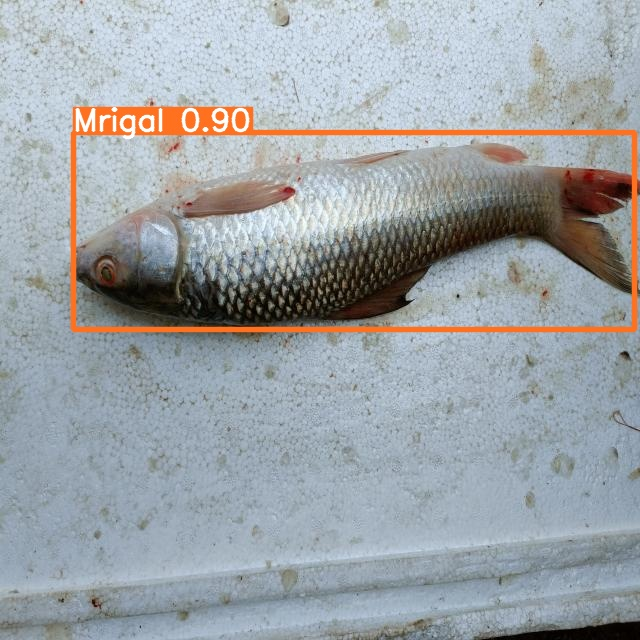

/content/yolov5/runs/detect/exp/004--51-_jpg.rf.b9e1e681c9a1f340a1bc96fa99797a90.jpg 

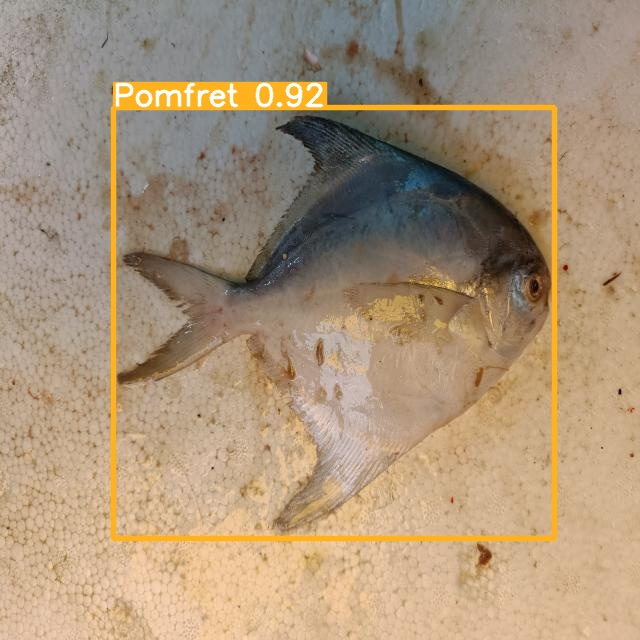

/content/yolov5/runs/detect/exp/005--93-_jpg.rf.b8a2f98680100ce8183033d867f01409.jpg 



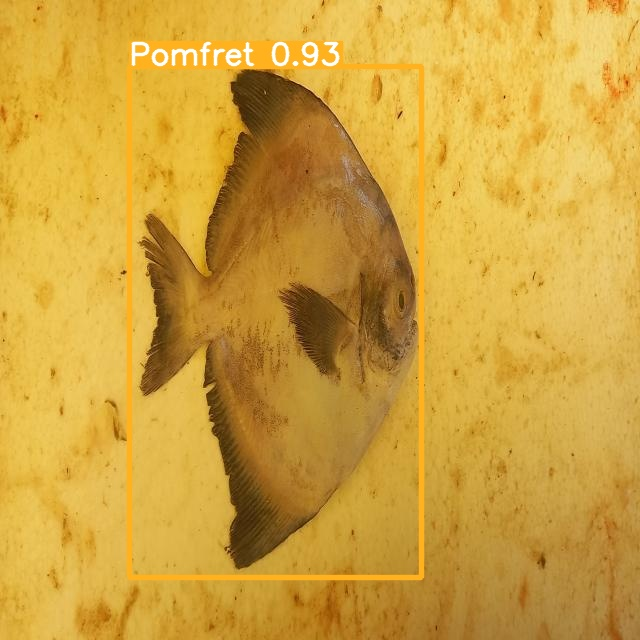

/content/yolov5/runs/detect/exp/005--188-_jpg.rf.11cc33e0f354bec8c891480cfca9a7dc.jpg 

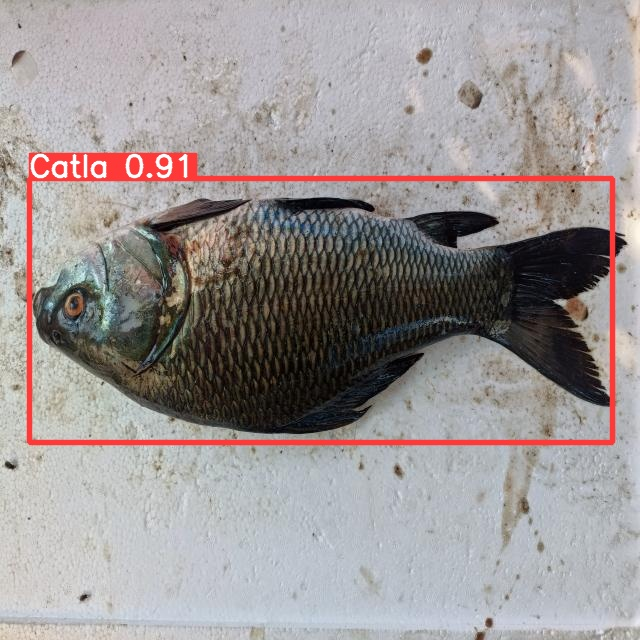

/content/yolov5/runs/detect/exp/001--176-_jpg.rf.e61d5f9e99f70f6c0933b47c733f525b.jpg 

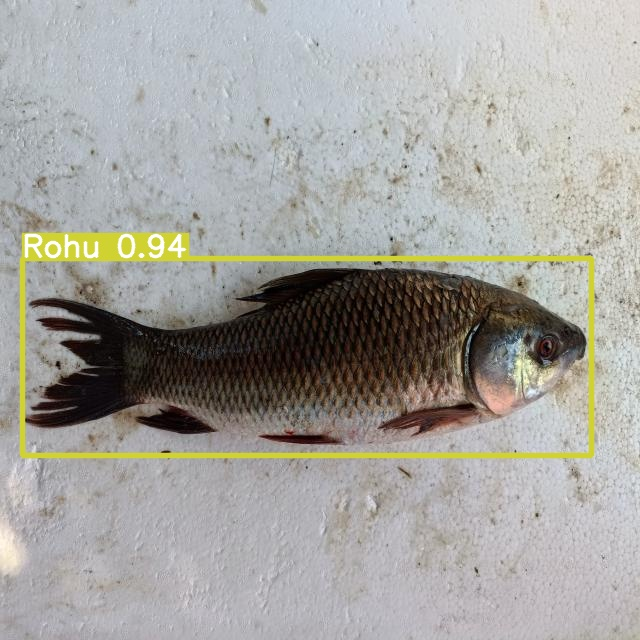

/content/yolov5/runs/detect/exp/006--49-_jpg.rf.63d9dceb887d33c7867e0061c4bae647.jpg 

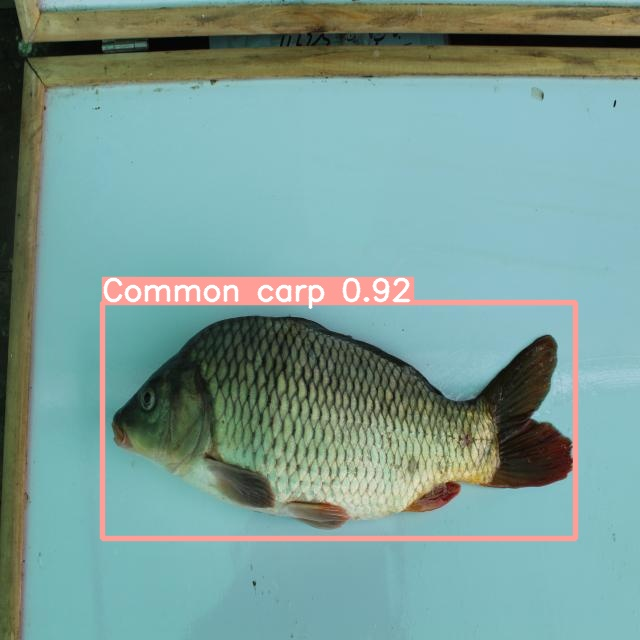

/content/yolov5/runs/detect/exp/002--28-_JPG.rf.813b5e9db3cc79dbdfe48d6b96ca4069.jpg 



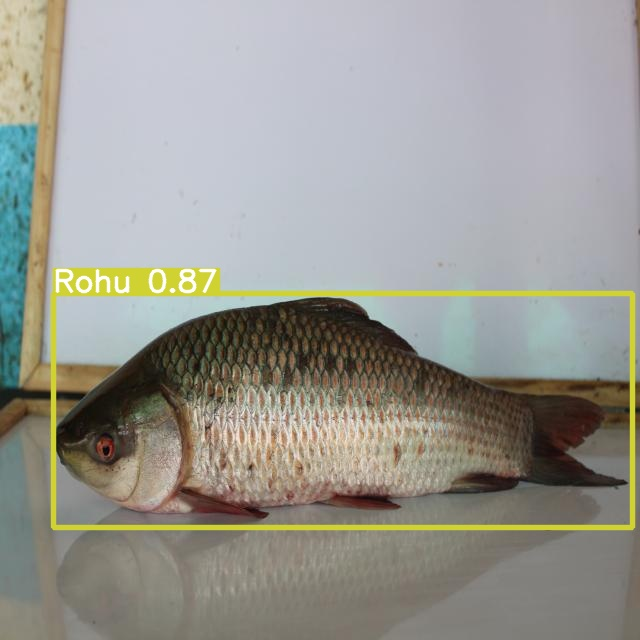

/content/yolov5/runs/detect/exp/006--98-_JPG.rf.48b28bed0ae6429dbe0ff3b62ff24807.jpg 

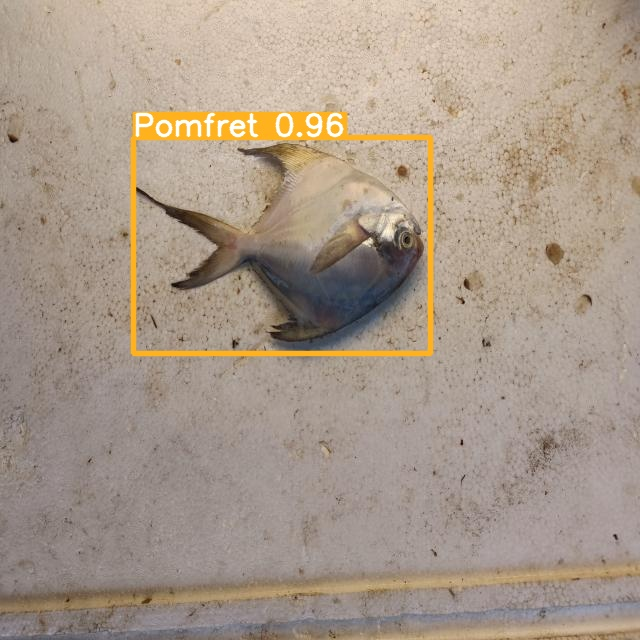

/content/yolov5/runs/detect/exp/005--60-_jpg.rf.284ce0a77c0314ef27e42f7fee572204.jpg 

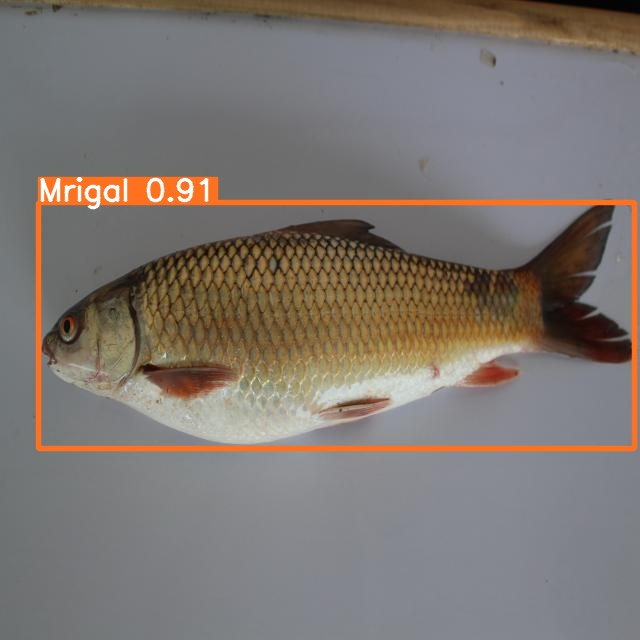

/content/yolov5/runs/detect/exp/004--112-_JPG.rf.951759b192e4e9a8000b822df27e5e73.jpg 

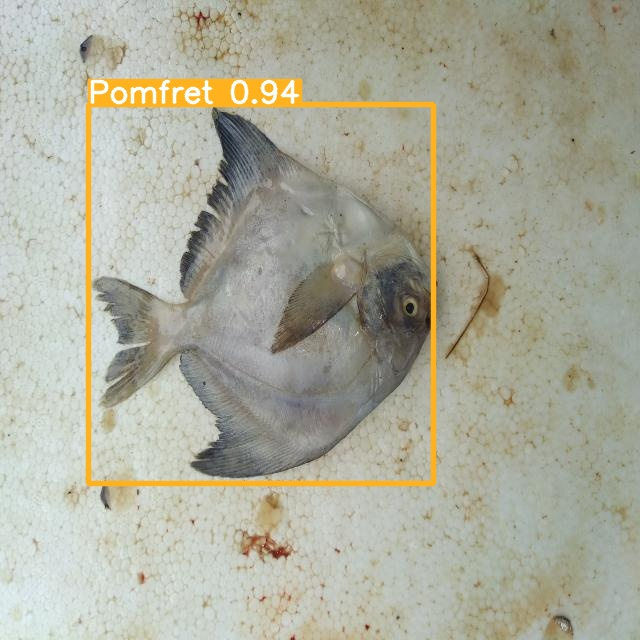

/content/yolov5/runs/detect/exp/IMG_20220909_102011_jpg.rf.ca68e66f293a695da57887f545786def.jpg 



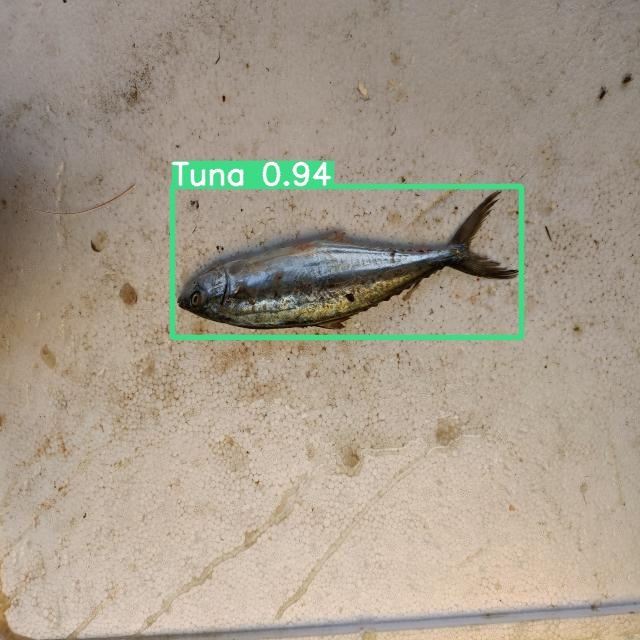

/content/yolov5/runs/detect/exp/009--62-_jpg.rf.88f87293a7a974758e63ff4035df6886.jpg 

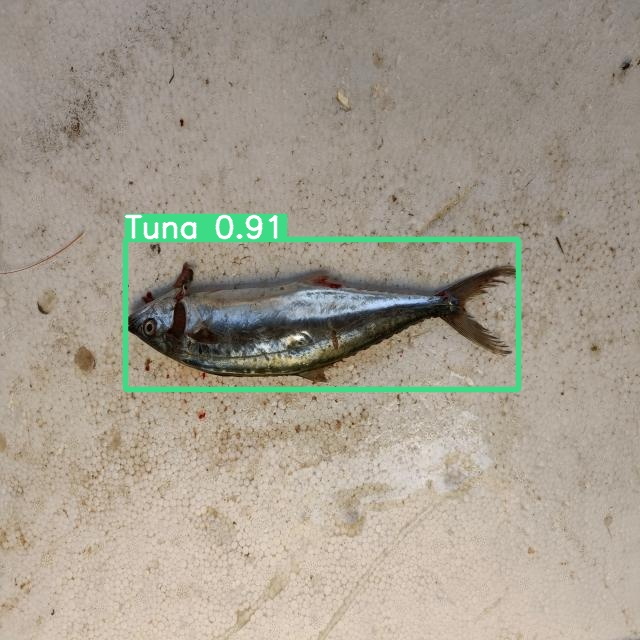

/content/yolov5/runs/detect/exp/009--71-_jpg.rf.42108a98651fecd9c91850300692303e.jpg 

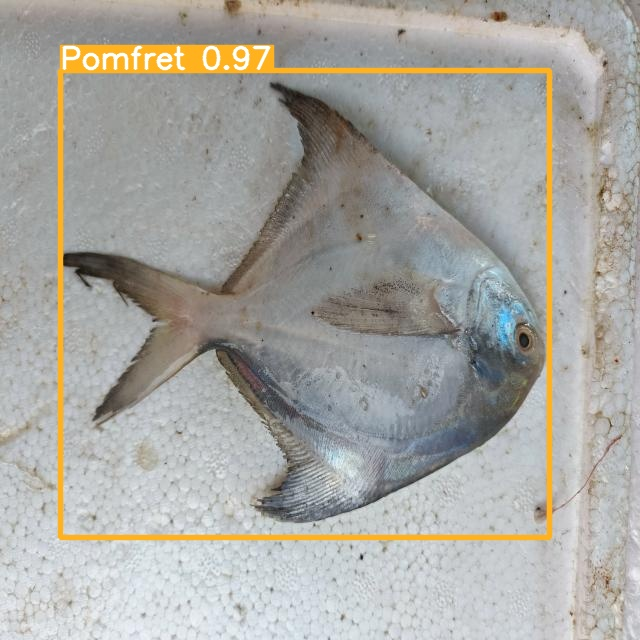

/content/yolov5/runs/detect/exp/005--39-_jpg.rf.d1ebe5a23f5b98e5dada59f4fcd1d1d7.jpg 

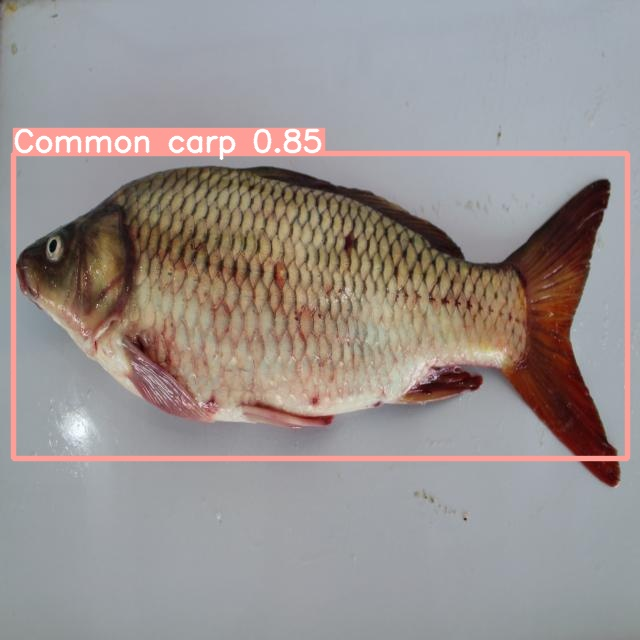

/content/yolov5/runs/detect/exp/002--10-_JPG.rf.bce67d2ec5f7e6fc7b9196c67041127f.jpg 



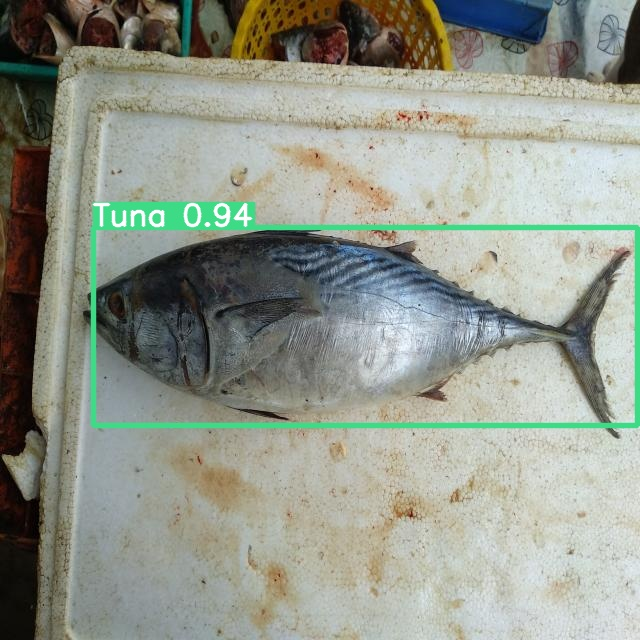

/content/yolov5/runs/detect/exp/009--16-_jpg.rf.bc7963947a3b1c5bc0a66df05e5d5171.jpg 

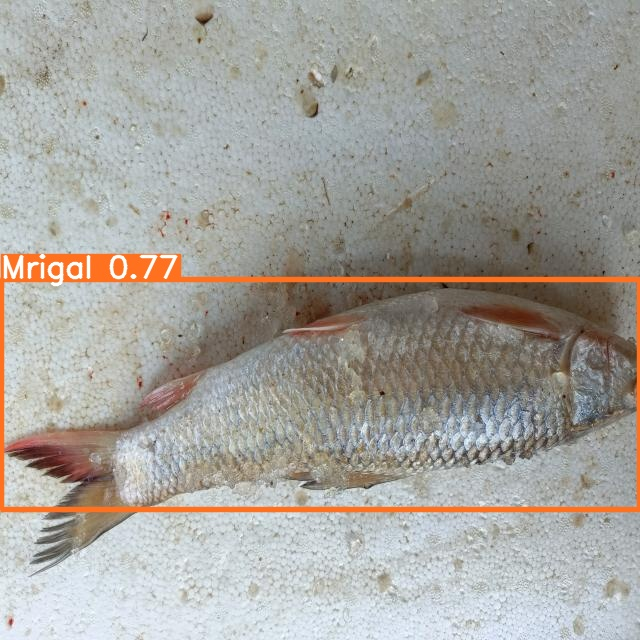

/content/yolov5/runs/detect/exp/004--67-_jpg.rf.7240f485591603b4c194237992ca8e3f.jpg 

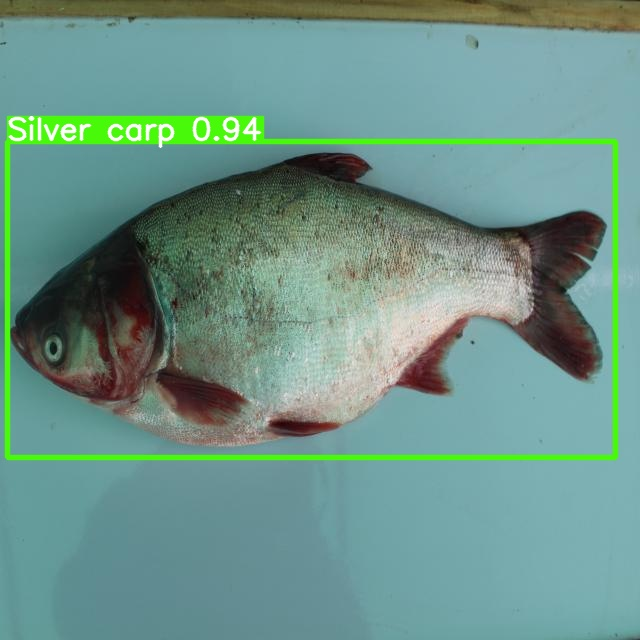

/content/yolov5/runs/detect/exp/007--74-_JPG.rf.39719db5f23322508af860d10de2fd1d.jpg 

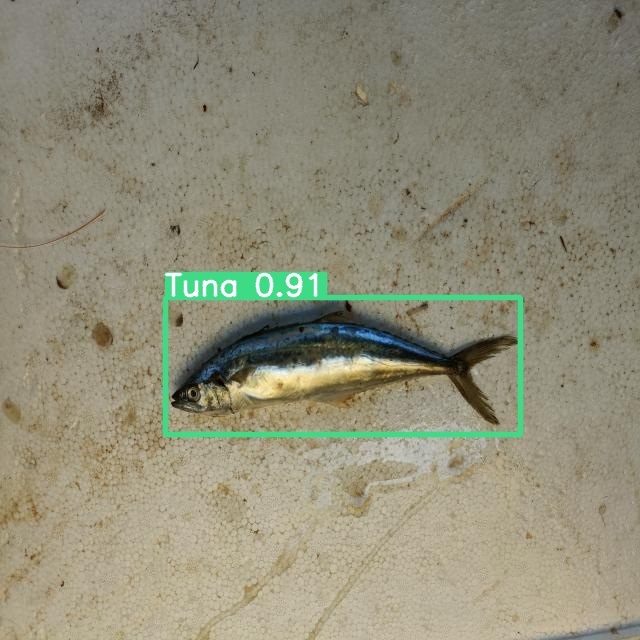

/content/yolov5/runs/detect/exp/009--66-_jpg.rf.a654f817d084fad26fd4e294f9857fa7.jpg 



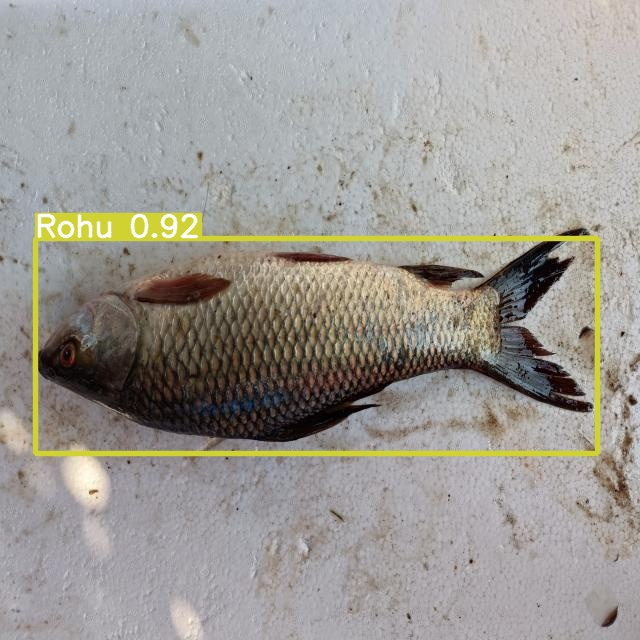

/content/yolov5/runs/detect/exp/006--42-_jpg.rf.83f21367607949b548c417ee60d1ee21.jpg 

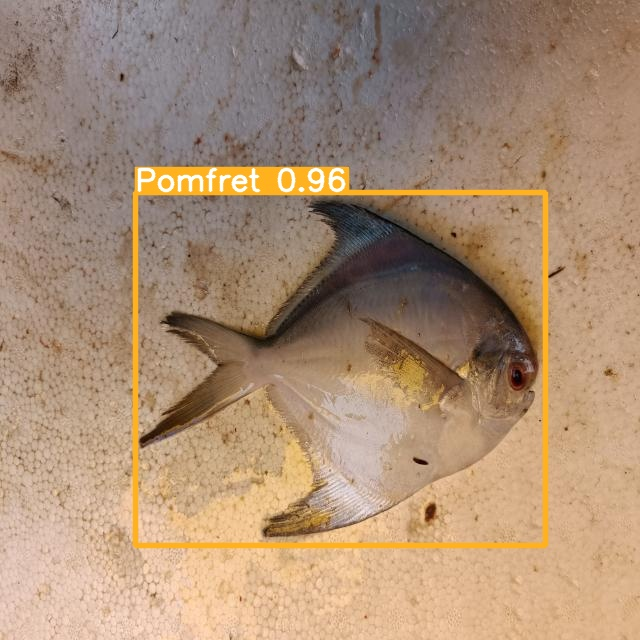

/content/yolov5/runs/detect/exp/005--82-_jpg.rf.37156c35802d943cebdd3722d78854e0.jpg 

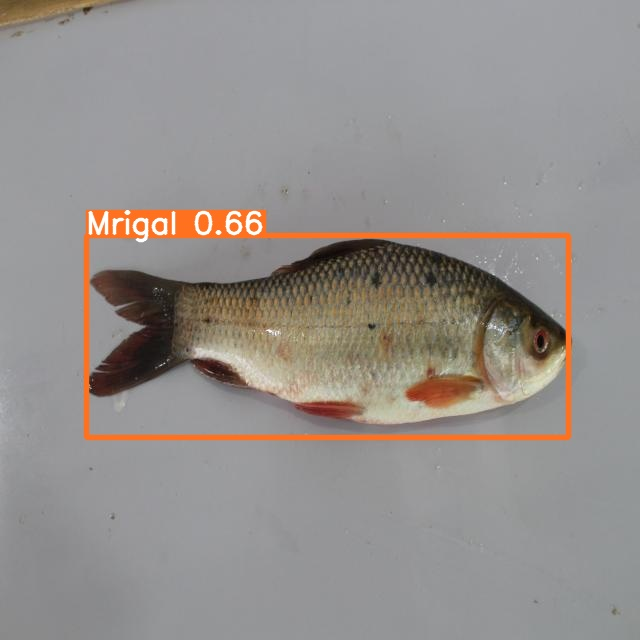

/content/yolov5/runs/detect/exp/006--135-_JPG.rf.b1743ebb84930a9a4bb2201df35541c3.jpg 

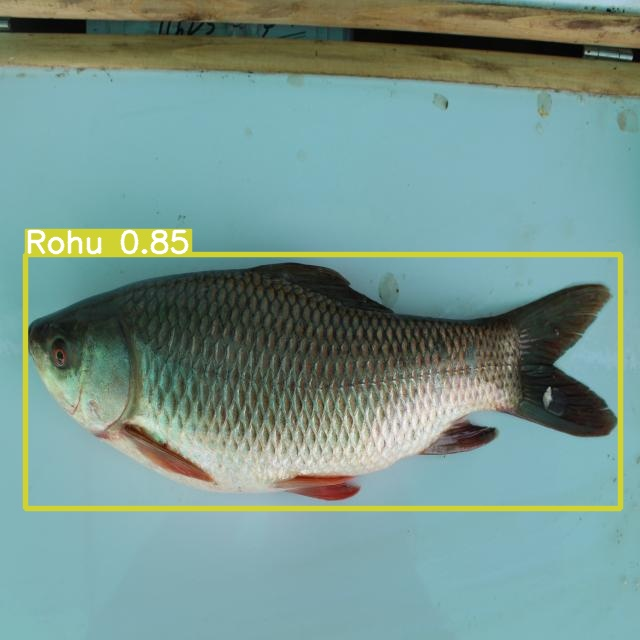

/content/yolov5/runs/detect/exp/006--147-_JPG.rf.df9c88da48f0770acfebfe1e57d28224.jpg 



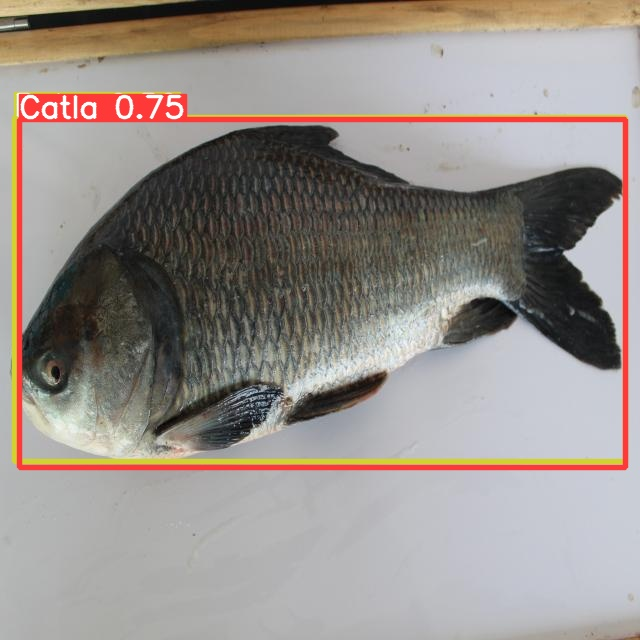

/content/yolov5/runs/detect/exp/001--111-_JPG.rf.493bbe408e85146ff4ed078f2c4321b8.jpg 

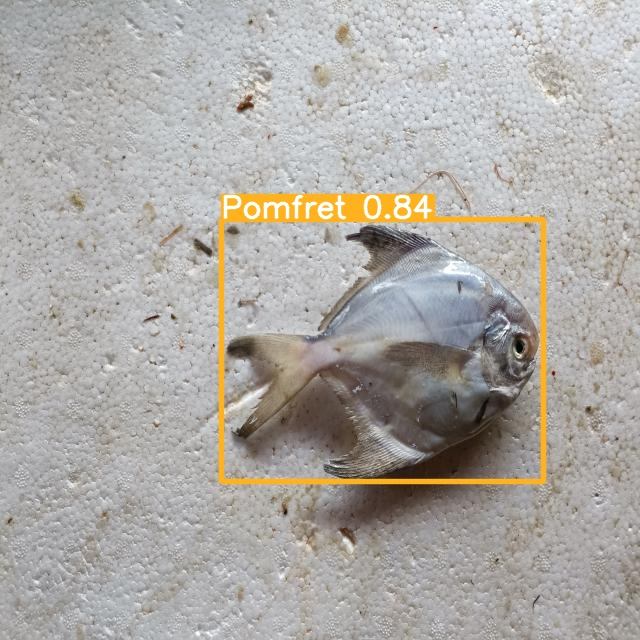

/content/yolov5/runs/detect/exp/005--164-_jpg.rf.7e42b9eb0acdb1521105941720cda7e8.jpg 

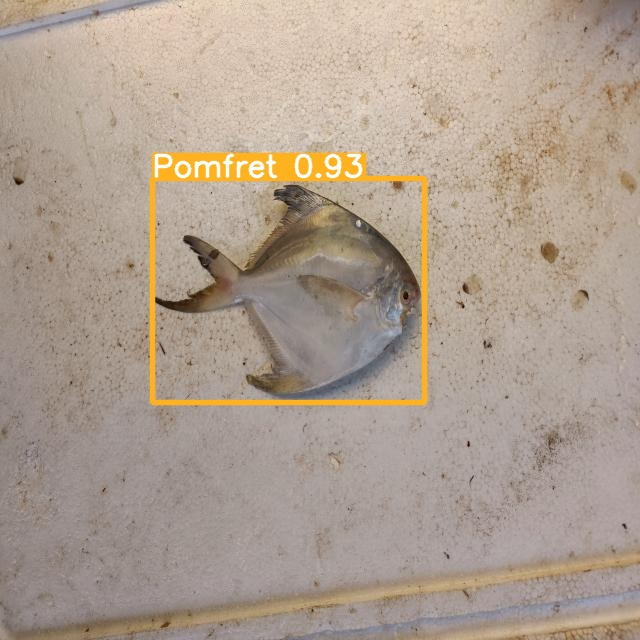

/content/yolov5/runs/detect/exp/005--58-_jpg.rf.4fbea8625870de0ac4ba34e0ffe57b44.jpg 

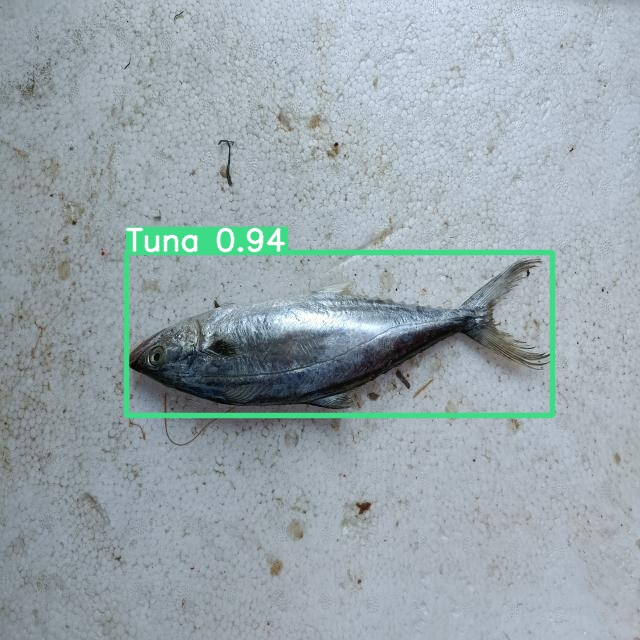

/content/yolov5/runs/detect/exp/009--6-_jpg.rf.7f91e6057b3e92f771e2fb803d7c0f8b.jpg 



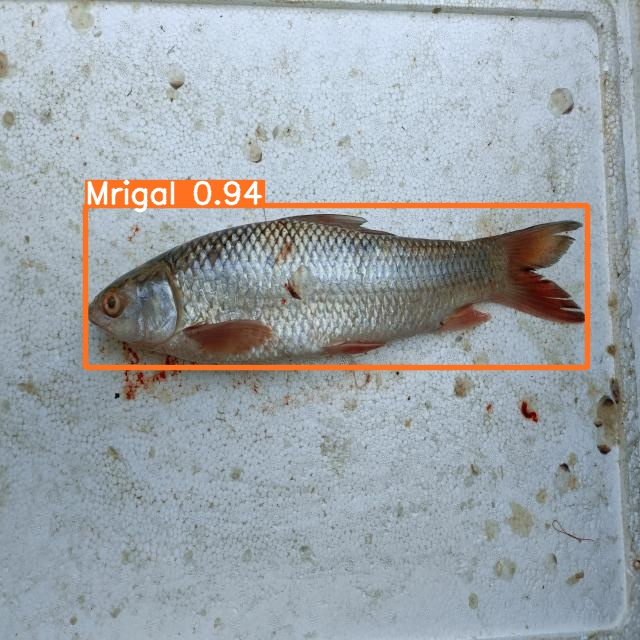

/content/yolov5/runs/detect/exp/004--48-_jpg.rf.23477b2d57b85b0d9c5fd73b7b4e6e26.jpg 

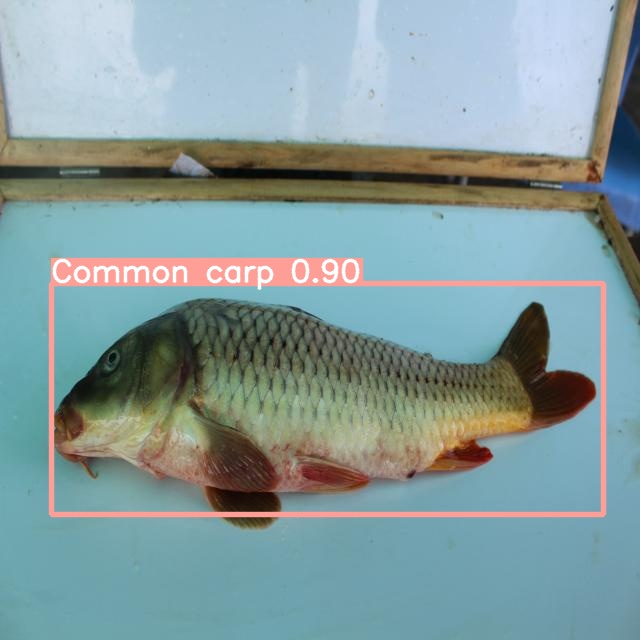

/content/yolov5/runs/detect/exp/002--30-_JPG.rf.f4c227b725d440183876eb16742ab209.jpg 

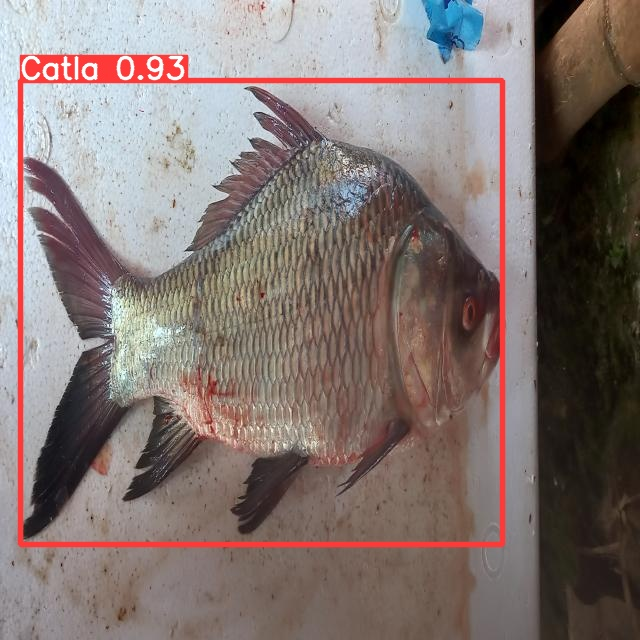

/content/yolov5/runs/detect/exp/001--44-_jpg.rf.66f2cf4a5a3621c3704aca4dd1e0698e.jpg 

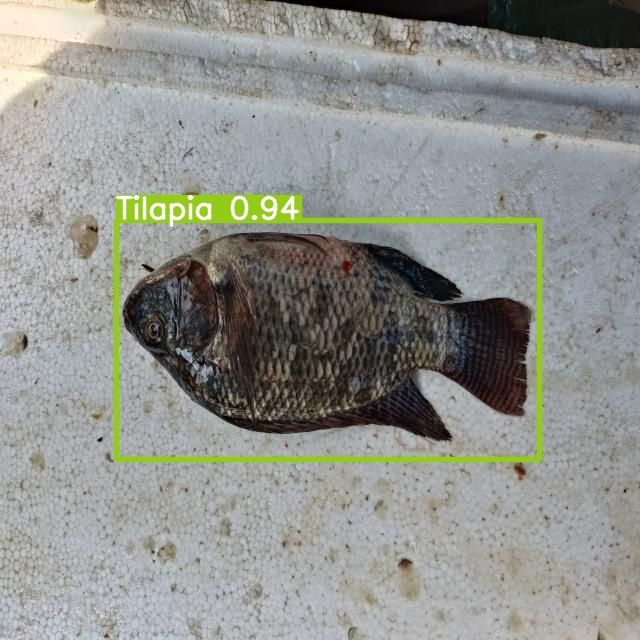

/content/yolov5/runs/detect/exp/008--118-_jpg.rf.81328b5e74e5f791c7a0b5e99d4648d8.jpg 



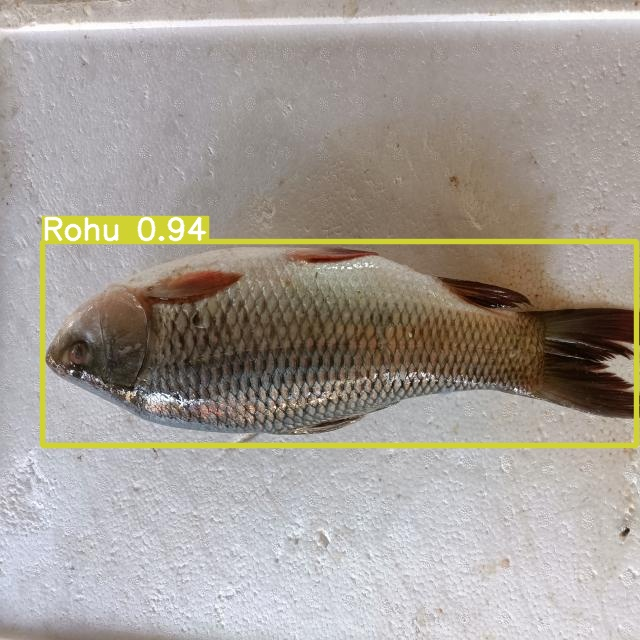

/content/yolov5/runs/detect/exp/006--13-_jpg.rf.b38e111d1e11c50f7bc3ef26ce425e6b.jpg 

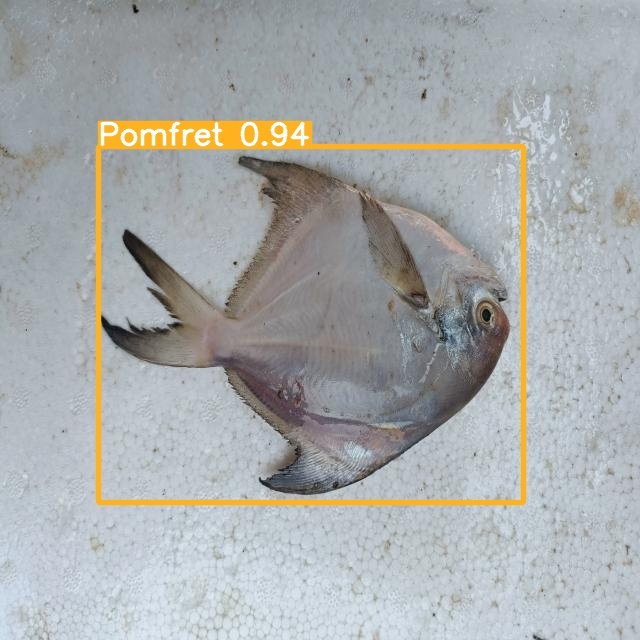

/content/yolov5/runs/detect/exp/005--34-_jpg.rf.6941ec2dadc9a3e6dbb8844ec34b1b8d.jpg 

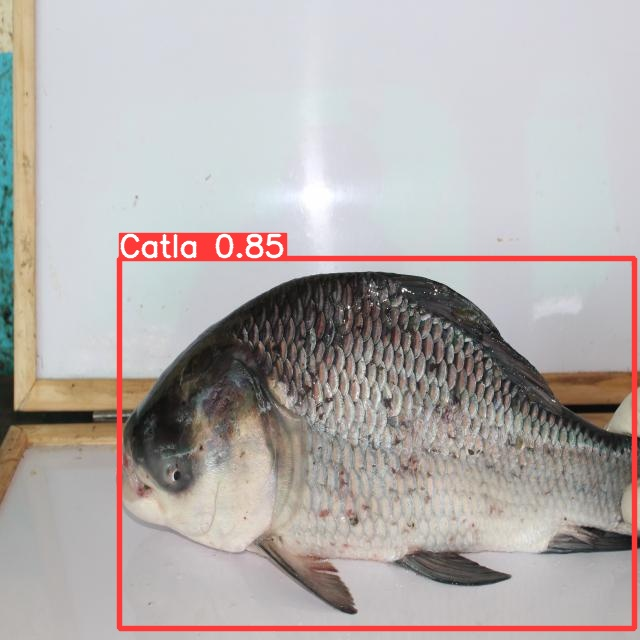

/content/yolov5/runs/detect/exp/001--107-_JPG.rf.4cfddef3520eab1206949c58ca214f4c.jpg 

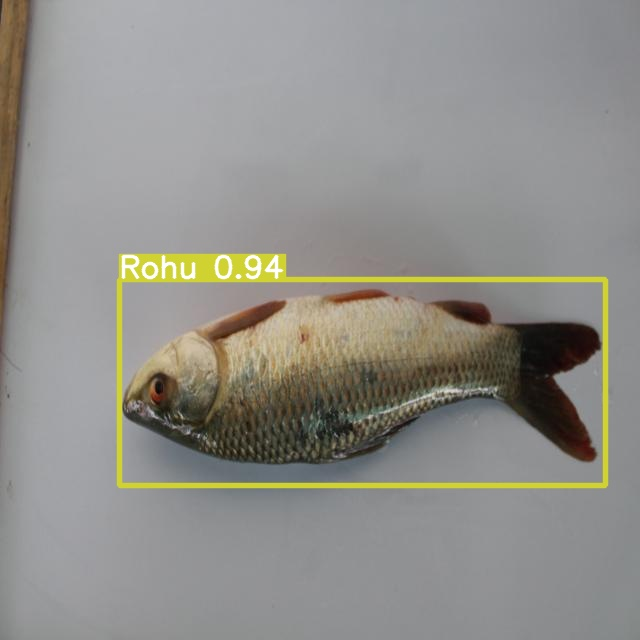

/content/yolov5/runs/detect/exp/006--124-_JPG.rf.724ad0b5909ce1e3dfbc44f00518b6ba.jpg 



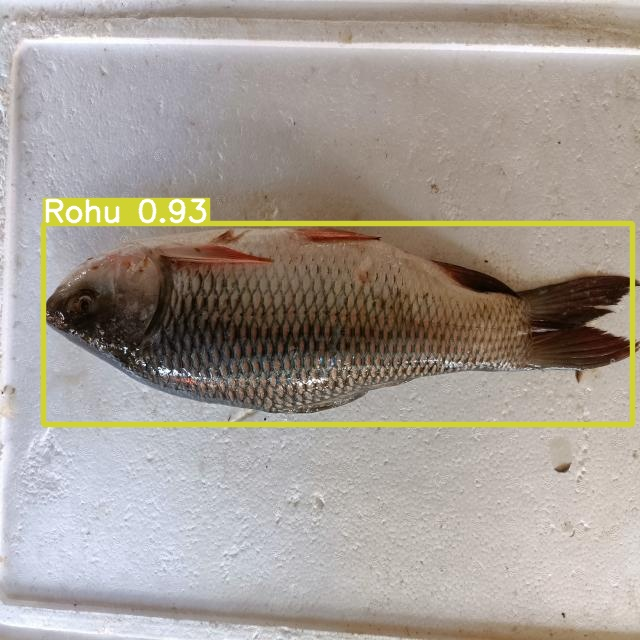

/content/yolov5/runs/detect/exp/006--34-_jpg.rf.c654f61f9b517082b7e27d2c0c75e6d2.jpg 

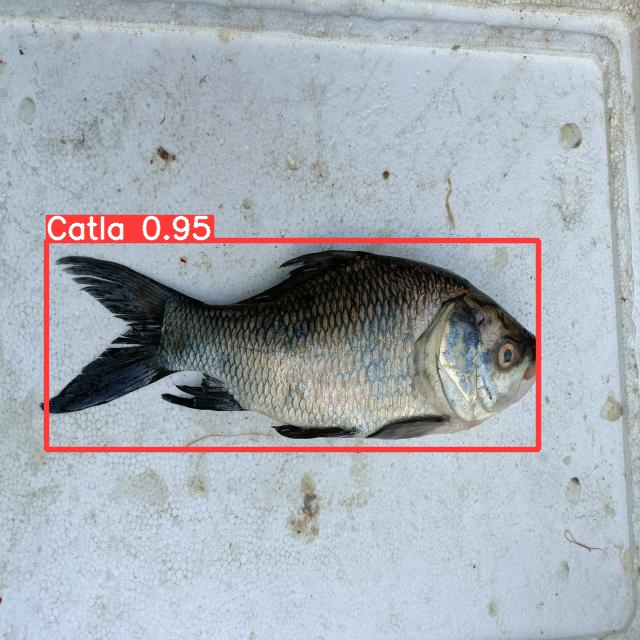

/content/yolov5/runs/detect/exp/001--11-_jpg.rf.24e5e5bd1e7457f1615dc7e7208c9e0e.jpg 

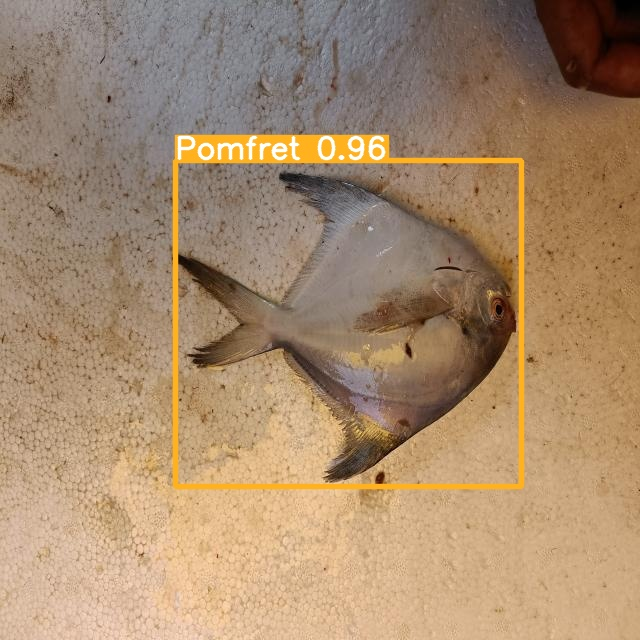

/content/yolov5/runs/detect/exp/005--79-_jpg.rf.9ff3a14026d4ce96c7a36b29524818af.jpg 

In [ ]:
import glob
from IPython.display import Image, display
i = 0
for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    i += 1
    display(Image(filename=imageName, width = 300))
    print(imageName, end = " ")
    if i%4 == 0:
      print("\n")